In [1]:
import os
import sys
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import pickle
sys.path.insert(0, "C:/workspace/data-science//libs")
from simulation_core import Simulation

pd.set_option('display.max_columns', None)

86400 24 3600


The only plot function  left here, all other plotting functions related to the simulations are placed in the ```Simulation``` class of the ```simulation_core.py```

In [2]:
def plot_mints(mitigated_mints: pd.DataFrame, pure_mints: pd.DataFrame, pool_name: str, width: int=10, height: int=10):
    """plot red line of original mints and blue dots of mitigated ones

    Args:
        mitigated_mints (pd.DataFrame): dataset of mitigated mints
        pure_mints (pd.DataFrame): pure dataset of mints without mitigation
        width (int, optional): width. Defaults to 10.
        height (int, optional): height. Defaults to 10.
    """
    fig, ax = plt.subplots(figsize=(width, height))
    ax2 = ax.twinx()

    ax.plot(pd.to_datetime(pure_mints.timestamp, unit='s'), pure_mints.Y_amount, c='red', label='mitigation off')
    ax2.plot_date(pd.to_datetime(mitigated_mints.timestamp, unit='s'), mitigated_mints.Y_amount, linestyle='--', c='blue', label='mitigation on')

    ax.set_title(f'Scatter-plot of the mints for {pool_name} pool')
    plt.legend()
    ax.set_xlabel('time')
    ax.set_ylabel('Y token amount')
    ax2.set_ylabel('Y token mitigated amount')
    fig.autofmt_xdate(rotation=25)
    ax.grid(True, linestyle='--')

    plt.show()

Setting up the simulations parameters, with identifying their paths

**cell below is executed ONLY ONCE BECAUSE OF FOUND MINTS TABLE ERROR**

In some unique cases pools set pairs in unexpected order of tokens, meaning that all mints and burns will differ from expected format and therefore it is required to set them back into expected order. Unexpected order can be found if during simulations most of the transactions are blocked by ```NOT_ENOUGH_RESERVES``` status.

In [3]:
# mints_df = pd.read_pickle(f'{os.getcwd()}\data\pair_history\PERL_WETH\perl_weth_mints.pkl')
# perl_series = mints_df.amount1.copy()   # copy placed, because otherwise reference is placed
# weth_series = mints_df.amount0.copy()
# mints_df.amount0 = perl_series
# mints_df.amount1 = weth_series
# mints_df.to_pickle(f'{os.getcwd()}\data\pair_history\PERL_WETH\perl_weth_mints.pkl')

Each pool has its simulation parameters required to be set up in order to perform correct reading of the pickle files and where to save all simulation results.

In [4]:
# Meme token pools
doge_weth_sim = Simulation(experiment_id = 21, x_name = 'DOGE', y_name = 'WETH', window_size = 24, 
                           base_dir = fr"{os.getcwd()}\data\real_transactions\experiment_")
elon_weth_sim = Simulation(experiment_id = 22, x_name = 'ELON', y_name = 'WETH', window_size = 24, 
                           base_dir = fr"{os.getcwd()}\data\real_transactions\experiment_")
shib_weth_sim = Simulation(experiment_id = 23, x_name = 'SHIB', y_name = 'WETH', window_size = 24, 
                           base_dir = fr"{os.getcwd()}\data\real_transactions\experiment_")
squid_weth_sim = Simulation(experiment_id = 24, x_name = 'SQUID', y_name = 'WETH', window_size = 24, 
                           base_dir = fr"{os.getcwd()}\data\real_transactions\experiment_")

**IMPORTANT: launch those simulations only if there is no data in package ```data\real_transactions```, otherwise skip this part (comment it)**

In [5]:
# # meme token pools
# doge_weth_sim.run_simulation(isBurnAvailable = True, isMintAvailable = True)    # passed, experiment 21
# elon_weth_sim.run_simulation(isBurnAvailable = True, isMintAvailable = True)    # passed, experiment 22
# shib_weth_sim.run_simulation(isBurnAvailable = True, isMintAvailable = True)    # passed, experiment 23
# squid_weth_sim.run_simulation(isBurnAvailable = False, isMintAvailable = True)  # passed, experiment 24

## Meme-tokens pools (DOGE/WETH, SHIB/WETH, ELON/WETH, SQUID/WETH)

In [6]:
doge_weth_swaps_mitigation_off_df, doge_weth_mints_mitigation_off_df, doge_weth_burns_mitigation_off_df = doge_weth_sim.read_simulation(0)
doge_weth_swaps_mitigation_on_df, doge_weth_mints_mitigation_on_df, doge_weth_burns_mitigation_on_df = doge_weth_sim.read_simulation(1)

shib_weth_swaps_mitigation_off_df, shib_weth_mints_mitigation_off_df, shib_weth_burns_mitigation_off_df = shib_weth_sim.read_simulation(0)
shib_weth_swaps_mitigation_on_df, shib_weth_mints_mitigation_on_df, shib_weth_burns_mitigation_on_df = shib_weth_sim.read_simulation(1)

elon_weth_swaps_mitigation_off_df, elon_weth_mints_mitigation_off_df, elon_weth_burns_mitigation_off_df = elon_weth_sim.read_simulation(0)
elon_weth_swaps_mitigation_on_df, elon_weth_mints_mitigation_on_df, elon_weth_burns_mitigation_on_df = elon_weth_sim.read_simulation(1)

squid_weth_swaps_mitigation_off_df, squid_weth_mints_mitigation_off_df, squid_weth_burns_mitigation_off_df = squid_weth_sim.read_simulation(0)
squid_weth_swaps_mitigation_on_df, squid_weth_mints_mitigation_on_df, squid_weth_burns_mitigation_on_df = squid_weth_sim.read_simulation(1)

In [7]:
doge_weth_swaps_df = doge_weth_sim.get_original_swaps_df()
shib_weth_swaps_df = shib_weth_sim.get_original_swaps_df()
elon_weth_swaps_df = elon_weth_sim.get_original_swaps_df()
squid_weth_swaps_df = squid_weth_sim.get_original_swaps_df()

In [8]:
meme_pools_list = [doge_weth_swaps_df, shib_weth_swaps_df, elon_weth_swaps_df,
                   squid_weth_swaps_df]
meme_pools_swaps_df = pd.concat(meme_pools_list)
with open('meme_pools_mevs', 'rb') as f: mevs_transactions_list = pickle.load(f)

mevs_df = pd.read_pickle('meme_pools_mevs_with_gas_df.pkl')
mevs_df['txd'] = mevs_transactions_list
mevs_df = pd.merge(mevs_df, meme_pools_swaps_df, on='txd', how='left')

mevs_df

,txd,block,block_position,gas_usage_by_tx,ether_price,tx_fee,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,gas_price,gas_used
0,0x29f1198e83ea9535c39e3eb154e935842383d354ccf2...,11682958,187,"65,948","1,367.65",0.000000098999999999,DOGE,WETH,1.560818e+05,1.087636e+00,1438.742079,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,98999999999,250000
1,0xebf2cf1a00e3cce72bd4240382d5630e5fac0e208ec5...,11682958,153,"86,483","1,367.65",0.000000099000001072,WETH,DOGE,1.058772e+00,1.560818e+05,1400.560434,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,99000001072,350000
2,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,11742210,199,"89,668","1,330.78",0.000000062,DOGE,WETH,1.662418e+04,1.143991e-01,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,62000000000,238550
3,0xe7d1c72395a7eca4f8d56ce1870599e427fd3dd98571...,11742210,197,"73,420","1,330.78",0.000000062,DOGE,WETH,1.662694e+03,1.150318e-02,14.728355,2021-01-28 04:35:38,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,62000000000,350000
4,0xf44a8cf053b93c2b65e49544a603be700a4e34cf6e50...,11742210,189,"100,331","1,330.78",0.000000062023008256,WETH,DOGE,1.000000e-02,1.662694e+03,12.803721,2021-01-28 04:35:38,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,62023008256,450000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24478,0x2e7f0c4b904b1920a4f780596cd7c3f3051c53cd406d...,13677746,1,"131,261","4,271.96",0.000000117274970976,ELON,WETH,3.429123e+10,1.082789e+01,45456.293591,2021-11-24 14:34:31,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,117274970976,231261
24479,0xb1025f1069c6af5a3618f762306980e56bd022d26aa7...,13678409,2,"112,677","4,271.96",0.000002730906015544,WETH,ELON,2.997978e+01,9.581523e+10,126756.634235,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0x540c57a187e8405df4522b3786b774cecbf2fb5f,2730906015544,212677
24480,0xcbbee073ba8ed5ef6ca640bceaf32558f95e5a6d7a44...,13678409,0,"131,297","4,271.96",0.00000017136292588,ELON,WETH,9.416487e+10,2.997978e+01,126756.634235,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,171362925880,231297
24481,0x3e58b06968559ee1f557f38a555d9b34d8d30dbbbe0c...,13681210,0,"87,588","4,523.80",0.00000010926083694,WETH,ELON,6.781140e+01,2.035519e+11,292516.018530,2021-11-25 03:43:03,0x00000000726422a6fecb4759b44d47e48cf746aa,0x00000000726422a6fecb4759b44d47e48cf746aa,109260836940,350000


In [9]:
mevs_df['block'] = pd.to_numeric(mevs_df['block'])
mevs_df['block_position'] = pd.to_numeric(mevs_df['block_position'])
mevs_df['gas_usage_by_tx'] = pd.to_numeric(mevs_df['gas_usage_by_tx'].str.replace(',', ''))
mevs_df['ether_price'] = mevs_df['ether_price'].str.replace('$', '')
mevs_df['ether_price'] = pd.to_numeric(mevs_df['ether_price'].str.replace(',', ''))
mevs_df['tx_fee'] = pd.to_numeric(mevs_df['tx_fee'].str.replace('wei', ''))
mevs_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24483 entries, 0 to 24482
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   txd              24483 non-null  object        
 1   block            24483 non-null  int64         
 2   block_position   24483 non-null  int64         
 3   gas_usage_by_tx  24483 non-null  int64         
 4   ether_price      24483 non-null  float64       
 5   tx_fee           24483 non-null  float64       
 6   token_in         24483 non-null  object        
 7   token_out        24483 non-null  object        
 8   amount_in        24483 non-null  float64       
 9   amount_out       24483 non-null  float64       
 10  amount_usd       24483 non-null  float64       
 11  timestamp        24483 non-null  datetime64[ns]
 12  sender           24483 non-null  object        
 13  to               24483 non-null  object        
 14  gas_price        24483 non-null  objec

<ipython-input-9-529235478d35>:4: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will*not* be treated as literal strings when regex=True.
  mevs_df['ether_price'] = mevs_df['ether_price'].str.replace('$', '')


In [10]:
mevs_df = mevs_df[['txd', 'block', 'block_position', 'gas_usage_by_tx', 'ether_price', 'tx_fee']]

# DOGE/WETH

In [11]:
doge_weth_mints_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,1,1.000000e+07,75.000000,1611004489,SUCCESS,0,1611004489,1611004489,1,0.000000e+00,0.000000,0.000000e+00,0,0,False,1.000000e+07,75.000000,7.500000e+08,0,0,False
1,5,1.604497e+07,123.805938,1611009693,SUCCESS,347,1611009694,1611009693,5,9.990130e+06,75.074550,7.500045e+08,0,103959048,False,2.603510e+07,198.880488,5.177874e+09,0,103959048,False
2,6,2.050000e+07,158.181727,1611010189,SUCCESS,380,1611010189,1611010189,6,2.603510e+07,198.880488,5.177874e+09,0,103959048,False,4.653510e+07,357.062215,1.661593e+10,0,103959048,False
3,7,1.179340e+07,91.000000,1611011244,SUCCESS,451,1611011254,1611011244,7,4.653510e+07,357.062215,1.661593e+10,0,103959048,False,5.832849e+07,448.062215,2.613479e+10,0,103959048,False
4,17,2.868813e+06,20.000000,1611022747,SUCCESS,1218,1611022759,1611022747,17,6.136544e+07,426.130483,2.614968e+10,0,2320056831,False,6.423425e+07,446.130483,2.865686e+10,0,2320056831,False
5,23,2.135449e+06,14.000000,1611076700,SUCCESS,4815,1611076714,1611076700,23,6.623759e+07,432.716358,2.866209e+10,0,10115420424,False,6.837304e+07,446.716358,3.054336e+10,0,10115420424,False
6,24,3.706187e+07,242.977582,1611080625,SUCCESS,5076,1611080629,1611080625,24,6.837304e+07,446.716358,3.054336e+10,0,10115420424,False,1.054349e+08,689.693940,7.271782e+10,0,10115420424,False
7,135,5.307253e+03,0.050000,1611833061,SUCCESS,55239,1611833074,1611833061,135,8.803224e+07,829.792473,7.304849e+10,5,126387463090,False,8.803755e+07,829.842473,7.305730e+10,5,126387463090,False
8,329,1.121247e+05,1.998984,1611875250,SUCCESS,58051,1611875254,1611875250,329,6.424356e+07,1142.123577,7.337408e+10,6,129747385527,False,6.435568e+07,1144.122560,7.363079e+10,6,129747385527,False
9,869,2.298049e+03,0.119647,1611902068,SUCCESS,59839,1611902074,1611902068,869,3.782355e+07,1965.413724,7.433892e+10,6,130648816886,False,3.782585e+07,1965.533371,7.434796e+10,6,130648816886,False


In [12]:
doge_weth_burns_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,1119,6.894842e+04,2.655201,1611929704,SUCCESS,61681,1611929704,1611929704,1119,4.411730e+07,1697.468564,7.488773e+10,8,131365240111,False,4.404835e+07,1694.813363,7.465373e+10,8,131365240111,False
1,1468,3.185133e+03,0.084567,1611982883,SUCCESS,65227,1611982894,1611982883,1468,6.044784e+07,1606.891691,9.713312e+10,9,132923802486,False,6.044465e+07,1606.807123,9.712289e+10,9,132923802486,False
2,2769,2.528739e+03,0.112135,1612766707,SUCCESS,117482,1612766719,1612766707,2769,4.800389e+07,2116.659341,1.016079e+11,31,162600551780,False,4.800136e+07,2116.547206,1.015972e+11,31,162600551780,False
3,2860,3.643306e+03,0.169095,1612839098,SUCCESS,122308,1612839109,1612839098,2860,4.697829e+07,2167.933016,1.018458e+11,34,164244221818,False,4.697465e+07,2167.763921,1.018300e+11,34,164244221818,False
4,3248,1.480797e+04,0.414450,1613846161,SUCCESS,189445,1613846164,1613846161,3248,6.086067e+07,1696.841246,1.032709e+11,68,193959446539,False,6.084586e+07,1696.426796,1.032206e+11,68,193959446539,False
5,3525,3.023294e+03,0.096621,1616832989,SUCCESS,388567,1616832994,1616832989,3525,5.718301e+07,1823.484379,1.042723e+11,163,286457055544,False,5.717999e+07,1823.387758,1.042613e+11,163,286457055544,False
6,5640,1.378062e+07,1857.350311,1618952213,SUCCESS,529849,1618952224,1618952213,5640,2.868692e+07,3879.038519,1.112777e+11,281,344363875132,False,1.490631e+07,2021.688208,3.013590e+10,281,344363875132,False
7,6560,1.273397e+02,0.017883,1620125687,SUCCESS,608080,1620125689,1620125687,6560,1.491922e+07,2064.789537,3.080505e+10,419,354422418070,False,1.491910e+07,2064.771654,3.080452e+10,419,354422418070,False
8,6819,1.511696e+03,0.318917,1620195299,SUCCESS,612721,1620195304,1620195299,6819,1.231962e+07,2511.081943,3.093558e+10,431,354851445128,False,1.231811e+07,2510.763026,3.092785e+10,431,354851445128,False
9,7261,1.912582e+03,0.364567,1620423983,SUCCESS,627967,1620423994,1620423983,7261,1.288549e+07,2422.560452,3.121587e+10,471,356153715063,False,1.288357e+07,2422.195885,3.120654e+10,471,356153715063,False


In [13]:
doge_weth_swaps_mitigation_off_df

,id,token_in,token_out,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender,to,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff
0,0,WETH,DOGE,1.000000,0.0,0.000000,NaN,NOT_REACHED,NaN,NaN,NaN,NaN,NOT_ENOUGH_RESERVES,0.0,2021-01-18 21:14:49,2021-01-18 21:14:49,0xebb57fcd4f7c7c8c155d6e5a80f3212c7f2d80640bb3...,0xb89fa54d5d7bcb78e121f9fa85cb47242355c68e,0xb89fa54d5d7bcb78e121f9fa85cb47242355c68e,0,0.000000e+00,0.000000,0.000000e+00,0,0,False,0.000000e+00,0.000000,0.000000e+00,0,0,False,NaN,NaN
1,2,WETH,DOGE,0.007725,0.0,1019.594013,0.000031,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,17.0,2021-01-18 21:19:04,2021-01-18 21:18:57,0x340d7456b432dd37e467d7a6fe3d6b3843e627d14d20...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x79d774e686d5d3cc1660ea4c88a11702b637852d,2,1.000000e+07,75.000000,7.500000e+08,0,0,False,9.998980e+06,75.007694,7.500005e+08,0,0,False,0.000008,0.000205
2,3,WETH,DOGE,0.041338,0.0,5452.504166,0.000165,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,60.0,2021-01-18 21:29:49,2021-01-18 21:29:35,0x0ea8f1609f74a727484e53da819e12a27159df3fdf6d...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x72478dcaaa7fc87718505daf7cb530ae9612e53a,3,9.998980e+06,75.007694,7.500005e+08,0,0,False,9.993528e+06,75.048867,7.500029e+08,0,85982410,False,0.000008,0.001095
3,4,WETH,DOGE,0.025787,0.0,3398.267916,0.000103,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,69.0,2021-01-18 21:32:04,2021-01-18 21:31:54,0xaddc432df998f8884ca9aa2bbe325f8df121cd5c3be6...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x212919050e84572e3feb9f7d2d47d061c46fa4da,4,9.993528e+06,75.048867,7.500029e+08,0,85982410,False,9.990130e+06,75.074550,7.500045e+08,0,103959048,False,0.000008,0.000683
4,8,WETH,DOGE,0.300000,0.0,38637.686625,0.001200,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,554.0,2021-01-18 23:33:19,2021-01-18 23:33:09,0xa834c8fbd15a81a708243b8f393877846e05b1e871b6...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x25770bc4f6b79ec5625c8e61bc92360caae23754,8,5.832849e+07,448.062215,2.613479e+10,0,103959048,False,5.828986e+07,448.361015,2.613490e+10,0,1051014574,False,0.000008,0.001330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12170,12212,DOGE,WETH,3100.579942,0.0,0.167324,0.000669,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1779349.0,2021-11-23 19:12:04,2021-11-23 19:12:01,0x7a086f670f8a3ce344a58cc76a01e204816de742e422...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,12212,1.376499e+07,750.502507,1.033066e+10,2077,558373237420,False,1.376809e+07,750.334514,1.033067e+10,2077,558544909487,False,0.000054,-0.000449
12171,12213,DOGE,WETH,38241.829903,0.0,2.057607,0.008230,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1782494.0,2021-11-24 08:18:19,2021-11-24 08:18:12,0xdb47f7f45ec9f7f5a5650ead3a206b2c3d61c0de4bf6...,0xb2bbfd73971279a457514325f209eb63a0341ef2,0xb2bbfd73971279a457514325f209eb63a0341ef2,12213,1.376809e+07,750.334514,1.033067e+10,2077,558544909487,False,1.380633e+07,748.268677,1.033085e+10,2080,559410536370,False,0.000054,-0.005515
12172,12214,DOGE,WETH,100000.000000,0.0,5.327351,0.021309,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1782894.0,2021-11-24 09:58:19,2021-11-24 09:58:15,0xc3a2b979eae3d49d64d85863c9578c987f9732089aa1...,0x1111111254fb6c44bac0bed2854e76f90643097d,0x0d4a11d5eeaac28ec3f61d100daf4d40471f1852,12214,1.380633e+07,748.268677,1.033085e+10,2080,559410536370,False,1.390633e+07,742.920016,1.033129e+10,2080,559521242596,False,0.000053,-0.014288
12173,12215,DOGE,WETH,40517.171810,0.0,2.136746,0.008547,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1786322.0,2021-11-25 00:15:19,2021-11-25 00:15:15,0x5bd

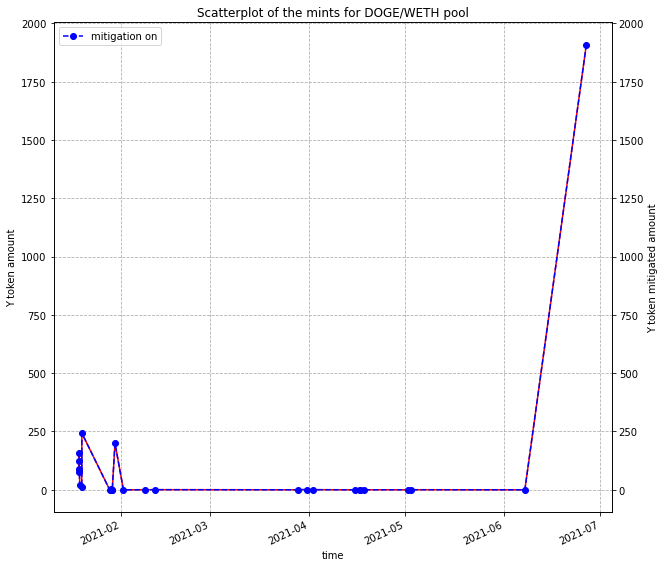

In [14]:
plot_mints(doge_weth_mints_mitigation_on_df, doge_weth_mints_mitigation_off_df, pool_name='DOGE/WETH')

## MEV transactions extraction and analysis

### MEV attacks and possible MEVs extraction

There are 136 MEV attacks performed on the pool and 8789 possible attacks

In [15]:
doge_weth_filtered_swaps_df, doge_weth_mevs_df = doge_weth_sim.extract_filtered_and_mevs_dfs()

initial len = 14343, filtered len = 13633
txds = 710
out values = 355


In [16]:
doge_weth_suspicious_filtered_swaps_df, doge_weth_possible_mevs_df = doge_weth_sim.extract_suspicious_and_filtered_swaps_dfs()

initial len = 14343, filtered len = 13345
txds = 998
out values = 499.0


In [17]:
doge_weth_mevs_df = doge_weth_sim.calculate_attack_profit(doge_weth_mevs_df)
doge_weth_mevs_df = doge_weth_sim.calculate_attack_profit_by_token(doge_weth_mevs_df)

doge_price_df = doge_weth_sim.get_daily_token_price(first_to_second=False, token_name='DOGE')
weth_usdc_sim = Simulation(experiment_id = 2, x_name = 'WETH', y_name = 'USDC', window_size = 24, 
                           base_dir = fr"{os.getcwd()}\data\real_transactions\experiment_", x_index='1', y_index='0')
weth_price_df = weth_usdc_sim.get_daily_token_price(True, 'WETH')
doge_price_df

,date,DOGE_price
0,2021-01-18,0.000008
1,2021-01-19,0.000007
2,2021-01-22,0.000007
3,2021-01-25,0.000006
4,2021-01-26,0.000006
...,...,...
362,2022-01-21,0.000056
363,2022-01-22,0.000055
364,2022-01-23,0.000056
365,2022-01-24,0.000056


In [18]:
doge_weth_mevs_df['date'] = doge_weth_mevs_df['timestamp'].dt.strftime("%Y-%m-%d")
weth_price_df['date'] = weth_price_df['date'].dt.strftime("%Y-%m-%d")
doge_price_df['date'] = doge_price_df['date'].dt.strftime("%Y-%m-%d")

doge_weth_mevs_df = pd.merge(doge_weth_mevs_df, weth_price_df, on='date', how='left')
doge_weth_mevs_df = pd.merge(doge_weth_mevs_df, doge_price_df, on='date', how='left')
doge_weth_mevs_df = pd.merge(doge_weth_mevs_df, mevs_df, on='txd', how='left')

doge_weth_mevs_df['bruto_doge_to_weth_profit'] = doge_weth_mevs_df['DOGE_profit'] * doge_weth_mevs_df['DOGE_price']
doge_weth_mevs_df['bruto_doge_to_usdc_profit'] = doge_weth_mevs_df['bruto_doge_to_weth_profit'] * doge_weth_mevs_df['WETH_price']
doge_weth_mevs_df['bruto_total_profit'] = doge_weth_mevs_df['bruto_doge_to_usdc_profit'] + (doge_weth_mevs_df['WETH_profit'] * doge_weth_mevs_df['WETH_price'])
doge_weth_mevs_df.loc[doge_weth_mevs_df['tx_fee'] == 0, 'tx_fee'] = doge_weth_mevs_df['tx_fee'].median()
doge_weth_mevs_df.loc[doge_weth_mevs_df['tx_fee'] >= 1, 'tx_fee'] = doge_weth_mevs_df['tx_fee'].median()
doge_weth_mevs_df['gas_costs_usd'] = (doge_weth_mevs_df['tx_fee'] * doge_weth_mevs_df['WETH_price'] *
                                      doge_weth_mevs_df['gas_usage_by_tx'])
doge_weth_mevs_df['netto_profit'] = doge_weth_mevs_df['bruto_total_profit'] - doge_weth_mevs_df['gas_costs_usd']
doge_weth_mevs_df.dropna(inplace=True)
doge_weth_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,DOGE_profit,WETH_profit,date,WETH_price,DOGE_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_doge_to_weth_profit,bruto_doge_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,DOGE,WETH,156081.797086,1.087636,1438.742079,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,0x29f1198e83ea9535c39e3eb154e935842383d354ccf2...,98999999999,250000,38.181645,156081.797086,1.087636,0.000000,0.028864,2021-01-19,1374.395354,0.000007,11682958.0,187.0,65948.0,1367.65,9.900000e-08,0.000000,0.000000,39.670434,8.973224,30.697210
1,WETH,DOGE,1.058772,156081.797086,1400.560434,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,0xebf2cf1a00e3cce72bd4240382d5630e5fac0e208ec5...,99000001072,350000,38.181645,156081.797086,1.058772,0.000000,0.028864,2021-01-19,1374.395354,0.000007,11682958.0,153.0,86483.0,1367.65,9.900000e-08,0.000000,0.000000,39.670434,11.767322,27.903113
2,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550,1.924634,16624.180723,0.114399,0.000000,0.001503,2021-01-28,1333.979665,0.000018,11742210.0,199.0,89668.0,1330.78,6.200000e-08,0.000000,0.000000,2.005216,7.416148,-5.410932
3,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550,1.924634,16624.180723,0.114399,0.000000,0.014399,2021-01-28,1333.979665,0.000018,11742210.0,199.0,89668.0,1330.78,6.200000e-08,0.000000,0.000000,19.208072,7.416148,11.791924
4,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550,1.924634,16624.180723,0.114399,0.000000,0.001503,2021-01-28,1333.979665,0.000018,11742210.0,199.0,89668.0,1330.78,6.200000e-08,0.000000,0.000000,2.005216,7.416148,-5.410932
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685,DOGE,WETH,48335.927844,3.640460,11012.628039,2021-09-22 21:03:41,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xd8d421b026ca13f1137004da44ce7eedbfd3f9d70269...,362603594586,126498,105.642821,48335.927844,3.640460,0.000000,0.034922,2021-09-22,3068.032248,0.000074,13277891.0,5.0,76498.0,3078.88,3.626036e-07,0.000000,0.000000,107.143356,85.102458,22.040897
686,WETH,DOGE,5.783287,84099.704745,19407.605929,2021-10-04 13:25:50,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x4f281f63bc51dbbb466d67f5b74b0fc45bdccc8c12ab...,87847269054,500066,116.591819,84099.704745,5.783287,0.000000,0.034743,2021-10-04,3393.413741,0.000071,13352834.0,2.0,86420.0,3384.50,8.784727e-08,0.000000,0.000000,117.898331,25.761986,92.136345
687,DOGE,WETH,84099.704745,5.818030,19524.197748,2021-10-04 13:25:50,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x9ab7e44d56f5ea47431ee93b41ae20d48b7053f17214...,334493365927,126498,116.591819,84099.704745,5.818030,0.000000,0.034743,2021-10-04,3393.413741,0.000071,13352834.0,4.0,76498.0,3384.50,3.344934e-07,0.000000,0.000000,117.898331,86.830920,31.067411
688,WETH,DOGE,27.208275,441041.243742,113738.998527,2021-10-28 14:52:48,0x00000000008c4fb1c916e0c88fd4cc402d935e7d,0xfcd13ea0b906f2f87229650b8d93a51b2e839ebd,0x98dd7784838e59c95ca70772b2086f526eee07bb2b21...,18000567742820,226267,168.293243,441041.243742,27.208275,47465.181115,0.000000,2021-10-28,4279.082750,0.000070,13506378.0,2.0,129291.0,4288.22,1.8000

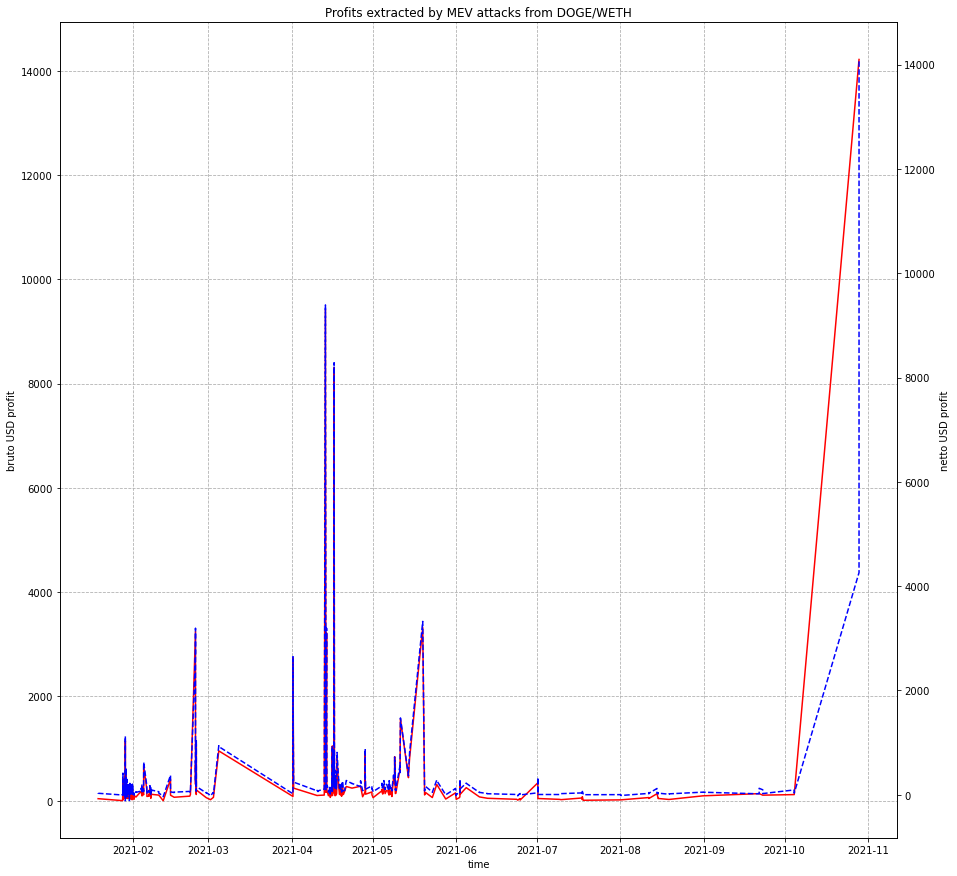

In [19]:
fig, ax = plt.subplots(figsize = (15, 15))
ax2 = ax.twinx()
ax.plot(doge_weth_mevs_df.timestamp, doge_weth_mevs_df.bruto_total_profit, label='bruto USD profit', color='r')
ax2.plot(doge_weth_mevs_df.timestamp, doge_weth_mevs_df.netto_profit, label='netto USD profit', color='b', linestyle='--')
ax.set_xlabel('time')
ax.set_ylabel('bruto USD profit')
ax2.set_ylabel('netto USD profit')
ax.set_title('Profits extracted by MEV attacks from DOGE/WETH')
ax.grid(True, linestyle = '--')
plt.show()

In [20]:
doge_weth_mevs_df[doge_weth_mevs_df['sender'] == '0x0000000000d41c96294ccdac8612bdfe29c641af']

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,DOGE_profit,WETH_profit,date,WETH_price,DOGE_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_doge_to_weth_profit,bruto_doge_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit


### Plotting values of MEVs and possible MEVs with filtered swaps values

In [21]:
doge_weth_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,DOGE_profit,WETH_profit,date,WETH_price,DOGE_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_doge_to_weth_profit,bruto_doge_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,DOGE,WETH,156081.797086,1.087636,1438.742079,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,0x29f1198e83ea9535c39e3eb154e935842383d354ccf2...,98999999999,250000,38.181645,156081.797086,1.087636,0.000000,0.028864,2021-01-19,1374.395354,0.000007,11682958.0,187.0,65948.0,1367.65,9.900000e-08,0.000000,0.000000,39.670434,8.973224,30.697210
1,WETH,DOGE,1.058772,156081.797086,1400.560434,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,0xebf2cf1a00e3cce72bd4240382d5630e5fac0e208ec5...,99000001072,350000,38.181645,156081.797086,1.058772,0.000000,0.028864,2021-01-19,1374.395354,0.000007,11682958.0,153.0,86483.0,1367.65,9.900000e-08,0.000000,0.000000,39.670434,11.767322,27.903113
2,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550,1.924634,16624.180723,0.114399,0.000000,0.001503,2021-01-28,1333.979665,0.000018,11742210.0,199.0,89668.0,1330.78,6.200000e-08,0.000000,0.000000,2.005216,7.416148,-5.410932
3,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550,1.924634,16624.180723,0.114399,0.000000,0.014399,2021-01-28,1333.979665,0.000018,11742210.0,199.0,89668.0,1330.78,6.200000e-08,0.000000,0.000000,19.208072,7.416148,11.791924
4,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550,1.924634,16624.180723,0.114399,0.000000,0.001503,2021-01-28,1333.979665,0.000018,11742210.0,199.0,89668.0,1330.78,6.200000e-08,0.000000,0.000000,2.005216,7.416148,-5.410932
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
685,DOGE,WETH,48335.927844,3.640460,11012.628039,2021-09-22 21:03:41,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xd8d421b026ca13f1137004da44ce7eedbfd3f9d70269...,362603594586,126498,105.642821,48335.927844,3.640460,0.000000,0.034922,2021-09-22,3068.032248,0.000074,13277891.0,5.0,76498.0,3078.88,3.626036e-07,0.000000,0.000000,107.143356,85.102458,22.040897
686,WETH,DOGE,5.783287,84099.704745,19407.605929,2021-10-04 13:25:50,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x4f281f63bc51dbbb466d67f5b74b0fc45bdccc8c12ab...,87847269054,500066,116.591819,84099.704745,5.783287,0.000000,0.034743,2021-10-04,3393.413741,0.000071,13352834.0,2.0,86420.0,3384.50,8.784727e-08,0.000000,0.000000,117.898331,25.761986,92.136345
687,DOGE,WETH,84099.704745,5.818030,19524.197748,2021-10-04 13:25:50,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x9ab7e44d56f5ea47431ee93b41ae20d48b7053f17214...,334493365927,126498,116.591819,84099.704745,5.818030,0.000000,0.034743,2021-10-04,3393.413741,0.000071,13352834.0,4.0,76498.0,3384.50,3.344934e-07,0.000000,0.000000,117.898331,86.830920,31.067411
688,WETH,DOGE,27.208275,441041.243742,113738.998527,2021-10-28 14:52:48,0x00000000008c4fb1c916e0c88fd4cc402d935e7d,0xfcd13ea0b906f2f87229650b8d93a51b2e839ebd,0x98dd7784838e59c95ca70772b2086f526eee07bb2b21...,18000567742820,226267,168.293243,441041.243742,27.208275,47465.181115,0.000000,2021-10-28,4279.082750,0.000070,13506378.0,2.0,129291.0,4288.22,1.8000

In [22]:
doge_weth_possible_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used
10,DOGE,WETH,156081.797086,1.087636,1438.742079,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,0x29f1198e83ea9535c39e3eb154e935842383d354ccf2...,98999999999,250000
12,WETH,DOGE,1.058772,156081.797086,1400.560434,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x72aa814b8125f94c0341812994e8574f6c395660,0xebf2cf1a00e3cce72bd4240382d5630e5fac0e208ec5...,99000001072,350000
32,WETH,DOGE,1.592920,265498.347401,2039.545460,2021-01-28 04:35:38,0x00000000cd47aa64daf64f5144b0d7885754374c,0x00000000cd47aa64daf64f5144b0d7885754374c,0x99c968684c6fbde3aaa264f98bce923a70ec3adb3ecb...,114230982615,150000
33,DOGE,WETH,265498.347401,1.832057,2345.714714,2021-01-28 04:35:38,0x00000000cd47aa64daf64f5144b0d7885754374c,0x00000000cd47aa64daf64f5144b0d7885754374c,0xc70ace8faeaef7403f4ec559823cbc11cb3a3fbf8aba...,62000000000,150000
34,DOGE,WETH,16624.180723,0.114399,146.473384,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,62000000000,238550
...,...,...,...,...,...,...,...,...,...,...,...
14169,DOGE,WETH,31857.166799,1.476839,5986.807600,2021-12-25 00:56:55,0x00000000500e2fece27a7600435d0c48d64e0c00,0x00000000500e2fece27a7600435d0c48d64e0c00,0x9bac128c5bbd4e96ea440fad7a365353093ea6b8c5e8...,106775699131,96213
14292,WETH,DOGE,2.231788,42559.624377,6386.969472,2022-01-21 04:59:59,0x7cf09d7a9a74f746edcb06949b9d64bcd9d1604f,0x7cf09d7a9a74f746edcb06949b9d64bcd9d1604f,0x8650a80f903a8beb44595f4cbd05556e1a6475e0913f...,139839185870,98918
14293,DOGE,WETH,42559.624377,2.258362,6464.094805,2022-01-21 04:59:59,0x7cf09d7a9a74f746edcb06949b9d64bcd9d1604f,0x7cf09d7a9a74f746edcb06949b9d64bcd9d1604f,0xd30f2cd7f407687698f874eafb1d69e66d7b2713d63e...,139839185870,98522
14322,WETH,DOGE,3.240167,57549.985622,7871.862345,2022-01-23 17:11:05,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0x5e3a91d7a75fd384117da6e30ef46146cebc0ac56d7b...,112286438897,186215


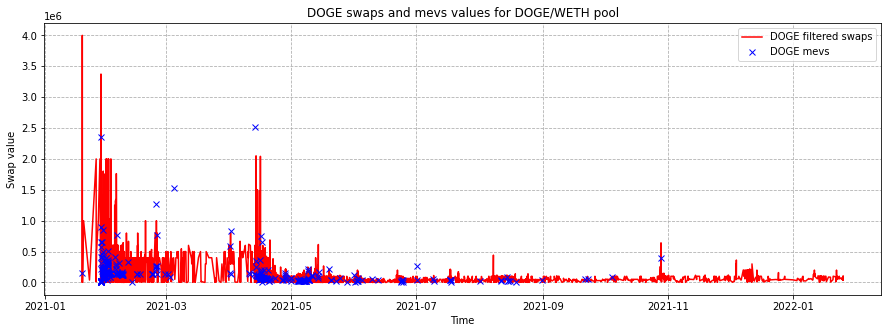

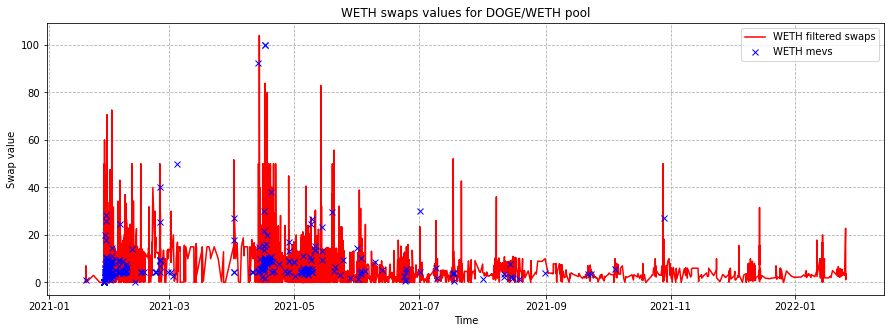

In [23]:
doge_weth_sim.show_swaps_and_mevs_by_token(doge_weth_filtered_swaps_df, doge_weth_mevs_df, width=15, height=5)

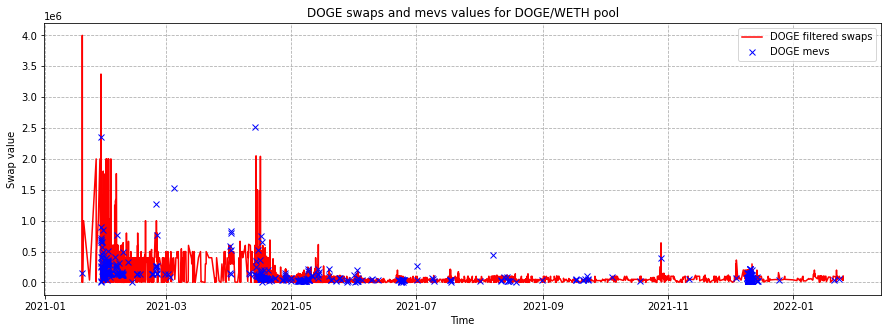

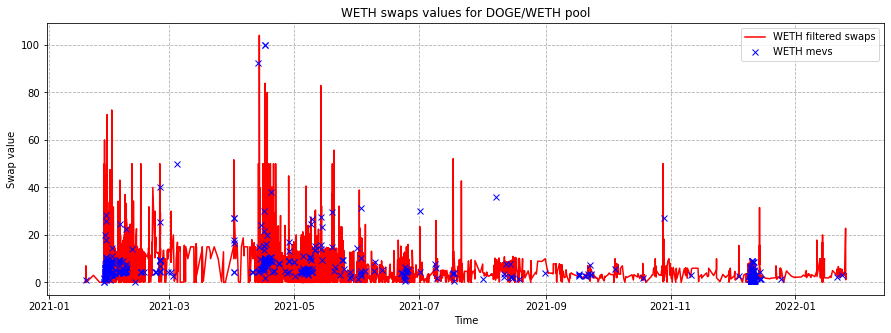

In [24]:
doge_weth_sim.show_swaps_and_mevs_by_token(doge_weth_suspicious_filtered_swaps_df, doge_weth_possible_mevs_df, width=15, height=5)

### Plotting MEV transactions and possible MEV transactions with filtered swaps daily count distributions

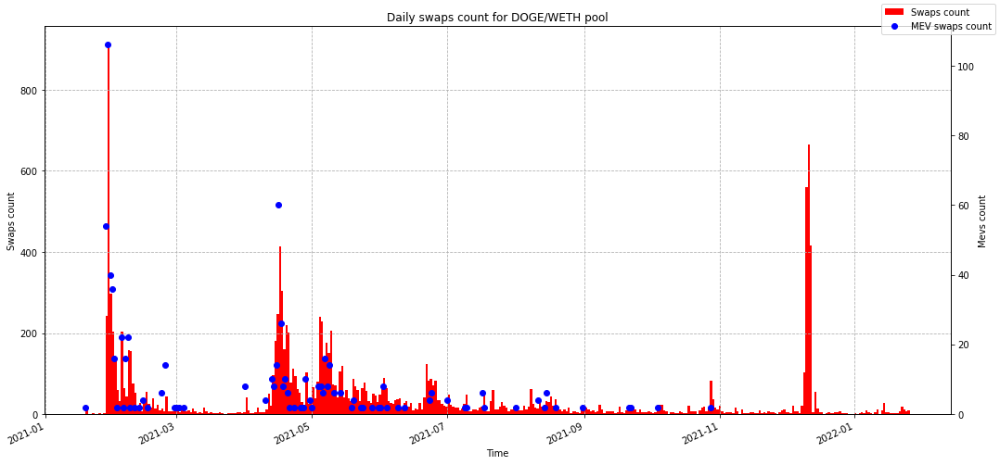

In [25]:
doge_weth_sim.show_swaps_and_mevs_daily_count_by_token(doge_weth_filtered_swaps_df, doge_weth_mevs_df, mevs_alter_axis=True)

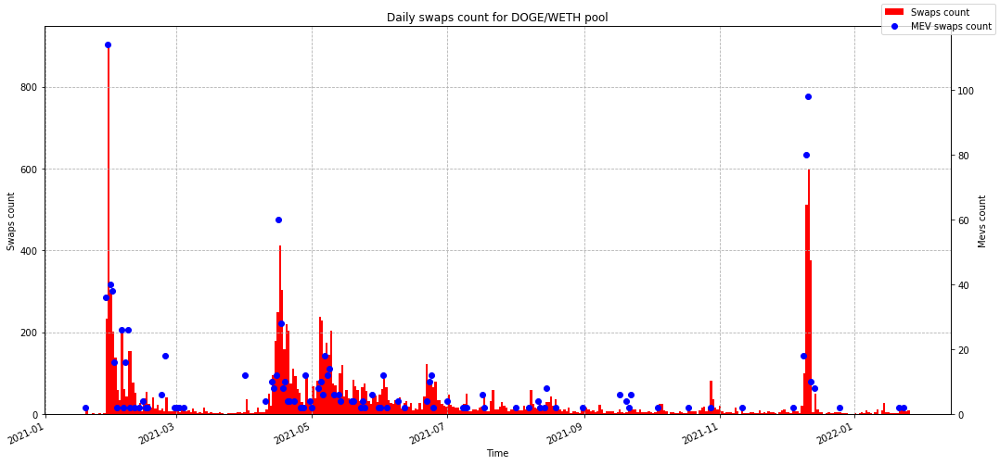

In [26]:
doge_weth_sim.show_swaps_and_mevs_daily_count_by_token(doge_weth_suspicious_filtered_swaps_df, doge_weth_possible_mevs_df, mevs_alter_axis=True)

### Plotting ratio of MEV attacks to filtered swaps

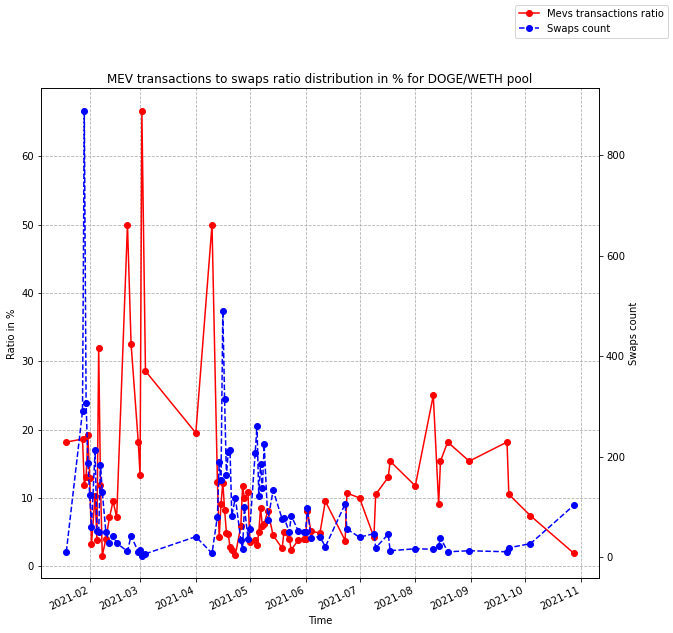

In [27]:
doge_weth_sim.show_mevs_to_swaps_ratio(doge_weth_filtered_swaps_df, doge_weth_mevs_df)

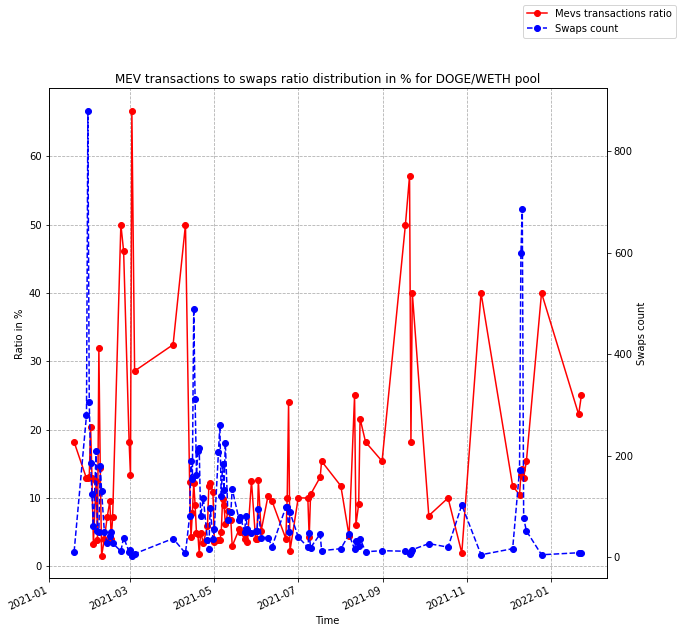

In [28]:
doge_weth_sim.show_mevs_to_swaps_ratio(doge_weth_suspicious_filtered_swaps_df, doge_weth_possible_mevs_df)

### Plotting ratio of MEVs and suspicious transactions to filtered swaps

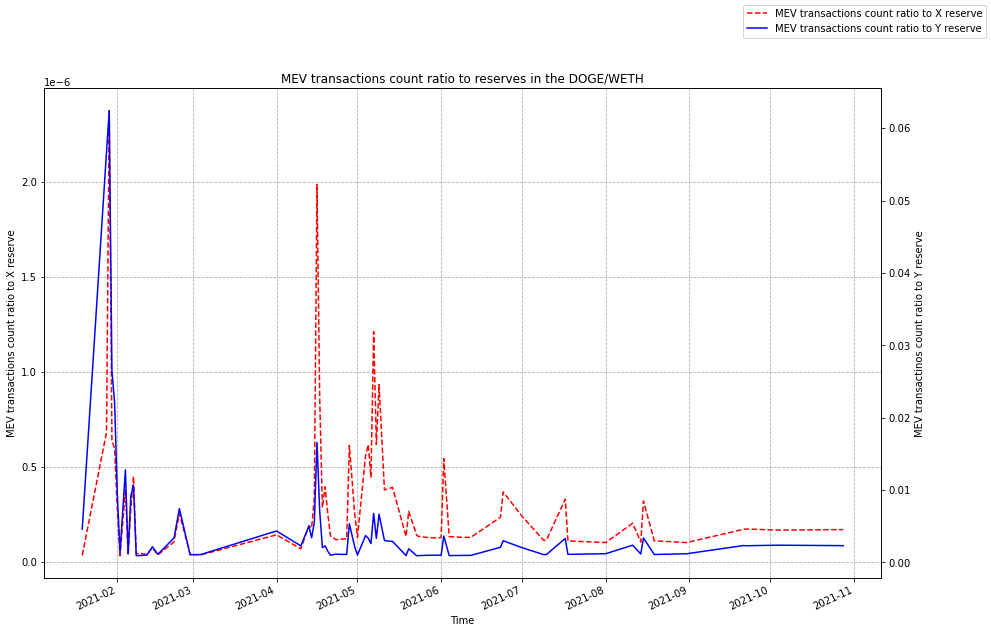

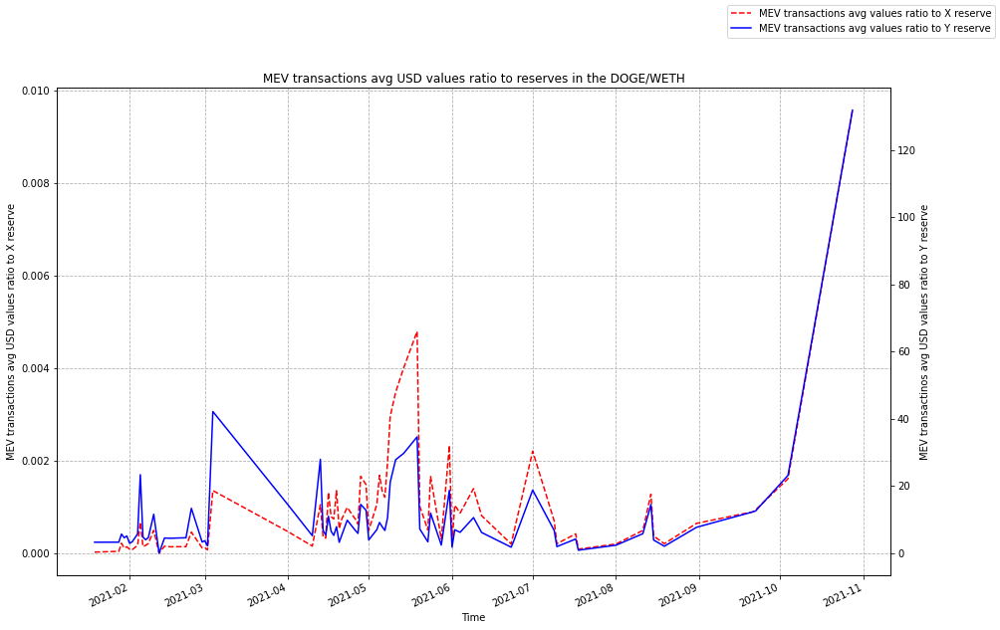

In [29]:
doge_weth_sim.show_mevs_to_reserves_ratio(doge_weth_swaps_mitigation_off_df, doge_weth_mevs_df, width=15, height=10)
doge_weth_sim.show_mevs_values_to_reserves_ratio(doge_weth_swaps_mitigation_off_df, doge_weth_mevs_df, width=15, height=10)

### Plotting transaction values distribution of passed swaps, blocked swaps and not enough reserves swaps

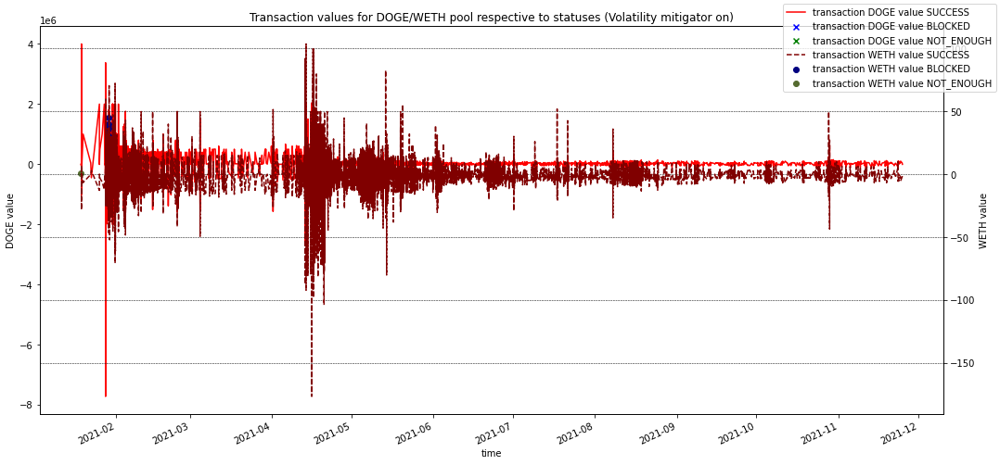

In [30]:
doge_weth_sim.plot_transactions_by_type(doge_weth_swaps_mitigation_on_df, ignore_success=False, width=15, height=7)

### Plotting mitigation comparison, slice factor distribution, reserves distributions, cumulative prices distributions, transaction frequency distributions, price impact after each transaction distributions

Original DOGE/WETH pool has next statuses counts:
SUCCESS                12174
NOT_ENOUGH_RESERVES        1
Name: status, dtype: int64
Mitigated DOGE/WETH dataframe has next statuses counts:
SUCCESS                             12154
BLOCKED_BY_VOLATILITY_MITIGATION       20
NOT_ENOUGH_RESERVES                     1
Name: status, dtype: int64
TWAP unavailability ratio for DOGE/WETH is 0.0002464065708418891
Mitigated DOGE/WETH dataframe has next Mitigator statuses:
CHECKED                12171
CANT_CONSULT_ORACLE        3
NOT_REACHED                1
Name: mitigator_check_status, dtype: int64


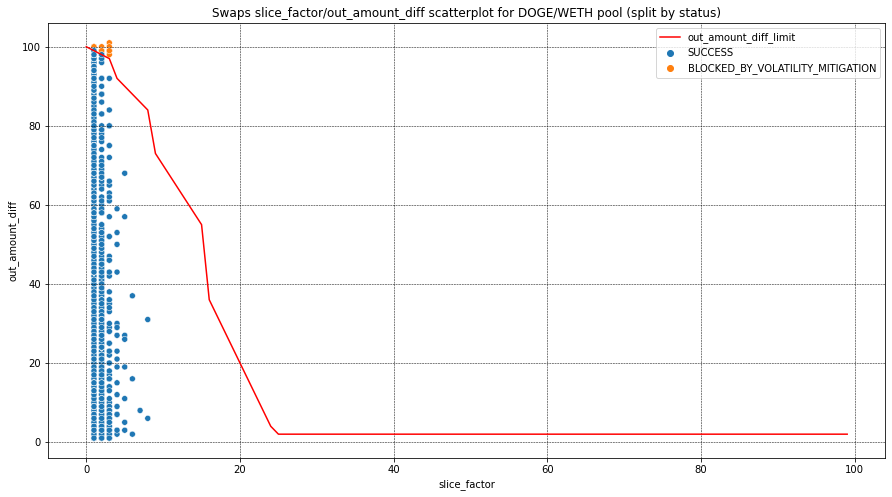

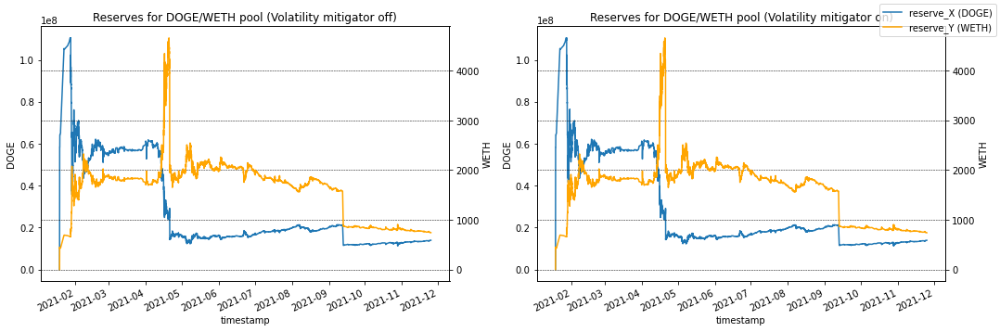

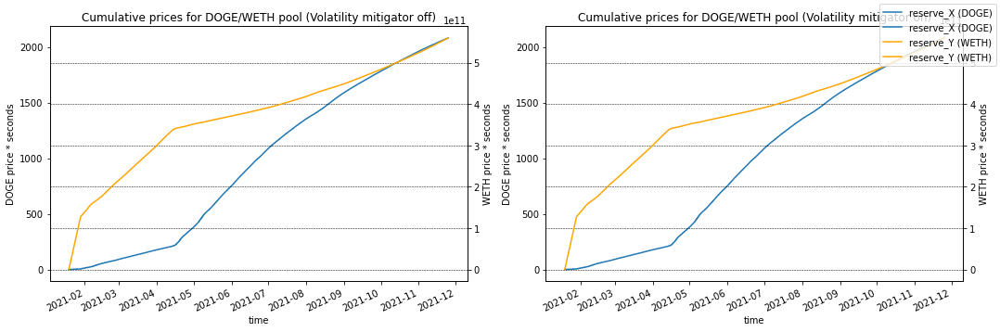

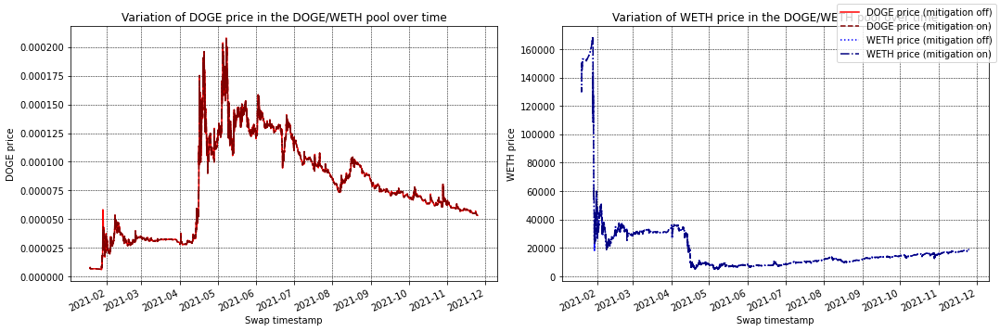

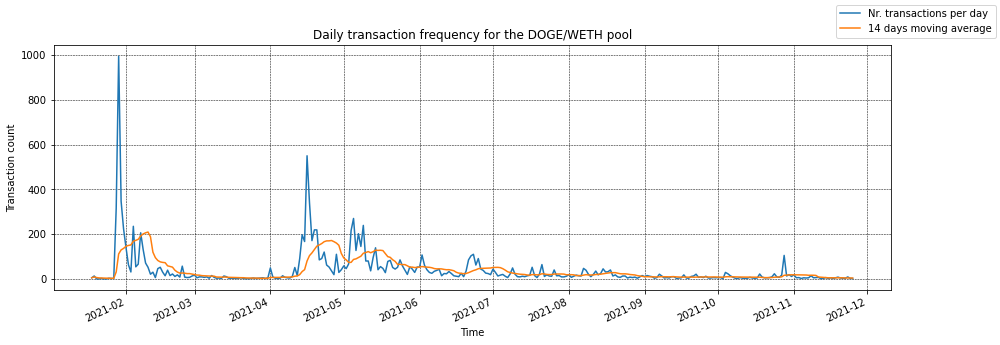

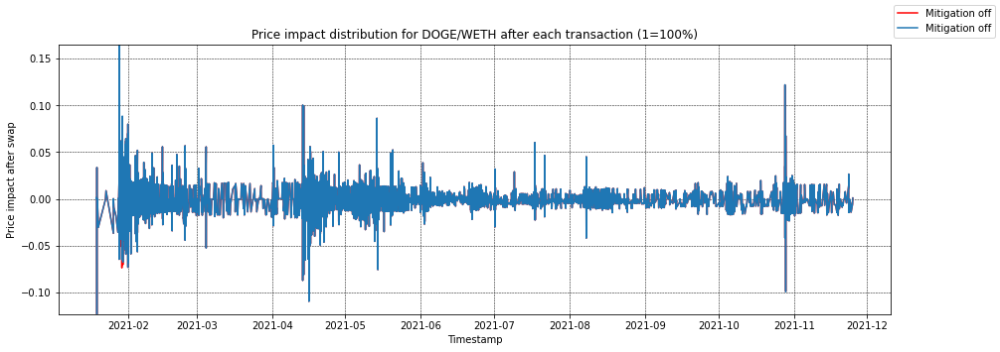

In [31]:
doge_weth_sim.show_mitigation_comparison(doge_weth_swaps_mitigation_off_df, doge_weth_swaps_mitigation_on_df)
doge_weth_sim.px_hist_blocked_transactions_slice(doge_weth_swaps_mitigation_on_df)
doge_weth_sim.px_hist_blocked_transactions_difference_from_oracle(doge_weth_swaps_mitigation_on_df)
doge_weth_sim.plot_slice_distribution_and_diff_limit_line(doge_weth_swaps_mitigation_on_df)
doge_weth_sim.plot_reserves_with_and_without_mitigation(doge_weth_swaps_mitigation_off_df, doge_weth_swaps_mitigation_on_df)
doge_weth_sim.plot_cumulative_prices_with_and_without_mitigation(doge_weth_swaps_mitigation_off_df, doge_weth_swaps_mitigation_off_df)
doge_weth_sim.plot_price_distribution(doge_weth_swaps_mitigation_off_df, doge_weth_swaps_mitigation_on_df, separate_plots=True)
doge_weth_sim.plot_frequency_distribution(doge_weth_swaps_mitigation_on_df)
doge_weth_sim.plot_price_impact(doge_weth_swaps_mitigation_off_df, doge_weth_swaps_mitigation_on_df, 
                                smallest_y=doge_weth_swaps_mitigation_off_df['price_diff'].min(), 
                                biggest_y=doge_weth_swaps_mitigation_off_df['price_diff'].max())

### MEVs blocked by mitigation mechanism

In [32]:
doge_weth_blocked_df = doge_weth_swaps_mitigation_on_df[doge_weth_swaps_mitigation_on_df['status'] == 'BLOCKED_BY_VOLATILITY_MITIGATION']
doge_weth_blocked_mevs_df = pd.merge(doge_weth_blocked_df, doge_weth_mevs_df, on='txd')
doge_weth_blocked_mevs_df

,id,token_in_x,token_out_x,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender_x,to_x,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff,token_in_y,token_out_y,amount_in,amount_out,amount_usd,timestamp,sender_y,to_y,gas_price,gas_used,profit,first_token_value,second_token_value,DOGE_profit,WETH_profit,date,WETH_price,DOGE_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_doge_to_weth_profit,bruto_doge_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,575,WETH,DOGE,5.860000,0.0,167833.576557,NaN,CHECKED,5.043045e+05,100.0,1.0,1.0,BLOCKED_BY_VOLATILITY_MITIGATION,59065.0,2021-01-29 03:21:04,2021-01-29 03:20:59,0xd1bccdc74567f115f730ef82a83505af0a484a75d7bb...,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,575,4.634493e+07,1596.175117,7.397462e+10,6,130419780916,True,4.634493e+07,1596.175117,7.397462e+10,6,130420216440,True,0.000034,0.0,WETH,DOGE,5.860000,151360.769820,7871.572430,2021-01-29 03:20:59,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,240024551449,450000,327.573567,151360.769820,5.860000,0.0,0.241933,2021-01-29,1385.521994,0.000038,11748351.0,2.0,76530.0,1379.13,2.400246e-07,0.0,0.0,335.203029,25.450763,309.752266
1,669,WETH,DOGE,17.979038,0.0,490295.252059,NaN,CHECKED,1.475817e+06,100.0,2.0,2.0,BLOCKED_BY_VOLATILITY_MITIGATION,59240.0,2021-01-29 04:04:49,2021-01-29 04:04:41,0x889fd3c568df1dd28035fd66df3bca1ee1164132661e...,0x00000000cd47aa64daf64f5144b0d7885754374c,0x00000000cd47aa64daf64f5144b0d7885754374c,669,4.540681e+07,1630.609536,7.404077e+10,6,130496775698,True,4.540681e+07,1630.609536,7.404077e+10,6,130496775698,True,0.000036,0.0,WETH,DOGE,17.979038,397085.054375,23792.176844,2021-01-29 04:04:41,0x00000000cd47aa64daf64f5144b0d7885754374c,0x00000000cd47aa64daf64f5144b0d7885754374c,3888418474043,150000,445.005683,397085.054375,17.979038,0.0,0.333021,2021-01-29,1385.521994,0.000038,11748550.0,0.0,58933.0,1379.13,3.888418e-06,0.0,0.0,461.408227,317.500908,143.907319


In [33]:
doge_weth_blocked_df = doge_weth_swaps_mitigation_on_df[doge_weth_swaps_mitigation_on_df['status'] == 'BLOCKED_BY_VOLATILITY_MITIGATION']
doge_weth_blocked_mevs_df = pd.merge(doge_weth_blocked_df, doge_weth_possible_mevs_df, on='txd')
doge_weth_blocked_mevs_df

,id,token_in_x,token_out_x,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender_x,to_x,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff,token_in_y,token_out_y,amount_in,amount_out,amount_usd,timestamp,sender_y,to_y,gas_price,gas_used
0,560,WETH,DOGE,6.360000,0.0,181660.816029,NaN,CHECKED,5.480491e+05,100.0,1.0,1.0,BLOCKED_BY_VOLATILITY_MITIGATION,59054.0,2021-01-29 03:18:19,2021-01-29 03:18:15,0xbcf1ba476b377d6840d26bfc5690f3320c28f9ed5735...,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,560,4.628226e+07,1597.856031,7.395239e+10,6,130414909614,True,4.628226e+07,1597.856031,7.395239e+10,6,130415344092,True,0.000035,0.0,WETH,DOGE,6.360000,174318.109106,8537.817314,2021-01-29 03:18:15,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,250016628761,450000
1,575,WETH,DOGE,5.860000,0.0,167833.576557,NaN,CHECKED,5.043045e+05,100.0,1.0,1.0,BLOCKED_BY_VOLATILITY_MITIGATION,59065.0,2021-01-29 03:21:04,2021-01-29 03:20:59,0xd1bccdc74567f115f730ef82a83505af0a484a75d7bb...,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,575,4.634493e+07,1596.175117,7.397462e+10,6,130419780916,True,4.634493e+07,1596.175117,7.397462e+10,6,130420216440,True,0.000034,0.0,WETH,DOGE,5.860000,151360.769820,7871.572430,2021-01-29 03:20:59,0x6f21854a903f396efdd36c2d145af973e2efe004,0x6f21854a903f396efdd36c2d145af973e2efe004,240024551449,450000
2,669,WETH,DOGE,17.979038,0.0,490295.252059,NaN,CHECKED,1.475817e+06,100.0,2.0,2.0,BLOCKED_BY_VOLATILITY_MITIGATION,59240.0,2021-01-29 04:04:49,2021-01-29 04:04:41,0x889fd3c568df1dd28035fd66df3bca1ee1164132661e...,0x00000000cd47aa64daf64f5144b0d7885754374c,0x00000000cd47aa64daf64f5144b0d7885754374c,669,4.540681e+07,1630.609536,7.404077e+10,6,130496775698,True,4.540681e+07,1630.609536,7.404077e+10,6,130496775698,True,0.000036,0.0,WETH,DOGE,17.979038,397085.054375,23792.176844,2021-01-29 04:04:41,0x00000000cd47aa64daf64f5144b0d7885754374c,0x00000000cd47aa64daf64f5144b0d7885754374c,3888418474043,150000


# SHIB/WETH

In [34]:
shib_weth_mints_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,1,4.950000e+14,1.000000e+01,1596228131,SUCCESS,0,1596228131,1596228131,1,0.000000e+00,0.000000,0.000000e+00,0,0,False,4.950000e+14,10.000000,4.950000e+15,0,0,False
1,675,2.385578e+11,4.610574e-01,1596238137,SUCCESS,668,1596238151,1596238137,675,5.222839e+13,101.405039,5.296222e+15,0,27098059017030315,False,5.246695e+13,101.866097,5.344603e+15,0,27098059017030315,False
2,1128,5.078508e+11,2.534585e+00,1596241732,SUCCESS,907,1596241736,1596241732,1128,3.282948e+13,166.898780,5.479201e+15,0,28189217412579447,False,3.333734e+13,169.433365,5.648457e+15,0,28189217412579447,False
3,1801,2.850964e+12,6.645802e+00,1596245919,SUCCESS,1186,1596245921,1596245919,1801,4.948262e+13,118.793781,5.878227e+15,0,29254302392442409,False,5.233358e+13,125.439583,6.564703e+15,0,29254302392442409,False
4,1974,1.905753e+11,3.435528e-01,1596247583,SUCCESS,1297,1596247586,1596247583,1974,5.949259e+13,111.482807,6.632401e+15,0,30139023146641175,False,5.968317e+13,111.826360,6.674151e+15,0,30139023146641175,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,787181,4.454220e+07,1.400000e-01,1623025624,SUCCESS,1786500,1623025631,1623025624,787181,2.365860e+12,7831.705981,1.852872e+16,0,87475559626628841184,False,2.365904e+12,7831.845981,1.852940e+16,0,87475559626628841184,False
1996,787238,1.000000e+08,3.148006e-01,1623026267,SUCCESS,1786543,1623026276,1623026267,787238,2.366071e+12,7831.700526,1.853036e+16,0,87475559821462561894,False,2.366171e+12,7832.015326,1.853189e+16,0,87475559821462561894,False
1997,787545,1.059140e+07,3.303798e-02,1623029005,SUCCESS,1786725,1623029006,1623029005,787545,2.368649e+12,7824.558360,1.853363e+16,0,87475560642821696118,False,2.368660e+12,7824.591398,1.853380e+16,0,87475560642821696118,False
1998,787861,2.187981e+08,6.794273e-01,1623032388,SUCCESS,1786951,1623032396,1623032388,787861,2.370739e+12,7818.519797,1.853567e+16,0,87475561674589157558,False,2.370957e+12,7819.199224,1.853899e+16,0,87475561674589157558,False


In [35]:
shib_weth_burns_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,1923,2.680203e+11,0.427597,1596246815,SUCCESS,1246,1596246821,1596246815,1923,6.380288e+13,104.393765,6.660623e+15,0,29714589234285401,False,6.353486e+13,103.966167,6.605476e+15,0,29714589234285401,False
1,3240,2.566214e+12,7.721197,1596276697,SUCCESS,3238,1596276701,1596276697,3240,5.134239e+13,154.683071,7.941798e+15,0,40664299642941981,False,4.877617e+13,146.961874,7.168238e+15,0,40664299642941981,False
2,3321,7.284586e+11,1.888833,1596281616,SUCCESS,3566,1596281621,1596281616,3321,5.243184e+13,137.050800,7.185826e+15,0,42477375234354434,False,5.170338e+13,135.161967,6.988331e+15,0,42477375234354434,False
3,3589,1.907353e+11,0.389869,1596299739,SUCCESS,4774,1596299741,1596299739,3589,5.865613e+13,121.191586,7.108629e+15,0,49314697243648553,False,5.846539e+13,120.801717,7.062720e+15,0,49314697243648553,False
4,3598,7.526120e+10,0.157526,1596300355,SUCCESS,4815,1596300356,1596300355,3598,5.784223e+13,122.132762,7.064432e+15,0,49625279535950897,False,5.776697e+13,121.975236,7.046140e+15,0,49625279535950897,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,984940,1.037841e+08,0.382732,1626162262,SUCCESS,1995609,1626162266,1626162262,984940,1.662566e+12,6129.289162,1.019035e+16,0,87476461302816202528,False,1.662463e+12,6128.906430,1.018908e+16,0,87476461302816202528,False
1996,985215,2.715608e+06,0.009903,1626177108,SUCCESS,1996599,1626177116,1626177108,985215,1.664351e+12,6122.403619,1.018983e+16,0,87476465341012653920,False,1.664348e+12,6122.393716,1.018980e+16,0,87476465341012653920,False
1997,985509,4.053543e+07,0.147503,1626187525,SUCCESS,1997293,1626187526,1626187525,985509,1.664925e+12,6121.377347,1.019163e+16,0,87476468199021916243,False,1.664884e+12,6121.229844,1.019114e+16,0,87476468199021916243,False
1998,985788,8.424326e+06,0.030611,1626197671,SUCCESS,1997970,1626197681,1626197671,985788,1.665367e+12,6119.941323,1.019195e+16,0,87476470957102182580,False,1.665359e+12,6119.910712,1.019185e+16,0,87476470957102182580,False


In [36]:
shib_weth_swaps_mitigation_off_df

,id,token_in,token_out,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender,to,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff
0,0,WETH,SHIB,4.000000e-01,0.0,0.000000e+00,NaN,NOT_REACHED,NaN,NaN,NaN,NaN,NOT_ENOUGH_RESERVES,0.0,2020-07-31 20:42:11,2020-07-31 20:42:11,0x48c0c040f75e020602b81d637e959dd4c968c4358085...,0xbf06789ee859698ed737d6c9eb404791a85f5e9e,0xbf06789ee859698ed737d6c9eb404791a85f5e9e,0,0.000000e+00,0.000000,0.000000e+00,0,0,False,0.000000e+00,0.000000,0.000000e+00,0,0,False,NaN,NaN
1,2,WETH,SHIB,4.000000e-01,0.0,1.885533e+13,0.001600,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,2.0,2020-07-31 20:42:41,2020-07-31 20:42:36,0xfd90214848d79fc1a202ed281de47bef6062e48eb109...,0xa23636dd7b1517e12088fb8c5b364c735111f979,0xa23636dd7b1517e12088fb8c5b364c735111f979,2,4.950000e+14,10.000000,4.950000e+15,0,0,False,4.761447e+14,10.398400,4.951143e+15,0,0,False,2.183874e-14,0.081018
2,3,WETH,SHIB,2.000000e+00,0.0,7.616222e+13,0.008000,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,7.0,2020-07-31 20:43:56,2020-07-31 20:43:55,0x30b7f84b294d259251d903c2ad43568aea44153ecb2d...,0x2c334d73c68bbc45dd55b13c5dea3a8f84ea053c,0x2c334d73c68bbc45dd55b13c5dea3a8f84ea053c,3,4.761447e+14,10.398400,4.951143e+15,0,0,False,3.999824e+14,12.390400,4.955943e+15,0,3434263956671109,False,3.097736e-14,0.418459
3,4,WETH,SHIB,1.000000e-01,0.0,3.170550e+12,0.000400,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,10.0,2020-07-31 20:44:41,2020-07-31 20:44:34,0x249a14b2f48cd5c2ec59507074a7ab96172efebff26a...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xc9ccd0d6311f2fe7c1d8d4c28396c700f47ce452,4,3.999824e+14,12.390400,4.955943e+15,0,3434263956671109,False,3.968119e+14,12.490000,4.956181e+15,0,4886937817632007,False,3.147587e-14,0.016093
4,5,WETH,SHIB,2.000000e-01,0.0,6.192367e+12,0.000800,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,14.0,2020-07-31 20:45:41,2020-07-31 20:45:35,0xb3158d3c80d01ca6e02f48431ec80512eaa77a81e94f...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbf168a9b110379fc8e5daa42e334a97159232e37,5,3.968119e+14,12.490000,4.956181e+15,0,4886937817632007,False,3.906195e+14,12.689200,4.956649e+15,0,6793159912517309,False,3.248481e-14,0.032054
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1219039,1223039,SHIB,WETH,1.268617e+07,0.0,1.309711e-01,0.000524,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,2774323.0,2021-11-25 12:22:56,2021-11-25 12:22:45,0xd763cebb2a8589ab9fef046ccc1dca316309ef807808...,0xe66b31678d6c16e9ebf358268a790b763c133750,0xa5e9c917b4b821e4e0a5bbefce078ab6540d6b5e,1223039,1.130320e+12,11787.337463,1.332346e+16,0,87479837414725350389,False,1.130332e+12,11787.205968,1.332346e+16,0,87479837414725350389,False,1.042809e-08,-0.000022
1219040,1223040,WETH,SHIB,2.242036e-02,0.0,2.128493e+06,0.000090,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,2774338.0,2021-11-25 12:26:41,2021-11-25 12:26:36,0x8ba92252b8795bd4ca34b0ffcbec05540cdce56ec5e0...,0xdef1c0ded9bec7f1a1670819833240f027b25eff,0xe66b31678d6c16e9ebf358268a790b763c133750,1223040,1.130332e+12,11787.205968,1.332346e+16,0,87479837414725350389,False,1.130330e+12,11787.228298,1.332346e+16,0,87479837436301691099,False,1.042813e-08,0.000004
1219041,1223041,SHIB,WETH,2.902039e+07,0.0,2.995945e-01,0.001198,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,2774350.0,2021-11-25 12:29:41,2021-11-25 12:29:36,0xe54257f8230906f641a85b84a7201a360a1a6443f0a9...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x80d972d2a62ba71814f4e08bd27f95e5d81d02a9,1223041,1.130330e+12,11787.228298,1.332346e+16,0,87479837436301691099,False,1.130359e+12,11786.927505,1.332346e+16,0,87479837453562698463,False,1.042759e-08,-0.

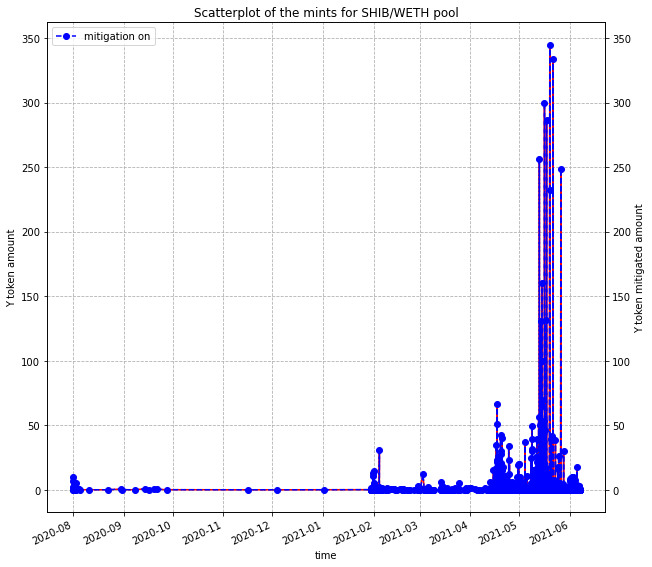

In [37]:
plot_mints(shib_weth_mints_mitigation_on_df, shib_weth_mints_mitigation_off_df, pool_name='SHIB/WETH')

## MEV transactions extraction and analysis

### MEV attacks and possible MEVs extraction

There are 136 MEV attacks performed on the pool and 8789 possible attacks

In [38]:
shib_weth_filtered_swaps_df, shib_weth_mevs_df = shib_weth_sim.extract_filtered_and_mevs_dfs()

initial len = 1250514, filtered len = 1233891
txds = 16624
out values = 8312


In [39]:
shib_weth_suspicious_filtered_swaps_df, shib_weth_possible_mevs_df = shib_weth_sim.extract_suspicious_and_filtered_swaps_dfs()

initial len = 1250514, filtered len = 1224350
txds = 26164
out values = 13082.0


In [40]:
shib_weth_mevs_df = shib_weth_sim.calculate_attack_profit(shib_weth_mevs_df)
shib_weth_mevs_df = shib_weth_sim.calculate_attack_profit_by_token(shib_weth_mevs_df)

shib_price_df = shib_weth_sim.get_daily_token_price(first_to_second=False, token_name='SHIB')
shib_price_df

,date,SHIB_price
0,2020-07-31,4.315049e-12
1,2020-08-01,2.564291e-12
2,2020-08-02,1.394975e-12
3,2020-08-03,4.103484e-13
4,2020-08-04,4.181778e-13
...,...,...
508,2022-01-23,8.848110e-09
509,2022-01-24,8.621479e-09
510,2022-01-25,8.591718e-09
511,2022-01-26,8.588864e-09


In [41]:
shib_weth_mevs_df['date'] = shib_weth_mevs_df['timestamp'].dt.strftime("%Y-%m-%d")
shib_price_df['date'] = shib_price_df['date'].dt.strftime("%Y-%m-%d")

shib_weth_mevs_df = pd.merge(shib_weth_mevs_df, weth_price_df, on='date', how='left')
shib_weth_mevs_df = pd.merge(shib_weth_mevs_df, shib_price_df, on='date', how='left')
shib_weth_mevs_df = pd.merge(shib_weth_mevs_df, mevs_df, on='txd', how='left')

shib_weth_mevs_df['bruto_shib_to_weth_profit'] = shib_weth_mevs_df['SHIB_profit'] * shib_weth_mevs_df['SHIB_price']
shib_weth_mevs_df['bruto_shib_to_usdc_profit'] = shib_weth_mevs_df['bruto_shib_to_weth_profit'] * shib_weth_mevs_df['WETH_price']
shib_weth_mevs_df['bruto_total_profit'] = shib_weth_mevs_df['bruto_shib_to_usdc_profit'] + (shib_weth_mevs_df['WETH_profit'] * shib_weth_mevs_df['WETH_price'])
shib_weth_mevs_df.loc[shib_weth_mevs_df['tx_fee'] == 0, 'tx_fee'] = shib_weth_mevs_df['tx_fee'].median()
shib_weth_mevs_df.loc[shib_weth_mevs_df['tx_fee'] >= 1, 'tx_fee'] = shib_weth_mevs_df['tx_fee'].median()
shib_weth_mevs_df['gas_costs_usd'] = (shib_weth_mevs_df['tx_fee'] * shib_weth_mevs_df['WETH_price'] *
                                      shib_weth_mevs_df['gas_usage_by_tx'])
shib_weth_mevs_df['netto_profit'] = shib_weth_mevs_df['bruto_total_profit'] - shib_weth_mevs_df['gas_costs_usd']
shib_weth_mevs_df.dropna(inplace=True)
shib_weth_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,WETH,SHIB,9.500000e-01,9.746195e+12,331.942664,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x28df6f5def17348bc2cc36306555a984cf6715d415c1...,43966277386,290372,13.028973,9.746195e+12,0.950000,0.0,0.078528,2020-07-31,347.438768,4.315049e-12,10569628.0,82.0,119914.0,346.81,4.396628e-08,0.0,0.0,27.283661,1.831757,25.451904
1,SHIB,WETH,9.746195e+12,1.028528e+00,344.971637,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0xf73f2952f7bf8d6432d7094ee6ed8c437c51f722ad16...,43000000672,225312,13.028973,9.746195e+12,1.028528,0.0,0.078528,2020-07-31,347.438768,4.315049e-12,10569628.0,93.0,85256.0,346.81,4.300000e-08,0.0,0.0,27.283661,1.273713,26.009947
2,SHIB,WETH,8.980494e+12,1.025214e+00,344.462780,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x3241df0dabe154ca35445563c3a9acaf04a4dd3fce9e...,49999999999,225312,12.536618,8.980494e+12,1.025214,0.0,0.075214,2020-07-31,347.438768,4.315049e-12,10569638.0,189.0,85256.0,346.81,5.000000e-08,0.0,0.0,26.132217,1.481062,24.651155
3,WETH,SHIB,9.500000e-01,8.980494e+12,331.926162,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x80e3107cd58ead5c1a12c5c7acfd09e2f45741a92f10...,50280143085,314404,12.536618,8.980494e+12,0.950000,0.0,0.075214,2020-07-31,347.438768,4.315049e-12,10569638.0,135.0,119914.0,346.81,5.028014e-08,0.0,0.0,26.132217,2.094810,24.037407
4,WETH,SHIB,2.850000e+00,2.272779e+13,1034.286682,2020-07-31 20:51:31,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x66926d9b7e2b52d4fbc98797e47a1a5f1e80eaaf293c...,43070088550,314404,86.971110,2.272779e+13,2.850000,0.0,0.622479,2020-07-31,347.438768,4.315049e-12,10569642.0,144.0,90282.0,346.81,4.307009e-08,0.0,0.0,216.273421,1.351000,214.922421
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19976,WETH,SHIB,1.368410e+01,1.501727e+09,57607.619146,2021-11-24 15:20:13,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xc9088c366b18616a50b497f17a9d8cf1052a55bc4534...,130904545212,500000,355.659770,1.501727e+09,13.684100,0.0,0.084483,2021-11-24,4258.707179,8.843923e-09,13677932.0,7.0,86772.0,4271.96,1.309045e-07,0.0,0.0,359.789790,48.374013,311.415778
19977,WETH,SHIB,1.280891e+01,1.401455e+09,53907.882515,2021-11-24 15:27:53,0x000000005736775feb0c8568e7dee77222a26880,0x000000005736775feb0c8568e7dee77222a26880,0x0e7e5b833557f850887f2a02c598878a19fbc592b6d4...,138835653925,500000,480.381505,1.401455e+09,12.808913,0.0,0.114142,2021-11-24,4258.707179,8.843923e-09,13677970.0,0.0,87139.0,4271.96,1.388357e-07,0.0,0.0,486.098248,51.521840,434.576409
19978,SHIB,WETH,1.401455e+09,1.292306e+01,54388.264020,2021-11-24 15:27:53,0x000000005736775feb0c8568e7dee77222a26880,0x000000005736775feb0c8568e7dee77222a26880,0xd040176e6afcec999efdde6bb6bd947e515e3bd285b0...,1305954947128,500000,480.381505,1.401455e+09,12.923055,0.0,0.114142,2021-11-24,4258.707179,8.843923e-09,13677970.0,2.0,76914.0,4271.96,1.305955e-06,0.0,0.0,486.098248,427.771033,58.327215
19979,SHIB,WETH,7.751605e+09,7.329675e+01,312576.371358,2021-11-25 00:02:01,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x73d73a79abe7cd5862d5526515efea9594481a37bf37...,131515347260,136025,1573.113260,7.751605e+09,73.296748,0.0,0.368883,2021-11-25,4521.407800,9.377805e-09,13680227.0,2.0,86025.0,4523.80,1.315153e-07,0.0,0.0,1667.870144,51.153434,1616.716710


In [42]:
shib_weth_mevs_df[shib_weth_mevs_df['netto_profit'] > 90000]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
11047,WETH,SHIB,1.496960e+02,4.815864e+10,548693.352625,2021-05-08 15:19:33,0xba42c753ebe92f78e11cc1902591a91d4a52d343,0xba42c753ebe92f78e11cc1902591a91d4a52d343,0x3550c03d03bdd584a220076951276897e880e7085cee...,0,1000000,91221.578326,4.815864e+10,149.696012,0.0,24.887319,2021-05-08,3905.796066,4.026601e-09,12394428.0,0.0,114125.0,3916.25,8.479214e-08,0.0,0.0,97204.792355,37.796008,97166.996347
11048,SHIB,WETH,4.815864e+10,1.745833e+02,639914.930951,2021-05-08 15:19:33,0xba42c753ebe92f78e11cc1902591a91d4a52d343,0xba42c753ebe92f78e11cc1902591a91d4a52d343,0xf91158f757098665bdec138120256ae692b171392654...,0,3000000,91221.578326,4.815864e+10,174.583331,0.0,24.887319,2021-05-08,3905.796066,4.026601e-09,12394428.0,2.0,113638.0,3916.25,8.479214e-08,0.0,0.0,97204.792355,37.634723,97167.157632
11749,WETH,SHIB,1.533171e+02,3.208648e+10,594315.366057,2021-05-09 02:03:45,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x6221120014d1e2ae8d4ee4337f53423416ad3de3f346...,0,300000,98538.787952,3.208648e+10,153.317122,0.0,25.420314,2021-05-09,3920.594606,3.911123e-09,12397341.0,0.0,73670.0,3927.06,8.479214e-08,0.0,0.0,99662.746971,24.490530,99638.256441
11750,SHIB,WETH,3.208648e+10,1.787374e+02,692854.154009,2021-05-09 02:03:45,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x69210a14565b1060d5df6b9eb6f8a53739639af1cb4b...,0,300000,98538.787952,3.208648e+10,178.737436,0.0,25.420314,2021-05-09,3920.594606,3.911123e-09,12397341.0,2.0,60479.0,3927.06,8.479214e-08,0.0,0.0,99662.746971,20.105372,99642.641599


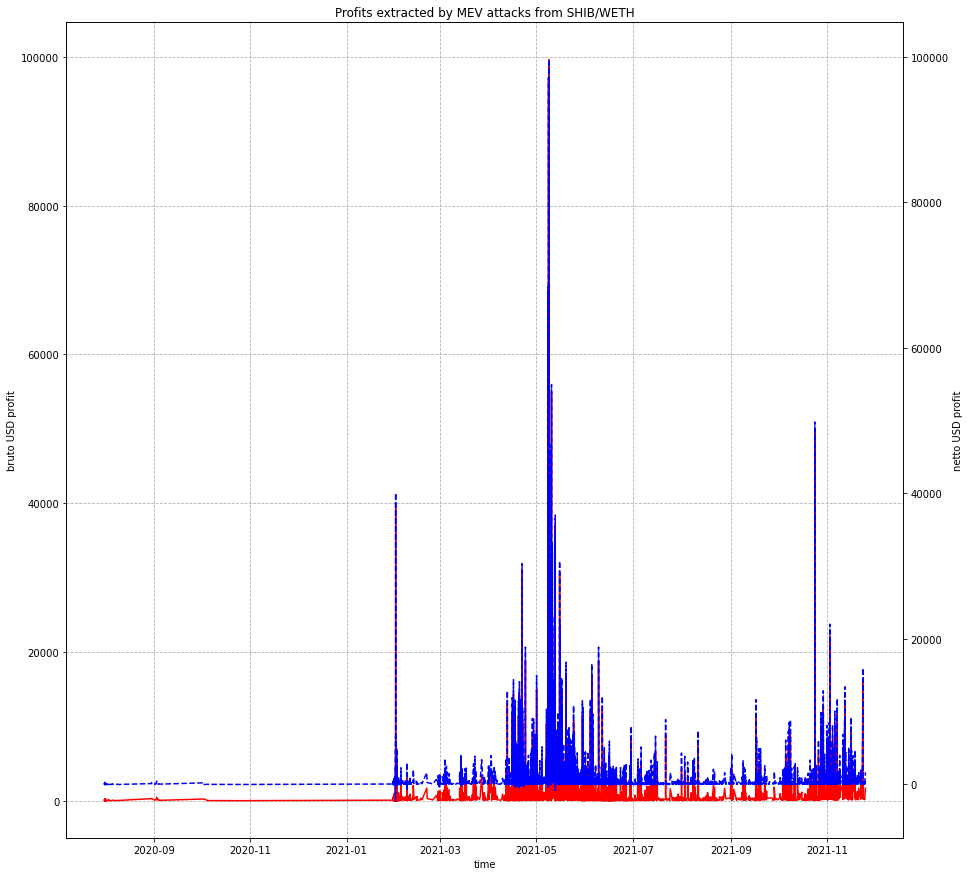

In [43]:
fig, ax = plt.subplots(figsize = (15, 15))
ax2 = ax.twinx()
ax.plot(shib_weth_mevs_df.timestamp, shib_weth_mevs_df.bruto_total_profit, label='bruto USD profit', color='r')
ax2.plot(shib_weth_mevs_df.timestamp, shib_weth_mevs_df.netto_profit, label='netto USD profit', color='b', linestyle='--')
ax.set_xlabel('time')
ax.set_ylabel('bruto USD profit')
ax2.set_ylabel('netto USD profit')
ax.set_title('Profits extracted by MEV attacks from SHIB/WETH')
ax.grid(True, linestyle = '--')
plt.show()

In [44]:
shib_weth_mevs_df[shib_weth_mevs_df['sender'] == '0x0000000000d41c96294ccdac8612bdfe29c641af']

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
17147,SHIB,WETH,2.088266e+09,7.250677e+00,13866.624501,2021-06-22 16:09:43,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0xcab31eaa00738e4212a85fbc79720c26e4486caf9378...,2896606823282,96014,275.770139,2.088266e+09,7.250677,0.0,0.144197,2021-06-22,1871.993762,3.372463e-09,12685013.0,2.0,48007.0,1880.83,2.896607e-06,0.0,0.0,269.935136,260.314592,9.620544
17148,WETH,SHIB,7.106480e+00,2.088266e+09,13590.854361,2021-06-22 16:09:43,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0xd6e886791b73fc2875210d9bff241cbcfa42991b46cd...,0,600000,275.770139,2.088266e+09,7.106480,0.0,0.144197,2021-06-22,1871.993762,3.372463e-09,12685013.0,0.0,65771.0,1880.83,8.479214e-08,0.0,0.0,269.935136,10.439854,259.495283
17151,WETH,SHIB,8.185748e+00,2.402328e+09,15572.161080,2021-06-22 16:17:02,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0x6d361531ee038eef2015c5d227a17e1960230ffb3597...,0,600000,365.816019,2.402328e+09,8.185748,0.0,0.192297,2021-06-22,1871.993762,3.372463e-09,12685047.0,0.0,55735.0,1880.83,8.479214e-08,0.0,0.0,359.978516,8.846836,351.131680
17152,SHIB,WETH,2.402328e+09,8.378045e+00,15937.977100,2021-06-22 16:17:02,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0xa158ee6116ec66c7e5629b6b81631c01a96ca77fc46c...,3906590063998,96014,365.816019,2.402328e+09,8.378045,0.0,0.192297,2021-06-22,1871.993762,3.372463e-09,12685047.0,2.0,48007.0,1880.83,3.906590e-06,0.0,0.0,359.978516,351.080579,8.897937
17153,WETH,SHIB,1.330963e+01,3.926881e+09,25380.561604,2021-06-22 16:57:13,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0x75f37fd0aad8191ddbf556e427e1af6239da2a93e43a...,0,600000,177.564729,3.926881e+09,13.309627,0.0,0.093115,2021-06-22,1871.993762,3.372463e-09,12685217.0,0.0,55735.0,1880.83,8.479214e-08,0.0,0.0,174.311391,8.846836,165.464555
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19842,WETH,SHIB,1.277817e+01,1.061860e+09,60175.294332,2021-11-11 13:44:19,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0x3363437369f962974c1126b6256027cc0633a34a94d4...,108570104882,107841,315.506235,1.061860e+09,12.778175,0.0,0.066997,2021-11-11,4729.719876,1.190985e-08,13595258.0,28.0,87777.0,4722.68,1.085701e-07,0.0,0.0,316.879374,45.074032,271.805342
19953,WETH,SHIB,5.262026e+00,5.066674e+08,22003.633261,2021-11-22 03:35:03,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0x3e1054de7227a7599472852a5e58d48c761f06725ae7...,131446034357,107829,357.296079,5.066674e+08,5.262026,0.0,0.085445,2021-11-22,4094.561580,1.047317e-08,13662140.0,0.0,87765.0,4090.46,1.314460e-07,0.0,0.0,349.859985,47.236341,302.623644
19954,SHIB,WETH,5.066674e+08,5.347471e+00,22360.929340,2021-11-22 03:35:03,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0x7375fb9bc9b2c11a966955634138a36e01a71cfe3bee...,943047600585,97349,357.296079,5.066674e+08,5.347471,0.0,0.085445,2021-11-22,4094.561580,1.047317e-08,13662140.0,2.0,77385.0,4090.46,9.430476e-07,0.0,0.0,349.859985,298.811845,51.048140
19955,WETH,SHIB,1.357897e+01,1.250620e+09,57070.770050,2021-11-22 07:23:52,0x0000000000d41c96294ccdac8612bdfe29c641af,0x0000000000d41c96294ccdac8612bdfe29c641af,0x3b4ec88fb6595713ef5e513ee9c3c1b834473cc004aa...,99283235171,107841,792.348993,1.250620e+09,13.578966,0.0,0.188525,2021-11-22,4094.561580,1.047317e-08,13663155.0,0.0,87777.0,4090.46,9.928324e-08,0.0,0.0,771.928184,35.683222,736.24496

### Plotting values of MEVs and possible MEVs with filtered swaps values

In [45]:
shib_weth_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,WETH,SHIB,9.500000e-01,9.746195e+12,331.942664,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x28df6f5def17348bc2cc36306555a984cf6715d415c1...,43966277386,290372,13.028973,9.746195e+12,0.950000,0.0,0.078528,2020-07-31,347.438768,4.315049e-12,10569628.0,82.0,119914.0,346.81,4.396628e-08,0.0,0.0,27.283661,1.831757,25.451904
1,SHIB,WETH,9.746195e+12,1.028528e+00,344.971637,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0xf73f2952f7bf8d6432d7094ee6ed8c437c51f722ad16...,43000000672,225312,13.028973,9.746195e+12,1.028528,0.0,0.078528,2020-07-31,347.438768,4.315049e-12,10569628.0,93.0,85256.0,346.81,4.300000e-08,0.0,0.0,27.283661,1.273713,26.009947
2,SHIB,WETH,8.980494e+12,1.025214e+00,344.462780,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x3241df0dabe154ca35445563c3a9acaf04a4dd3fce9e...,49999999999,225312,12.536618,8.980494e+12,1.025214,0.0,0.075214,2020-07-31,347.438768,4.315049e-12,10569638.0,189.0,85256.0,346.81,5.000000e-08,0.0,0.0,26.132217,1.481062,24.651155
3,WETH,SHIB,9.500000e-01,8.980494e+12,331.926162,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x80e3107cd58ead5c1a12c5c7acfd09e2f45741a92f10...,50280143085,314404,12.536618,8.980494e+12,0.950000,0.0,0.075214,2020-07-31,347.438768,4.315049e-12,10569638.0,135.0,119914.0,346.81,5.028014e-08,0.0,0.0,26.132217,2.094810,24.037407
4,WETH,SHIB,2.850000e+00,2.272779e+13,1034.286682,2020-07-31 20:51:31,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x66926d9b7e2b52d4fbc98797e47a1a5f1e80eaaf293c...,43070088550,314404,86.971110,2.272779e+13,2.850000,0.0,0.622479,2020-07-31,347.438768,4.315049e-12,10569642.0,144.0,90282.0,346.81,4.307009e-08,0.0,0.0,216.273421,1.351000,214.922421
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19976,WETH,SHIB,1.368410e+01,1.501727e+09,57607.619146,2021-11-24 15:20:13,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xc9088c366b18616a50b497f17a9d8cf1052a55bc4534...,130904545212,500000,355.659770,1.501727e+09,13.684100,0.0,0.084483,2021-11-24,4258.707179,8.843923e-09,13677932.0,7.0,86772.0,4271.96,1.309045e-07,0.0,0.0,359.789790,48.374013,311.415778
19977,WETH,SHIB,1.280891e+01,1.401455e+09,53907.882515,2021-11-24 15:27:53,0x000000005736775feb0c8568e7dee77222a26880,0x000000005736775feb0c8568e7dee77222a26880,0x0e7e5b833557f850887f2a02c598878a19fbc592b6d4...,138835653925,500000,480.381505,1.401455e+09,12.808913,0.0,0.114142,2021-11-24,4258.707179,8.843923e-09,13677970.0,0.0,87139.0,4271.96,1.388357e-07,0.0,0.0,486.098248,51.521840,434.576409
19978,SHIB,WETH,1.401455e+09,1.292306e+01,54388.264020,2021-11-24 15:27:53,0x000000005736775feb0c8568e7dee77222a26880,0x000000005736775feb0c8568e7dee77222a26880,0xd040176e6afcec999efdde6bb6bd947e515e3bd285b0...,1305954947128,500000,480.381505,1.401455e+09,12.923055,0.0,0.114142,2021-11-24,4258.707179,8.843923e-09,13677970.0,2.0,76914.0,4271.96,1.305955e-06,0.0,0.0,486.098248,427.771033,58.327215
19979,SHIB,WETH,7.751605e+09,7.329675e+01,312576.371358,2021-11-25 00:02:01,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x73d73a79abe7cd5862d5526515efea9594481a37bf37...,131515347260,136025,1573.113260,7.751605e+09,73.296748,0.0,0.368883,2021-11-25,4521.407800,9.377805e-09,13680227.0,2.0,86025.0,4523.80,1.315153e-07,0.0,0.0,1667.870144,51.153434,1616.716710


In [46]:
shib_weth_mevs_df[shib_weth_mevs_df.profit == shib_weth_mevs_df['profit'].max()]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
11749,WETH,SHIB,1.533171e+02,3.208648e+10,594315.366057,2021-05-09 02:03:45,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x6221120014d1e2ae8d4ee4337f53423416ad3de3f346...,0,300000,98538.787952,3.208648e+10,153.317122,0.0,25.420314,2021-05-09,3920.594606,3.911123e-09,12397341.0,0.0,73670.0,3927.06,8.479214e-08,0.0,0.0,99662.746971,24.490530,99638.256441
11750,SHIB,WETH,3.208648e+10,1.787374e+02,692854.154009,2021-05-09 02:03:45,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x69210a14565b1060d5df6b9eb6f8a53739639af1cb4b...,0,300000,98538.787952,3.208648e+10,178.737436,0.0,25.420314,2021-05-09,3920.594606,3.911123e-09,12397341.0,2.0,60479.0,3927.06,8.479214e-08,0.0,0.0,99662.746971,20.105372,99642.641599


In [47]:
shib_weth_mevs_df[shib_weth_mevs_df['sender'] == '0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e']

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
4373,WETH,SHIB,1.456454e+01,1.550082e+11,35714.350582,2021-04-15 18:09:23,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0xa0632cb165fe732fa02449a3530b93fae857e8d6a228...,0,300000,387.448928,1.550082e+11,14.564536,0.0,0.158004,2021-04-15,2515.278409,1.020132e-10,12246209.0,0.0,73670.0,2517.08,8.479214e-08,0.0,0.0,397.424294,15.712030,381.712263
4374,SHIB,WETH,1.550082e+11,1.472254e+01,36101.799510,2021-04-15 18:09:23,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0xc194fbfe40d600d8df7ab5d60977caaac0bec8f39f4a...,0,300000,387.448928,1.550082e+11,14.722540,0.0,0.158004,2021-04-15,2515.278409,1.020132e-10,12246209.0,2.0,60479.0,2517.08,8.479214e-08,0.0,0.0,397.424294,12.898709,384.525585
4385,WETH,SHIB,1.913613e+01,2.139357e+11,47676.410663,2021-04-15 20:45:26,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x9e9ba77a2cc7676122637cd6c7497502d976030cede0...,0,300000,4897.909497,2.139357e+11,19.136131,0.0,1.965900,2021-04-15,2515.278409,1.020132e-10,12246929.0,0.0,73676.0,2517.08,8.479214e-08,0.0,0.0,4944.784866,15.713310,4929.071556
4386,SHIB,WETH,2.139357e+11,2.110203e+01,52574.320160,2021-04-15 20:45:26,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0xc1a2db2475e4fb9bd1179bf5b036e3c685789fc0b531...,0,300000,4897.909497,2.139357e+11,21.102031,0.0,1.965900,2021-04-15,2515.278409,1.020132e-10,12246929.0,2.0,60479.0,2517.08,8.479214e-08,0.0,0.0,4944.784866,12.898709,4931.886157
4403,SHIB,WETH,5.192669e+10,5.666072e+00,14341.144535,2021-04-15 23:15:28,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x9df7406833f06332b55216ceb72637ff39b7e4611bd3...,0,300000,247.524710,5.192669e+10,5.666072,0.0,0.097795,2021-04-15,2515.278409,1.020132e-10,12247614.0,2.0,60473.0,2517.08,8.479214e-08,0.0,0.0,245.981738,12.897429,233.084309
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17256,WETH,SHIB,1.770087e+02,4.058749e+10,322599.961824,2021-06-25 23:45:01,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x75a58e7433d7ff2e5a37fd6f351a92d3292e7e689708...,0,300000,1863.808122,4.058749e+10,177.008681,0.0,1.001746,2021-06-25,1816.171881,3.910385e-09,12706248.0,0.0,73670.0,1810.27,8.479214e-08,0.0,0.0,1819.342778,11.344966,1807.997812
17981,WETH,SHIB,1.172521e+01,5.043050e+09,34221.449011,2021-08-07 03:22:17,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0xd41565e99461e1e35a3746a6a39611c4e26380aca3b3...,36175112746,300000,554.053977,5.043050e+09,11.725213,0.0,0.189834,2021-08-07,3160.008130,2.495975e-09,12975448.0,0.0,105411.0,3162.43,3.617511e-08,0.0,0.0,599.877548,12.049916,587.827632
17982,SHIB,WETH,5.043050e+09,1.191505e+01,34775.502988,2021-08-07 03:22:17,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0xf615fd6e2dba6b25a19df57fd6ea435ffb6829d4a1d5...,36175112746,300000,554.053977,5.043050e+09,11.915047,0.0,0.189834,2021-08-07,3160.008130,2.495975e-09,12975448.0,2.0,82816.0,3162.43,3.617511e-08,0.0,0.0,599.877548,9.466999,590.410549
17995,WETH,SHIB,2.623782e+00,1.140606e+09,8069.407487,2021-08-07 20:33:26,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x83f893cc6610bfc695f8e2d4cd0e6d3033dec77e,0x38f6156442f93c7cf5951284037f92ec13c16f91a22a...,36345306069,300000,64.344879,1.140606e+09,2.623782,0.0,0.020641,2021-08-07,3160.008130,2.495975e-09,12980139.0,5.0,105399.0,3162.43,3.634531e-08,0.0,0.0,65.225389,12.105229,53.120159


In [48]:
shib_weth_possible_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used
18,WETH,SHIB,9.500000e-01,9.746195e+12,331.942664,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x28df6f5def17348bc2cc36306555a984cf6715d415c1...,43966277386,290372
20,SHIB,WETH,9.746195e+12,1.028528e+00,344.971637,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0xf73f2952f7bf8d6432d7094ee6ed8c437c51f722ad16...,43000000672,225312
22,SHIB,WETH,8.980494e+12,1.025214e+00,344.462780,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x3241df0dabe154ca35445563c3a9acaf04a4dd3fce9e...,49999999999,225312
23,WETH,SHIB,9.500000e-01,8.980494e+12,331.926162,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x80e3107cd58ead5c1a12c5c7acfd09e2f45741a92f10...,50280143085,314404
26,WETH,SHIB,2.850000e+00,2.272779e+13,1034.286682,2020-07-31 20:51:31,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x66926d9b7e2b52d4fbc98797e47a1a5f1e80eaaf293c...,43070088550,314404
...,...,...,...,...,...,...,...,...,...,...,...
1250029,WETH,SHIB,7.482912e+00,8.566828e+08,18430.379832,2022-01-26 02:40:45,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x4b28f8a499a16542c6dee5735fe5e606828b09202393...,85260957902,2000000
1250067,WETH,SHIB,7.952549e+00,9.059319e+08,19857.408741,2022-01-26 05:05:26,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0x2a6b92f68c20785ddb613128bd062d2eb52606cfb661...,86434106438,186387
1250068,SHIB,WETH,9.059319e+08,8.114605e+00,20266.443865,2022-01-26 05:05:26,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0x4bb2165fe5cd4fec793fbde1ca283a1d6c939f374dff...,1950449212720,177742
1250345,SHIB,WETH,4.055738e+09,3.671157e+01,88552.707586,2022-01-26 22:16:34,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x00000000003b3cc22af3ae1eac0440bcee416b40,0x3eb48d6fa8cc650bfb42ce99904ae51b28f4239a4709...,2409644186474,135380


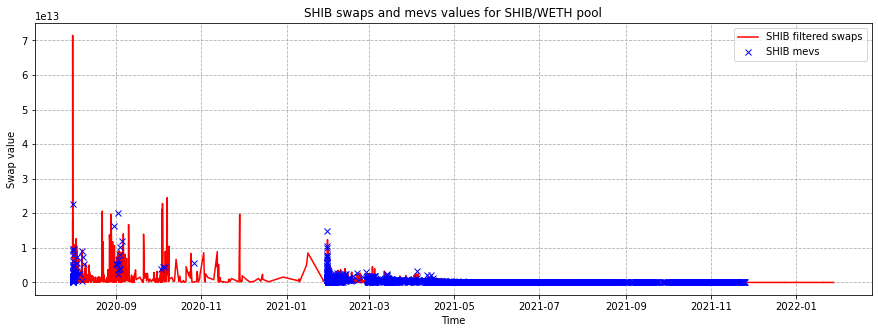

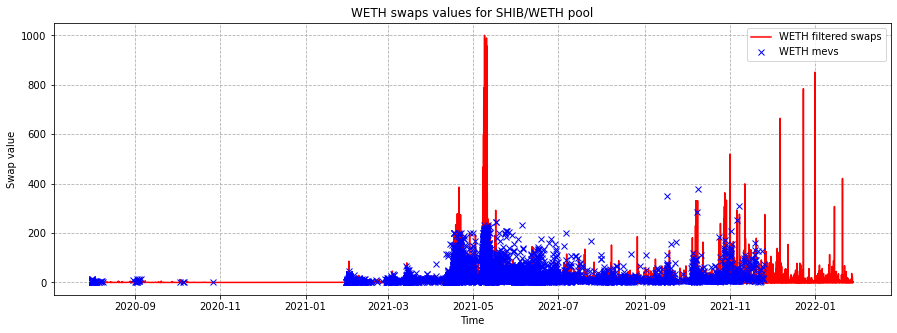

In [49]:
shib_weth_sim.show_swaps_and_mevs_by_token(shib_weth_filtered_swaps_df, shib_weth_mevs_df, width=15, height=5)

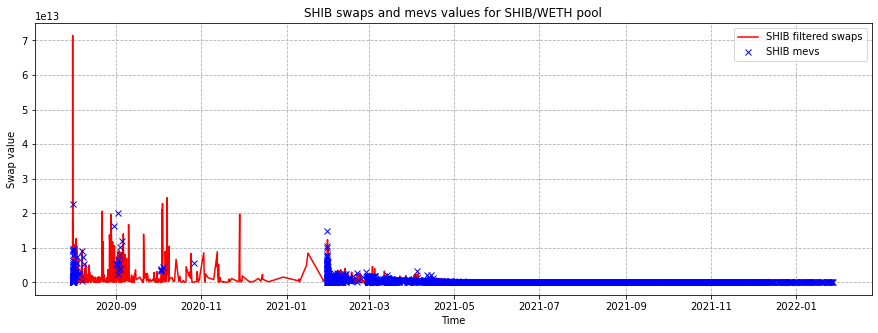

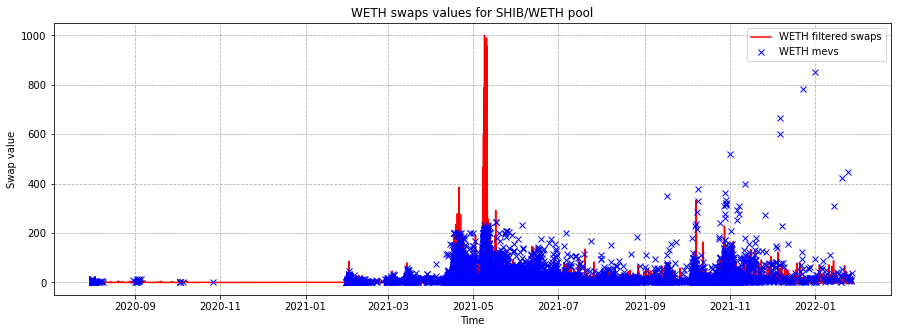

In [50]:
shib_weth_sim.show_swaps_and_mevs_by_token(shib_weth_suspicious_filtered_swaps_df, shib_weth_possible_mevs_df, width=15, height=5)

### Plotting MEV transactions and possible MEV transactions with filtered swaps daily count distributions

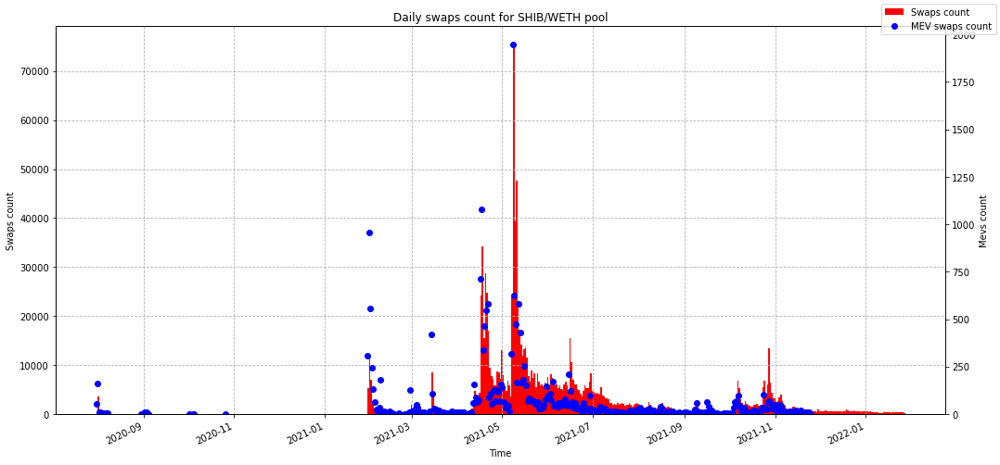

In [51]:
shib_weth_sim.show_swaps_and_mevs_daily_count_by_token(shib_weth_filtered_swaps_df, shib_weth_mevs_df, mevs_alter_axis=True)

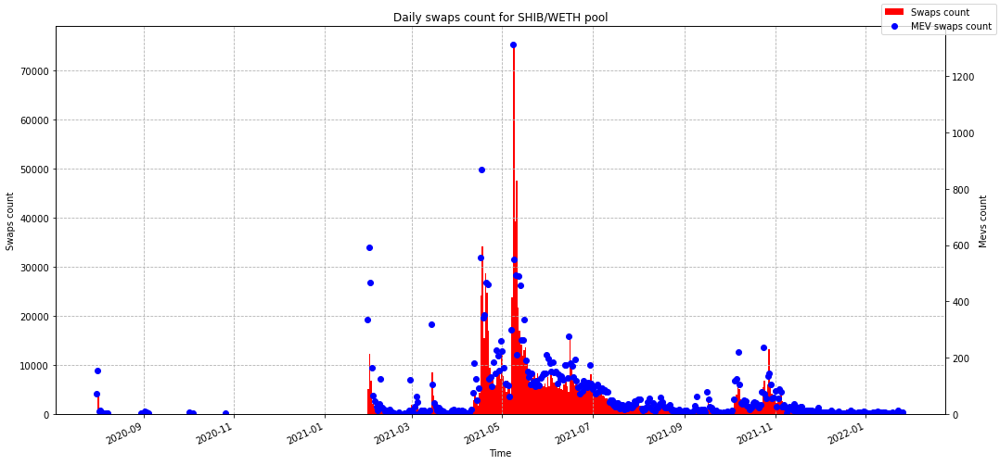

In [52]:
shib_weth_sim.show_swaps_and_mevs_daily_count_by_token(shib_weth_suspicious_filtered_swaps_df, shib_weth_possible_mevs_df, mevs_alter_axis=True)

### Plotting ratio of MEV attacks to filtered swaps

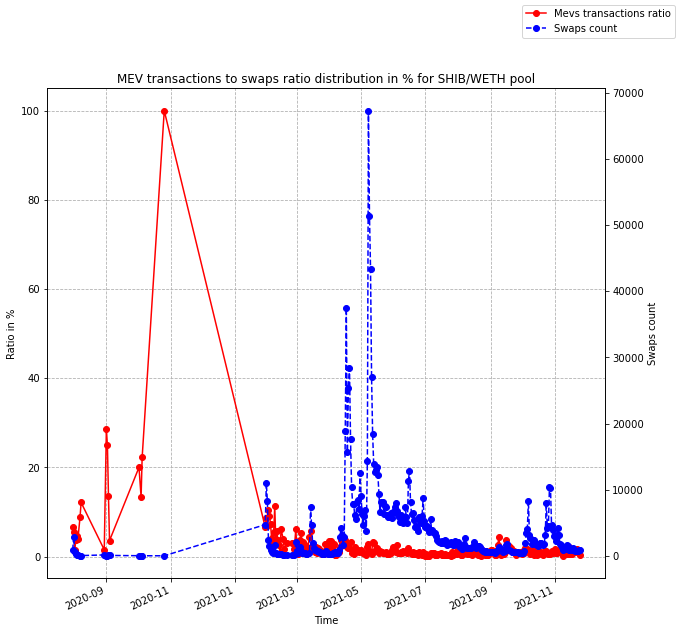

In [53]:
shib_weth_sim.show_mevs_to_swaps_ratio(shib_weth_filtered_swaps_df, shib_weth_mevs_df)

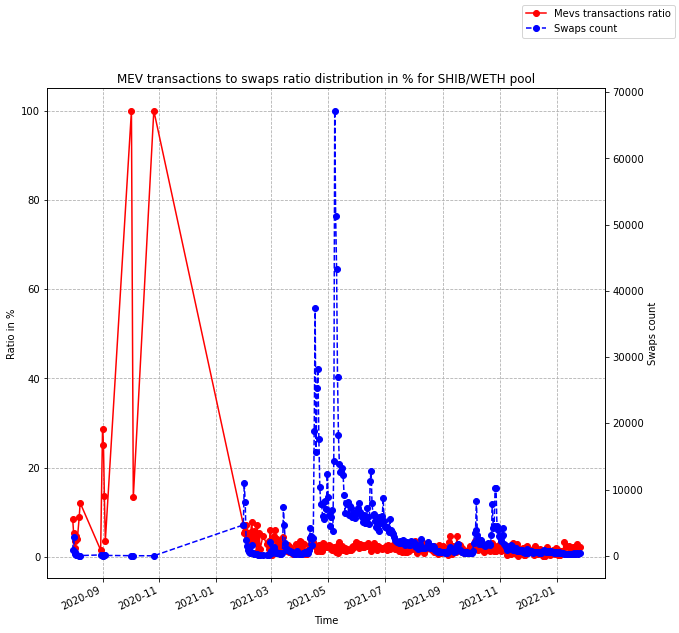

In [54]:
shib_weth_sim.show_mevs_to_swaps_ratio(shib_weth_suspicious_filtered_swaps_df, shib_weth_possible_mevs_df)

### Plotting ratio of MEVs and suspicious transactions to filtered swaps

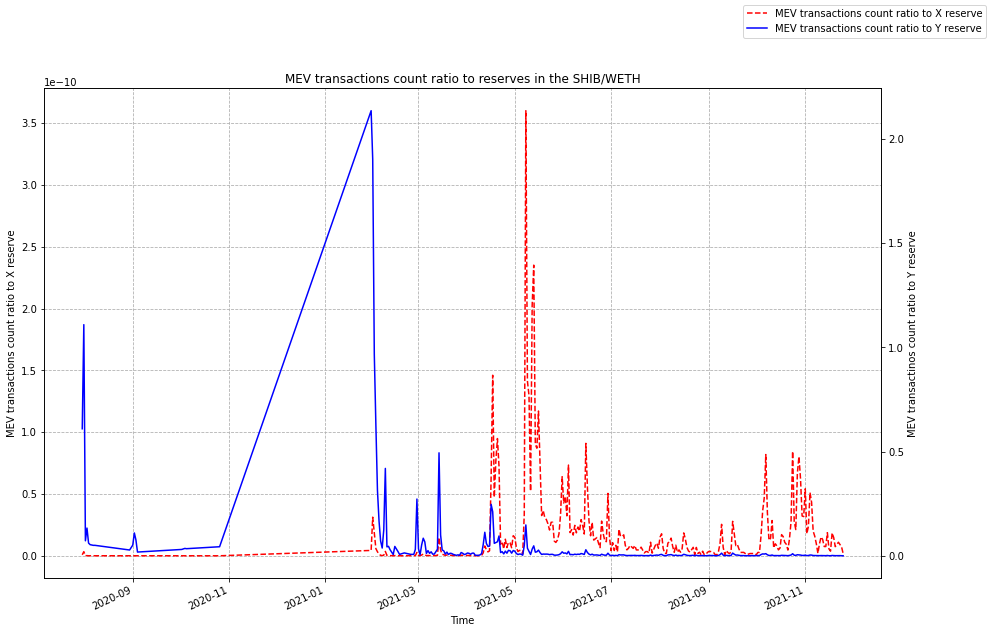

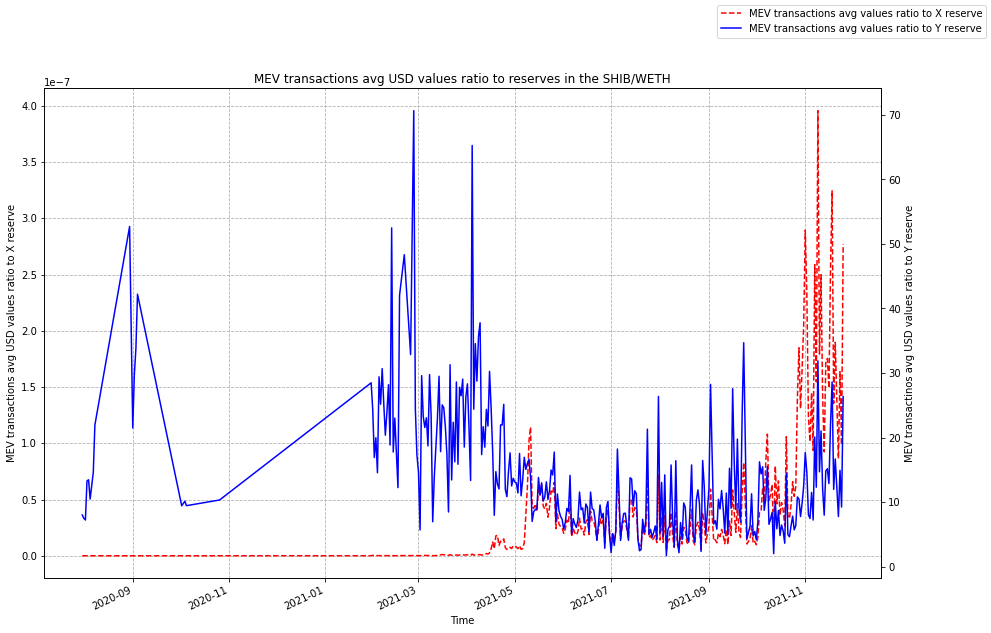

In [55]:
shib_weth_sim.show_mevs_to_reserves_ratio(shib_weth_swaps_mitigation_off_df, shib_weth_mevs_df, width=15, height=10)
shib_weth_sim.show_mevs_values_to_reserves_ratio(shib_weth_swaps_mitigation_off_df, shib_weth_mevs_df, width=15, height=10)

### Plotting transaction values distribution of passed swaps, blocked swaps and not enough reserves swaps

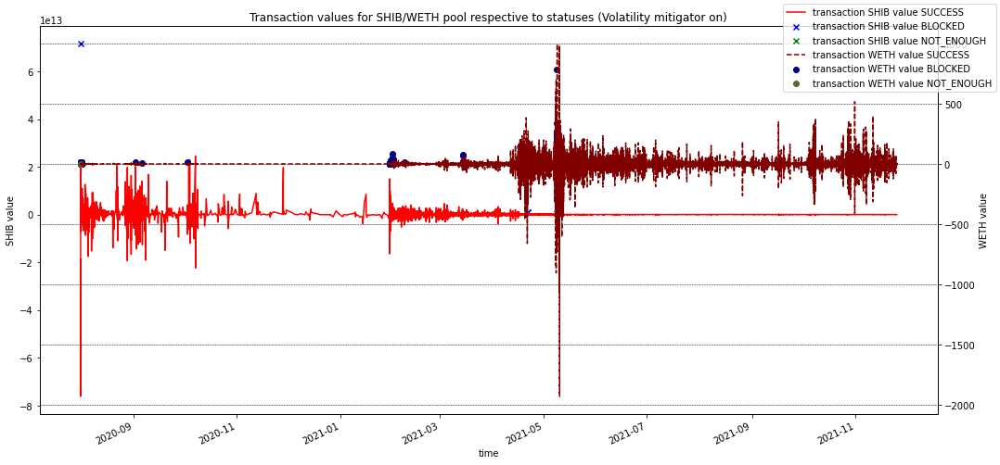

In [56]:
shib_weth_sim.plot_transactions_by_type(shib_weth_swaps_mitigation_on_df, ignore_success=False, width=15, height=7)

### Plotting mitigation comparison, slice factor distribution, reserves distributions, cumulative prices distributions, transaction frequency distributions, price impact after each transaction distributions

Original SHIB/WETH pool has next statuses counts:
SUCCESS                1219043
NOT_ENOUGH_RESERVES          1
Name: status, dtype: int64
Mitigated SHIB/WETH dataframe has next statuses counts:
SUCCESS                             1213569
BLOCKED_BY_VOLATILITY_MITIGATION       5474
NOT_ENOUGH_RESERVES                       1
Name: status, dtype: int64
TWAP unavailability ratio for SHIB/WETH is 1.0664094159029535e-05
Mitigated SHIB/WETH dataframe has next Mitigator statuses:
CHECKED                1219030
CANT_CONSULT_ORACLE         13
NOT_REACHED                  1
Name: mitigator_check_status, dtype: int64


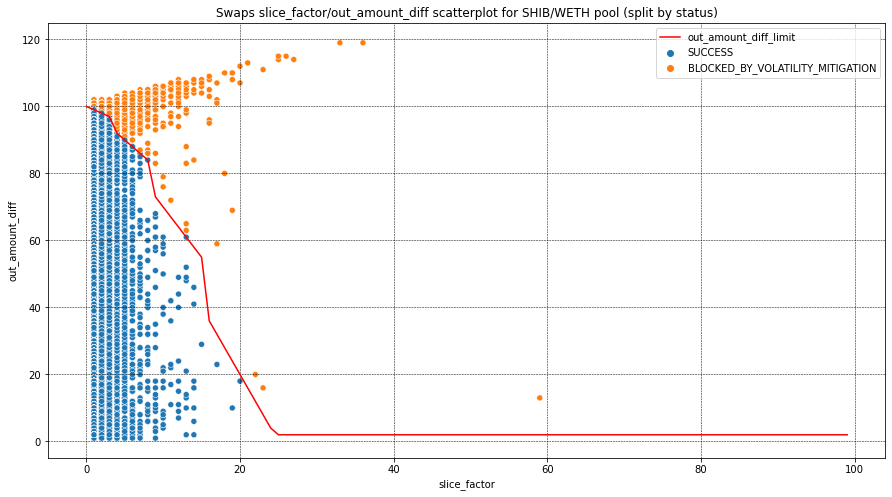

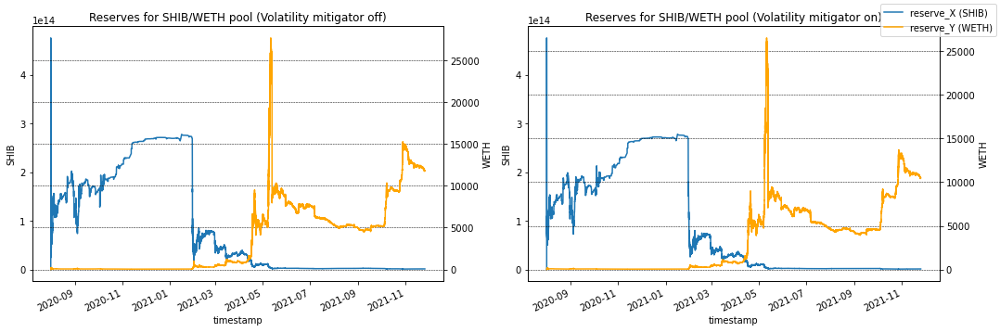

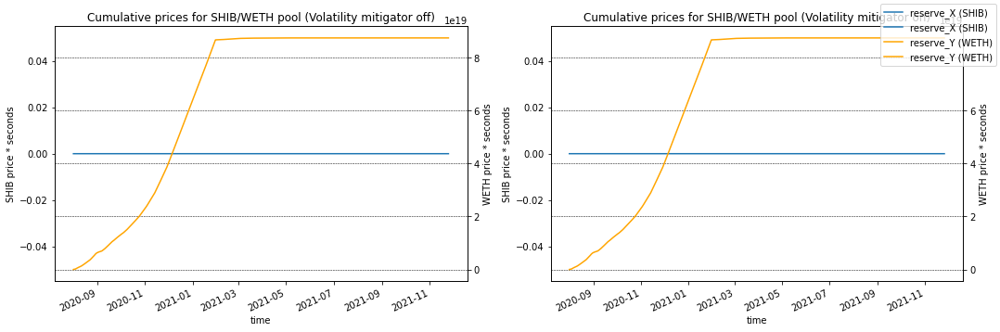

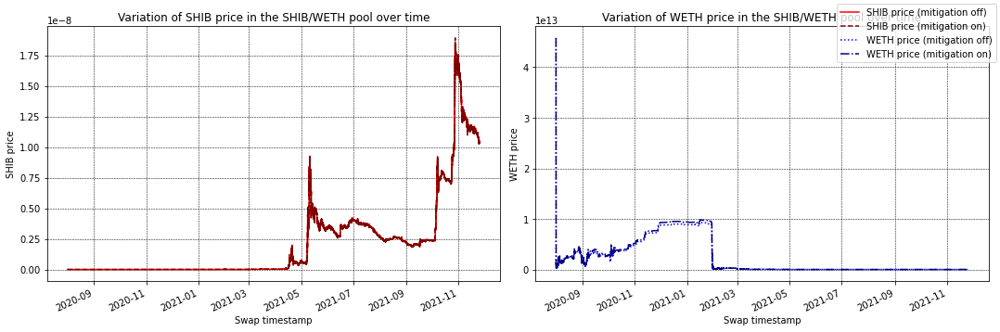

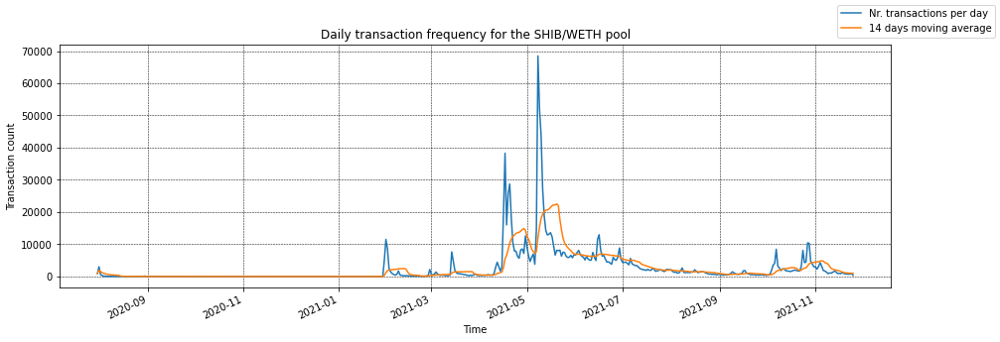

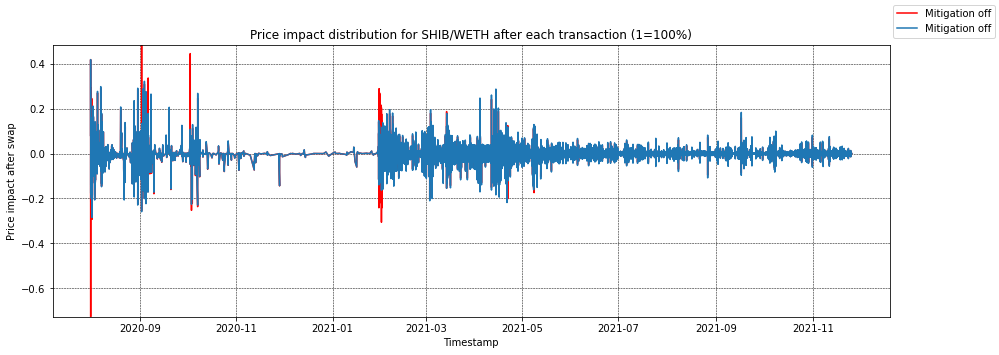

In [57]:
shib_weth_sim.show_mitigation_comparison(shib_weth_swaps_mitigation_off_df, shib_weth_swaps_mitigation_on_df)
shib_weth_sim.px_hist_blocked_transactions_slice(shib_weth_swaps_mitigation_on_df)
shib_weth_sim.px_hist_blocked_transactions_difference_from_oracle(shib_weth_swaps_mitigation_on_df)
shib_weth_sim.plot_slice_distribution_and_diff_limit_line(shib_weth_swaps_mitigation_on_df)
shib_weth_sim.plot_reserves_with_and_without_mitigation(shib_weth_swaps_mitigation_off_df, shib_weth_swaps_mitigation_on_df)
shib_weth_sim.plot_cumulative_prices_with_and_without_mitigation(shib_weth_swaps_mitigation_off_df, shib_weth_swaps_mitigation_off_df, make_big_num_convert=True)
shib_weth_sim.plot_price_distribution(shib_weth_swaps_mitigation_off_df, shib_weth_swaps_mitigation_on_df, separate_plots=True)
shib_weth_sim.plot_frequency_distribution(shib_weth_swaps_mitigation_on_df)
shib_weth_sim.plot_price_impact(shib_weth_swaps_mitigation_off_df, shib_weth_swaps_mitigation_on_df, 
                                smallest_y=shib_weth_swaps_mitigation_off_df['price_diff'].min(), 
                                biggest_y=shib_weth_swaps_mitigation_off_df['price_diff'].max())

In [58]:
shib_weth_blocked_df = shib_weth_swaps_mitigation_on_df[shib_weth_swaps_mitigation_on_df['status'] == 'BLOCKED_BY_VOLATILITY_MITIGATION']
shib_weth_blocked_mevs_df = pd.merge(shib_weth_blocked_df, shib_weth_mevs_df, on='txd')
shib_weth_blocked_mevs_df

,id,token_in_x,token_out_x,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender_x,to_x,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff,token_in_y,token_out_y,amount_in,amount_out,amount_usd,timestamp,sender_y,to_y,gas_price,gas_used,profit,first_token_value,second_token_value,SHIB_profit,WETH_profit,date,WETH_price,SHIB_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_shib_to_weth_profit,bruto_shib_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,27,WETH,SHIB,2.850000,0.0,2.560420e+13,NaN,CHECKED,6.235922e+13,83.0,13.0,39.0,BLOCKED_BY_VOLATILITY_MITIGATION,38.0,2020-07-31 20:51:41,2020-07-31 20:51:31,0x66926d9b7e2b52d4fbc98797e47a1a5f1e80eaaf293c...,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,27,2.258509e+14,22.066539,4.983748e+15,0,11815431058824946,True,2.258509e+14,22.066539,4.983748e+15,0,11815431058824946,True,9.770401e-14,0.0,WETH,SHIB,2.850000,2.272779e+13,1034.286682,2020-07-31 20:51:31,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,43070088550,314404,86.971110,2.272779e+13,2.850000,0.0,0.622479,2020-07-31,347.438768,4.315049e-12,10569642.0,144.0,90282.0,346.81,4.307009e-08,0.0,0.0,216.273421,1.351000,214.922421
1,113,WETH,SHIB,2.850000,0.0,7.802811e+12,NaN,CHECKED,2.361671e+13,100.0,7.0,14.0,BLOCKED_BY_VOLATILITY_MITIGATION,217.0,2020-07-31 21:36:26,2020-07-31 21:36:20,0x9f56e0081e0c0b49e550b2cce0b22a3ba65dbe36c0a2...,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,113,1.218756e+14,41.248769,5.027218e+15,0,26679847766455684,True,1.218756e+14,41.248769,5.027218e+15,0,26724167485054170,True,3.384498e-13,0.0,WETH,SHIB,2.850000,9.713151e+12,1019.939443,2020-07-31 21:36:20,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,73761811159,290372,63.634420,9.713151e+12,2.850000,0.0,0.410053,2020-07-31,347.438768,4.315049e-12,10569859.0,2.0,90282.0,346.81,7.376181e-08,0.0,0.0,142.468428,2.313721,140.154707
2,138,WETH,SHIB,2.000000,0.0,5.356404e+12,NaN,CHECKED,1.545383e+13,97.0,5.0,10.0,BLOCKED_BY_VOLATILITY_MITIGATION,243.0,2020-07-31 21:42:56,2020-07-31 21:42:49,0x23611399c2bfddd5d832b910307f0e6cecf1729f3a6e...,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,138,1.194714e+14,42.182722,5.039630e+15,0,27932799142940655,True,1.194714e+14,42.182722,5.039630e+15,0,27932799142940655,True,3.530779e-13,0.0,WETH,SHIB,2.000000,4.406485e+12,704.854063,2020-07-31 21:42:49,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,711531602645,800000,23.848020,4.406485e+12,2.000000,0.0,0.151457,2020-07-31,347.438768,4.315049e-12,10569889.0,0.0,98878.0,346.81,7.115316e-07,0.0,0.0,52.621981,24.443993,28.177988
3,182,WETH,SHIB,1.199044,0.0,2.552297e+12,NaN,CHECKED,7.665242e+12,100.0,3.0,3.0,BLOCKED_BY_VOLATILITY_MITIGATION,330.0,2020-07-31 22:04:41,2020-07-31 22:04:40,0x8486ccb7d16954c30f7d2b0328cbbe24e6e2b098f998...,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,182,1.055412e+14,47.899326,5.055352e+15,0,31452554922572502,True,1.055412e+14,47.899326,5.055352e+15,0,31452554922572502,True,4.538448e-13,0.0,WETH,SHIB,1.199044,1.677108e+12,417.141668,2020-07-31 22:04:40,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,249000000000,600000,24.375844,1.677108e+12,1.199044,0.0,0.092334,2020-07-31,347.438768,4.315049e-12,10569985.0,3.0,127387.0,346.81,2.490000e-07,0.0,0.0,32.080456,11.020536,21.059919
4,198,WETH,SHIB,2.000000,0.0,4.381712e+12,NaN,CHECKED,1.239862e+13

In [59]:
shib_weth_blocked_df = shib_weth_swaps_mitigation_on_df[shib_weth_swaps_mitigation_on_df['status'] == 'BLOCKED_BY_VOLATILITY_MITIGATION']
shib_weth_blocked_mevs_df = pd.merge(shib_weth_blocked_df, shib_weth_possible_mevs_df, on='txd')
shib_weth_blocked_mevs_df

,id,token_in_x,token_out_x,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender_x,to_x,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff,token_in_y,token_out_y,amount_in,amount_out,amount_usd,timestamp,sender_y,to_y,gas_price,gas_used
0,27,WETH,SHIB,2.850000,0.0,2.560420e+13,NaN,CHECKED,6.235922e+13,83.0,13.0,39.0,BLOCKED_BY_VOLATILITY_MITIGATION,38.0,2020-07-31 20:51:41,2020-07-31 20:51:31,0x66926d9b7e2b52d4fbc98797e47a1a5f1e80eaaf293c...,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,27,2.258509e+14,22.066539,4.983748e+15,0,11815431058824946,True,2.258509e+14,22.066539,4.983748e+15,0,11815431058824946,True,9.770401e-14,0.0,WETH,SHIB,2.850000,2.272779e+13,1034.286682,2020-07-31 20:51:31,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,43070088550,314404
1,111,WETH,SHIB,1.194601,0.0,3.396935e+12,NaN,CHECKED,9.928902e+12,98.0,3.0,3.0,BLOCKED_BY_VOLATILITY_MITIGATION,216.0,2020-07-31 21:36:11,2020-07-31 21:35:59,0xa6919ea6c4f7b1dcf920441ee47fc46705cd2e60bce6...,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,111,1.218756e+14,41.248769,5.027218e+15,0,26679847766455684,True,1.218756e+14,41.248769,5.027218e+15,0,26679847766455684,True,3.384498e-13,0.0,WETH,SHIB,1.194601,1.354597e+12,415.277114,2020-07-31 21:35:59,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,186309430412,800000
2,113,WETH,SHIB,2.850000,0.0,7.802811e+12,NaN,CHECKED,2.361671e+13,100.0,7.0,14.0,BLOCKED_BY_VOLATILITY_MITIGATION,217.0,2020-07-31 21:36:26,2020-07-31 21:36:20,0x9f56e0081e0c0b49e550b2cce0b22a3ba65dbe36c0a2...,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,113,1.218756e+14,41.248769,5.027218e+15,0,26679847766455684,True,1.218756e+14,41.248769,5.027218e+15,0,26724167485054170,True,3.384498e-13,0.0,WETH,SHIB,2.850000,9.713151e+12,1019.939443,2020-07-31 21:36:20,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,73761811159,290372
3,138,WETH,SHIB,2.000000,0.0,5.356404e+12,NaN,CHECKED,1.545383e+13,97.0,5.0,10.0,BLOCKED_BY_VOLATILITY_MITIGATION,243.0,2020-07-31 21:42:56,2020-07-31 21:42:49,0x23611399c2bfddd5d832b910307f0e6cecf1729f3a6e...,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,138,1.194714e+14,42.182722,5.039630e+15,0,27932799142940655,True,1.194714e+14,42.182722,5.039630e+15,0,27932799142940655,True,3.530779e-13,0.0,WETH,SHIB,2.000000,4.406485e+12,704.854063,2020-07-31 21:42:49,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,711531602645,800000
4,182,WETH,SHIB,1.199044,0.0,2.552297e+12,NaN,CHECKED,7.665242e+12,100.0,3.0,3.0,BLOCKED_BY_VOLATILITY_MITIGATION,330.0,2020-07-31 22:04:41,2020-07-31 22:04:40,0x8486ccb7d16954c30f7d2b0328cbbe24e6e2b098f998...,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,182,1.055412e+14,47.899326,5.055352e+15,0,31452554922572502,True,1.055412e+14,47.899326,5.055352e+15,0,31452554922572502,True,4.538448e-13,0.0,WETH,SHIB,1.199044,1.677108e+12,417.141668,2020-07-31 22:04:40,0x284900d5ab66356fbf936a0469ab0e138f965114,0x284900d5ab66356fbf936a0469ab0e138f965114,249000000000,600000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
468,410955,WETH,SHIB,163.145629,0.0,4.667013e+10,NaN,CHECKED,1.382871e+11,99.0,2.0,2.0,BLOCKED_BY_VOLATILITY_MITIGATION,1617548.0,2021-05-08 16:29:11,2021-05-08 16:29:07,0xa75c2

# ELON/WETH

In [60]:
elon_weth_mints_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,0,5.000000e+14,4.000000e+01,1619140199,SUCCESS,0,1619140199,1619140199,0,0.000000e+00,0.000000,0.000000e+00,0,0,False,5.000000e+14,40.000000,2.000000e+16,0,0,False
1,667,3.147686e+10,1.200000e-01,1619151598,SUCCESS,760,1619151599,1619151598,667,7.570250e+13,276.480587,2.093027e+16,0,8872226865076127,False,7.573398e+13,276.600587,2.094806e+16,0,8872226865076127,False
2,920,2.215014e+10,1.330598e-01,1619154550,SUCCESS,957,1619154554,1619154550,920,5.876961e+13,358.654206,2.107797e+16,0,9431591966768504,False,5.879176e+13,358.787266,2.109374e+16,0,9431591966768504,False
3,1824,5.912952e+10,1.000000e+00,1619161095,SUCCESS,1394,1619161109,1619161095,1824,3.621289e+13,595.269144,2.155641e+16,0,10198562979290868,False,3.627202e+13,596.269144,2.162788e+16,0,10198562979290868,False
4,1875,1.477064e+10,2.611877e-01,1619161309,SUCCESS,1408,1619161319,1619161309,1875,3.483146e+13,621.369378,2.164320e+16,0,10209072673918949,False,3.484623e+13,621.630565,2.166148e+16,0,10209072673918949,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
450,296941,1.049260e+09,3.983514e-01,1636628249,SUCCESS,1165870,1636628249,1636628249,296941,1.745029e+13,6631.544157,1.157224e+17,0,523764570788504096,False,1.745134e+13,6631.942509,1.157363e+17,0,523764570788504096,False
451,301470,9.999935e-02,3.557404e-11,1637065129,SUCCESS,1194996,1637065139,1637065129,301470,1.806507e+13,6465.412072,1.167981e+17,0,524938188905473620,False,1.806507e+13,6465.412072,1.167981e+17,0,524938188905473620,False
452,302794,2.505998e+09,1.030895e+00,1637189298,SUCCESS,1203274,1637189309,1637189298,302794,1.708782e+13,6859.628719,1.172161e+17,0,525269701910852096,False,1.709032e+13,6860.659614,1.172509e+17,0,525269701910852096,False
453,304384,1.441521e+08,5.999058e-02,1637344745,SUCCESS,1213637,1637344754,1637344745,304384,1.699183e+13,6932.273479,1.177920e+17,0,525655159288491746,False,1.699197e+13,6932.333470,1.177940e+17,0,525655159288491746,False


In [61]:
elon_weth_burns_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,2421,1.832062e+10,2.123652e-01,1619163219,SUCCESS,1535,1619163224,1619163219,2421,4.315632e+13,511.074927,2.205611e+16,0,10320908401879747,False,4.313800e+13,510.862562,2.203759e+16,0,10320908401879747,False
1,6092,4.605134e+09,2.129189e-01,1619180524,SUCCESS,2689,1619180534,1619180524,6092,2.274670e+13,1050.791907,2.390205e+16,0,11105262533270008,False,2.274210e+13,1050.578988,2.389237e+16,0,11105262533270008,False
2,8182,9.950712e+09,4.110642e-01,1619187890,SUCCESS,3180,1619187899,1619187890,8182,2.419237e+13,1026.423820,2.483162e+16,0,11296645359001143,False,2.418242e+13,1026.012756,2.481147e+16,0,11296645359001143,False
3,9776,2.904929e+10,1.225029e+00,1619197829,SUCCESS,3842,1619197829,1619197829,9776,2.443700e+13,1038.547404,2.537899e+16,0,11546807648777374,False,2.440795e+13,1037.322375,2.531892e+16,0,11546807648777374,False
4,11222,1.763913e+09,1.063146e-01,1619203635,SUCCESS,4230,1619203649,1619203635,11222,2.018568e+13,1286.449815,2.596786e+16,0,11657313106848978,False,2.018391e+13,1286.343500,2.596345e+16,0,11657313106848978,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
332,298401,5.255243e+08,1.914844e-01,1636755353,SUCCESS,1174344,1636755359,1636755353,298401,1.773809e+13,6547.287458,1.161363e+17,0,524096875041774152,False,1.773756e+13,6547.095973,1.161295e+17,0,524096875041774152,False
333,300658,1.038644e+08,3.743157e-02,1636961119,SUCCESS,1188062,1636961129,1636961119,300658,1.786839e+13,6518.431656,1.164739e+17,0,524650839906653640,False,1.786829e+13,6518.394224,1.164725e+17,0,524650839906653640,False
334,301474,1.000054e-01,3.557190e-11,1637065502,SUCCESS,1195021,1637065514,1637065502,301474,1.806585e+13,6465.135642,1.167982e+17,0,524938943322572436,False,1.806585e+13,6465.135642,1.167982e+17,0,524938943322572436,False
335,305140,2.557944e+09,1.014147e+00,1637436988,SUCCESS,1219786,1637436989,1637436988,305140,1.726970e+13,6829.512154,1.179436e+17,0,525883622288060500,False,1.726715e+13,6828.498007,1.179087e+17,0,525883622288060500,False


In [62]:
elon_weth_swaps_mitigation_off_df

,id,token_in,token_out,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender,to,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff
0,1,WETH,ELON,7.000000e+00,0.0,7.383337e+13,0.028000,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,3.0,2021-04-23 01:10:44,2021-04-23 01:10:31,0xdc092d1a66441e765ddb4eacb4ca06c0c70891245f5d...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xb7d99bf79bd382bd34ef82b84044cb5f2dbf2022,1,5.000000e+14,40.000000,2.000000e+16,0,0,False,4.261666e+14,46.972000,2.001790e+16,0,0,False,1.102198e-13,0.377747
1,2,WETH,ELON,8.659269e+00,0.0,6.577388e+13,0.034637,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,3.0,2021-04-23 01:10:44,2021-04-23 01:10:31,0x9c9dd91ce26a033f9ed9df34ceac9c457ba0b7715d52...,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,2,4.261666e+14,46.972000,2.001790e+16,0,0,False,3.603928e+14,55.596632,2.003662e+16,0,0,False,1.542668e-13,0.399629
2,3,ELON,WETH,8.875907e+13,0.0,1.089839e+01,0.043594,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,3.0,2021-04-23 01:10:44,2021-04-23 01:10:31,0xc5b16f2c3989dcc07ed662402f03211d3587fa299264...,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,3,3.603928e+14,55.596632,2.003662e+16,0,0,False,4.491518e+14,44.654649,2.005672e+16,0,0,False,9.941994e-14,-0.355532
3,4,WETH,ELON,2.276324e+00,0.0,2.157812e+13,0.009105,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,5.0,2021-04-23 01:11:14,2021-04-23 01:11:04,0x7abc028f0cee5e81af0b53fdefddb5d84e92d817acb6...,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,4,4.491518e+14,44.654649,2.005672e+16,0,0,False,4.275737e+14,46.921868,2.006256e+16,0,301750323465176,False,1.097398e-13,0.103801
4,5,WETH,ELON,6.000000e-01,0.0,5.345136e+12,0.002400,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,5.0,2021-04-23 01:11:14,2021-04-23 01:11:04,0x0a6d0f363f9571e6a7842061bcb5a50ad972f61acbe9...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xae08bc16f9afb623efe894147dc36ed0eeb5cdb4,5,4.275737e+14,46.921868,2.006256e+16,0,301750323465176,False,4.222286e+14,47.519468,2.006408e+16,0,301750323465176,False,1.125444e-13,0.025557
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307296,308088,ELON,WETH,4.299700e+08,0.0,1.394832e-01,0.000558,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1246043.0,2021-11-25 09:00:44,2021-11-25 09:00:32,0x4847c03fc6abf7bcc1da4257e3599dfcf1b552a9b996...,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x11111112542d85b3ef69ae05771c2dccff4faa26,308088,1.904290e+13,6240.096236,1.188295e+17,0,526926999707573870,False,1.904333e+13,6239.956195,1.188296e+17,0,526927365911568541,False,3.276715e-10,-0.000045
307297,308089,ELON,WETH,7.235665e+08,0.0,2.347123e-01,0.000939,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1246043.0,2021-11-25 09:00:44,2021-11-25 09:00:32,0x9a366497703743298e78aa23ef284b988368cf8c8ab8...,0x11111112542d85b3ef69ae05771c2dccff4faa26,0x11111112542d85b3ef69ae05771c2dccff4faa26,308089,1.904333e+13,6239.956195,1.188296e+17,0,526927365911568541,False,1.904405e+13,6239.720544,1.188296e+17,0,526927365911568541,False,3.276466e-10,-0.000076
307298,308090,ELON,WETH,5.200219e+10,0.0,1.682248e+01,0.067290,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,1246046.0,2021-11-25 09:01:29,2021-11-25 09:01:28,0x9ccb7a738f9b780a7e091af41faea0e461b665e22a07...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x59227430ac7bfd9ff9fd34e8085d4327bc2e3b24,308090,1.904405e+13,6239.720544,1.188296e+17,0,526927365911568541,False,1.909606e+13,6222.830770,1.188315e+17,0,526927503254654089,False,3.258699e-10,-0.005423
307299,308091,WETH,ELON,1.000000e-01,0.0,3

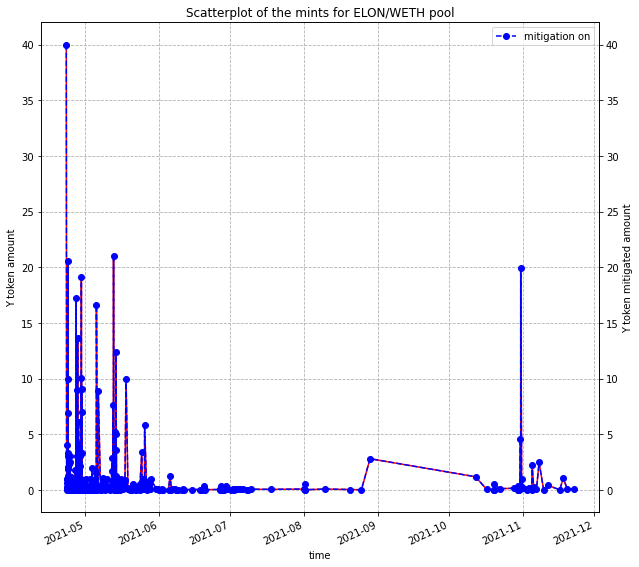

In [63]:
plot_mints(elon_weth_mints_mitigation_on_df, elon_weth_mints_mitigation_off_df, pool_name='ELON/WETH')

## MEV transactions extraction and analysis

### MEV attacks and possible MEVs extraction

There are 136 MEV attacks performed on the pool and 8789 possible attacks

In [64]:
elon_weth_filtered_swaps_df, elon_weth_mevs_df = elon_weth_sim.extract_filtered_and_mevs_dfs()

initial len = 338998, filtered len = 331400
txds = 7598
out values = 3799


In [65]:
elon_weth_suspicious_filtered_swaps_df, elon_weth_possible_mevs_df = elon_weth_sim.extract_suspicious_and_filtered_swaps_dfs()

initial len = 338998, filtered len = 328900
txds = 10098
out values = 5049.0


In [66]:
elon_weth_mevs_df = elon_weth_sim.calculate_attack_profit(elon_weth_mevs_df)
elon_weth_mevs_df = elon_weth_sim.calculate_attack_profit_by_token(elon_weth_mevs_df)

elon_price_df = elon_weth_sim.get_daily_token_price(first_to_second=False, token_name='ELON')
elon_price_df

,date,ELON_price
0,2021-04-23,1.960285e-11
1,2021-04-24,4.513429e-11
2,2021-04-25,3.180003e-11
3,2021-04-26,4.524601e-11
4,2021-04-27,9.061832e-11
...,...,...
275,2022-01-23,3.364543e-10
276,2022-01-24,3.154148e-10
277,2022-01-25,3.108672e-10
278,2022-01-26,3.502436e-10


In [67]:
elon_weth_mevs_df['date'] = elon_weth_mevs_df['timestamp'].dt.strftime("%Y-%m-%d")
elon_price_df['date'] = elon_price_df['date'].dt.strftime("%Y-%m-%d")

elon_weth_mevs_df = pd.merge(elon_weth_mevs_df, weth_price_df, on='date', how='left')
elon_weth_mevs_df = pd.merge(elon_weth_mevs_df, elon_price_df, on='date', how='left')
elon_weth_mevs_df = pd.merge(elon_weth_mevs_df, mevs_df, on='txd', how='left')

elon_weth_mevs_df['bruto_elon_to_weth_profit'] = (elon_weth_mevs_df['ELON_profit'] * 
                                                  elon_weth_mevs_df['ELON_price'])
elon_weth_mevs_df['bruto_elon_to_usdc_profit'] = (elon_weth_mevs_df['bruto_elon_to_weth_profit'] * 
                                                  elon_weth_mevs_df['WETH_price'])
elon_weth_mevs_df['bruto_total_profit'] = elon_weth_mevs_df['bruto_elon_to_usdc_profit'] + (
                                          elon_weth_mevs_df['WETH_profit'] * elon_weth_mevs_df['WETH_price'])
elon_weth_mevs_df.loc[elon_weth_mevs_df['tx_fee'] == 0, 'tx_fee'] = elon_weth_mevs_df['tx_fee'].median()
elon_weth_mevs_df.loc[elon_weth_mevs_df['tx_fee'] >= 1, 'tx_fee'] = elon_weth_mevs_df['tx_fee'].median()
elon_weth_mevs_df['gas_costs_usd'] = (elon_weth_mevs_df['tx_fee'] * elon_weth_mevs_df['WETH_price'] *
                                      elon_weth_mevs_df['gas_usage_by_tx'])
elon_weth_mevs_df['netto_profit'] = elon_weth_mevs_df['bruto_total_profit'] - elon_weth_mevs_df['gas_costs_usd']
elon_weth_mevs_df.dropna(inplace=True)
elon_weth_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,ELON_profit,WETH_profit,date,WETH_price,ELON_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_elon_to_weth_profit,bruto_elon_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,WETH,ELON,8.659269e+00,8.875907e+13,22731.628092,2021-04-23 01:10:31,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x9c9dd91ce26a033f9ed9df34ceac9c457ba0b7715d52...,0,300000,795.767851,8.875907e+13,8.659269,0.000000e+00,2.331355,2021-04-23,2370.813085,1.960285e-11,12293438.0,0.0,98942.0,2369.67,6.110000e-08,0.000000,0.000000,5527.207766,14.332410,5512.875356
1,ELON,WETH,8.875907e+13,1.099062e+01,23527.395943,2021-04-23 01:10:31,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0xc5b16f2c3989dcc07ed662402f03211d3587fa299264...,0,300000,795.767851,8.875907e+13,10.990625,0.000000e+00,2.331355,2021-04-23,2370.813085,1.960285e-11,12293438.0,2.0,62726.0,2369.67,6.110000e-08,0.000000,0.000000,5527.207766,9.086280,5518.121486
2,ELON,WETH,2.168125e+13,2.653980e+00,6140.360594,2021-04-23 01:11:04,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x154068d605ac2977aa1e1499f90de0df35d99667f8e6...,0,300000,611.325491,2.168125e+13,2.653980,0.000000e+00,0.377656,2021-04-23,2370.813085,1.960285e-11,12293441.0,2.0,62736.0,2369.67,6.110000e-08,0.000000,0.000000,895.351895,9.087729,886.264166
3,WETH,ELON,2.276324e+00,2.168125e+13,5529.035103,2021-04-23 01:11:04,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x7abc028f0cee5e81af0b53fdefddb5d84e92d817acb6...,0,300000,611.325491,2.168125e+13,2.276324,0.000000e+00,0.377656,2021-04-23,2370.813085,1.960285e-11,12293441.0,0.0,63451.0,2369.67,6.110000e-08,0.000000,0.000000,895.351895,9.191301,886.160594
4,ELON,WETH,1.958870e+13,2.733104e+00,6328.673911,2021-04-23 01:12:05,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x66b1fc472b2300e37e34a8afd95a1f6824e18a299eeb...,0,800000,353.663281,1.958870e+13,2.733104,0.000000e+00,0.272168,2021-04-23,2370.813085,1.960285e-11,12293444.0,2.0,106753.0,2369.67,6.110000e-08,0.000000,0.000000,645.259659,15.463885,629.795773
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9891,ELON,WETH,3.429123e+10,1.082789e+01,45456.293591,2021-11-24 14:34:31,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0x2e7f0c4b904b1920a4f780596cd7c3f3051c53cd406d...,117274970976,231261,0.000000,3.429123e+10,10.827887,3.809096e+08,0.000000,2021-11-24,4258.707179,3.141213e-10,13677746.0,1.0,131261.0,4271.96,1.172750e-07,0.119652,509.562034,509.562034,65.556962,444.005072
9892,WETH,ELON,2.997978e+01,9.581523e+10,126756.634235,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0x540c57a187e8405df4522b3786b774cecbf2fb5f,0xb1025f1069c6af5a3618f762306980e56bd022d26aa7...,2730906015544,212677,0.000000,9.581523e+10,29.979778,1.650357e+09,0.000000,2021-11-24,4258.707179,3.141213e-10,13678409.0,2.0,112677.0,4271.96,2.730906e-06,0.518412,2207.766210,2207.766210,1310.448051,897.318159
9893,ELON,WETH,9.416487e+10,2.997978e+01,126756.634235,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0xcbbee073ba8ed5ef6ca640bceaf32558f95e5a6d7a44...,171362925880,231297,0.000000,9.416487e+10,29.979778,1.650357e+09,0.000000,2021-11-24,4258.707179,3.141213e-10,13678409.0,0.0,131297.0,4271.96,1.713629e-07,0.518412,2207.766210,2207.766210,95.818518,2111.947692
9894,WETH,ELON,6.781140e+01,2.035519e+11,292516.018530,2021-11-25 03:43:03,0x00000000726422a6fecb4759b44d47e48cf746aa,0x00000000726422a6fecb4759b44d47e48cf746aa,0x3e58b06968559ee1f557f38a555d9b34d8d30dbbbe0c...,109260836940,350000,316.782762,2.035519e+11,67.811399,0.000

In [68]:
elon_weth_mevs_df[elon_weth_mevs_df['netto_profit'] > 100000]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,ELON_profit,WETH_profit,date,WETH_price,ELON_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_elon_to_weth_profit,bruto_elon_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
9390,WETH,ELON,2.651464e+02,8.856154e+11,1.141606e+06,2021-10-29 13:16:06,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x545f61b4cc20e62e84f0ae9e58cf73c8fc753aea6218...,155557368819,500108,133622.620455,8.856154e+11,265.146400,0.0,31.034847,2021-10-29,4413.585884,3.844378e-10,13512287.0,0.0,86462.0,4417.4,1.555574e-07,0.0,0.0,136974.962712,59.361853,136915.600859
9391,ELON,WETH,8.856154e+11,2.961812e+02,1.275228e+06,2021-10-29 13:16:06,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x9595453f114a815d4cbb54d13fe8e3f56d0a67bf6ed2...,155557368819,135685,133622.620455,8.856154e+11,296.181247,0.0,31.034847,2021-10-29,4413.585884,3.844378e-10,13512287.0,2.0,85685.0,4417.4,1.555574e-07,0.0,0.0,136974.962712,58.828391,136916.134320


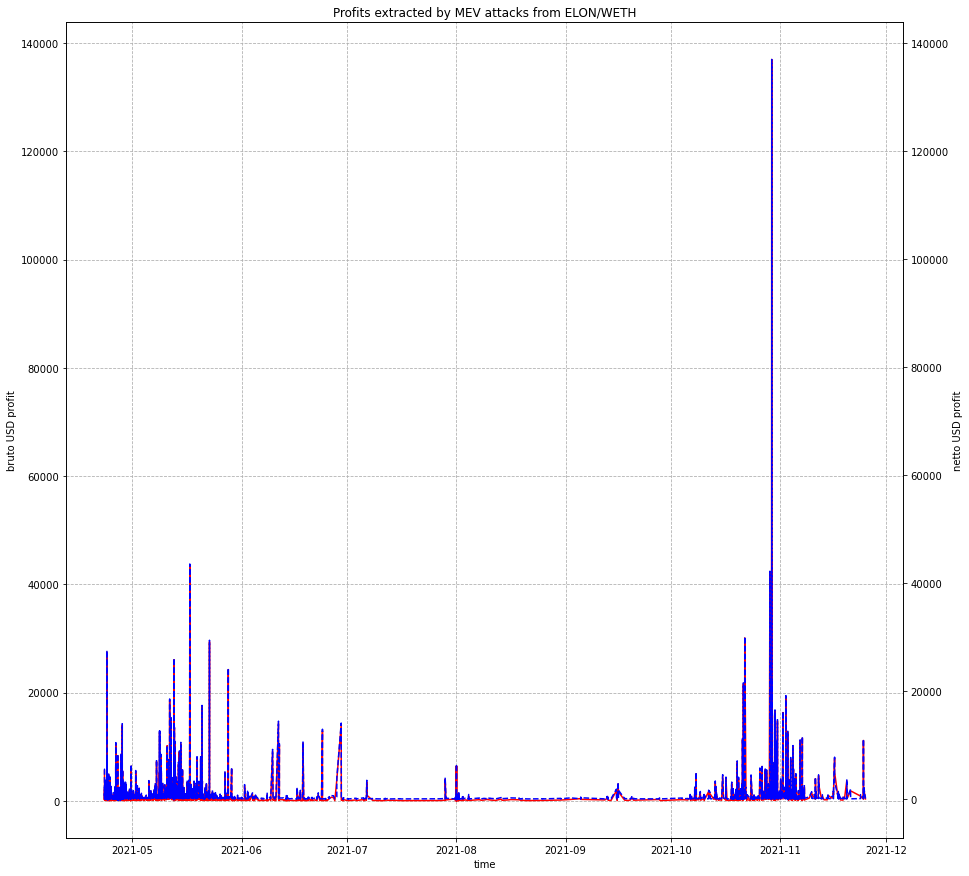

In [69]:
fig, ax = plt.subplots(figsize = (15, 15))
ax2 = ax.twinx()
ax.plot(elon_weth_mevs_df.timestamp, 
        elon_weth_mevs_df.bruto_total_profit, 
        label='bruto USD profit', color='r')
ax2.plot(elon_weth_mevs_df.timestamp, 
         elon_weth_mevs_df.netto_profit, 
         label='netto USD profit', color='b', linestyle='--')
ax.set_xlabel('time')
ax.set_ylabel('bruto USD profit')
ax2.set_ylabel('netto USD profit')
ax.set_title('Profits extracted by MEV attacks from ELON/WETH')
ax.grid(True, linestyle = '--')
plt.show()

### Plotting values of MEVs and possible MEVs with filtered swaps values

In [70]:
elon_weth_mevs_df

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,ELON_profit,WETH_profit,date,WETH_price,ELON_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_elon_to_weth_profit,bruto_elon_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,WETH,ELON,8.659269e+00,8.875907e+13,22731.628092,2021-04-23 01:10:31,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x9c9dd91ce26a033f9ed9df34ceac9c457ba0b7715d52...,0,300000,795.767851,8.875907e+13,8.659269,0.000000e+00,2.331355,2021-04-23,2370.813085,1.960285e-11,12293438.0,0.0,98942.0,2369.67,6.110000e-08,0.000000,0.000000,5527.207766,14.332410,5512.875356
1,ELON,WETH,8.875907e+13,1.099062e+01,23527.395943,2021-04-23 01:10:31,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0xc5b16f2c3989dcc07ed662402f03211d3587fa299264...,0,300000,795.767851,8.875907e+13,10.990625,0.000000e+00,2.331355,2021-04-23,2370.813085,1.960285e-11,12293438.0,2.0,62726.0,2369.67,6.110000e-08,0.000000,0.000000,5527.207766,9.086280,5518.121486
2,ELON,WETH,2.168125e+13,2.653980e+00,6140.360594,2021-04-23 01:11:04,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x154068d605ac2977aa1e1499f90de0df35d99667f8e6...,0,300000,611.325491,2.168125e+13,2.653980,0.000000e+00,0.377656,2021-04-23,2370.813085,1.960285e-11,12293441.0,2.0,62736.0,2369.67,6.110000e-08,0.000000,0.000000,895.351895,9.087729,886.264166
3,WETH,ELON,2.276324e+00,2.168125e+13,5529.035103,2021-04-23 01:11:04,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x02023798e0890ddebfa4cc6d4b2b05434e940202,0x7abc028f0cee5e81af0b53fdefddb5d84e92d817acb6...,0,300000,611.325491,2.168125e+13,2.276324,0.000000e+00,0.377656,2021-04-23,2370.813085,1.960285e-11,12293441.0,0.0,63451.0,2369.67,6.110000e-08,0.000000,0.000000,895.351895,9.191301,886.160594
4,ELON,WETH,1.958870e+13,2.733104e+00,6328.673911,2021-04-23 01:12:05,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x66b1fc472b2300e37e34a8afd95a1f6824e18a299eeb...,0,800000,353.663281,1.958870e+13,2.733104,0.000000e+00,0.272168,2021-04-23,2370.813085,1.960285e-11,12293444.0,2.0,106753.0,2369.67,6.110000e-08,0.000000,0.000000,645.259659,15.463885,629.795773
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9891,ELON,WETH,3.429123e+10,1.082789e+01,45456.293591,2021-11-24 14:34:31,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0x2e7f0c4b904b1920a4f780596cd7c3f3051c53cd406d...,117274970976,231261,0.000000,3.429123e+10,10.827887,3.809096e+08,0.000000,2021-11-24,4258.707179,3.141213e-10,13677746.0,1.0,131261.0,4271.96,1.172750e-07,0.119652,509.562034,509.562034,65.556962,444.005072
9892,WETH,ELON,2.997978e+01,9.581523e+10,126756.634235,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0x540c57a187e8405df4522b3786b774cecbf2fb5f,0xb1025f1069c6af5a3618f762306980e56bd022d26aa7...,2730906015544,212677,0.000000,9.581523e+10,29.979778,1.650357e+09,0.000000,2021-11-24,4258.707179,3.141213e-10,13678409.0,2.0,112677.0,4271.96,2.730906e-06,0.518412,2207.766210,2207.766210,1310.448051,897.318159
9893,ELON,WETH,9.416487e+10,2.997978e+01,126756.634235,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0x000000000035b5e5ad9019092c665357240f594e,0xcbbee073ba8ed5ef6ca640bceaf32558f95e5a6d7a44...,171362925880,231297,0.000000,9.416487e+10,29.979778,1.650357e+09,0.000000,2021-11-24,4258.707179,3.141213e-10,13678409.0,0.0,131297.0,4271.96,1.713629e-07,0.518412,2207.766210,2207.766210,95.818518,2111.947692
9894,WETH,ELON,6.781140e+01,2.035519e+11,292516.018530,2021-11-25 03:43:03,0x00000000726422a6fecb4759b44d47e48cf746aa,0x00000000726422a6fecb4759b44d47e48cf746aa,0x3e58b06968559ee1f557f38a555d9b34d8d30dbbbe0c...,109260836940,350000,316.782762,2.035519e+11,67.811399,0.000

In [71]:
elon_weth_mevs_df[elon_weth_mevs_df['profit'] == elon_weth_mevs_df['profit'].max()]

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,ELON_profit,WETH_profit,date,WETH_price,ELON_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_elon_to_weth_profit,bruto_elon_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
9390,WETH,ELON,2.651464e+02,8.856154e+11,1.141606e+06,2021-10-29 13:16:06,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x545f61b4cc20e62e84f0ae9e58cf73c8fc753aea6218...,155557368819,500108,133622.620455,8.856154e+11,265.146400,0.0,31.034847,2021-10-29,4413.585884,3.844378e-10,13512287.0,0.0,86462.0,4417.4,1.555574e-07,0.0,0.0,136974.962712,59.361853,136915.600859
9391,ELON,WETH,8.856154e+11,2.961812e+02,1.275228e+06,2021-10-29 13:16:06,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x9595453f114a815d4cbb54d13fe8e3f56d0a67bf6ed2...,155557368819,135685,133622.620455,8.856154e+11,296.181247,0.0,31.034847,2021-10-29,4413.585884,3.844378e-10,13512287.0,2.0,85685.0,4417.4,1.555574e-07,0.0,0.0,136974.962712,58.828391,136916.134320


In [72]:
elon_weth_mevs_df[elon_weth_mevs_df['sender'] == '0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d']

,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,gas_price,gas_used,profit,first_token_value,second_token_value,ELON_profit,WETH_profit,date,WETH_price,ELON_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_elon_to_weth_profit,bruto_elon_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
66,WETH,ELON,2.922000e+01,5.871038e+12,65907.959247,2021-04-23 04:34:16,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xd25499cd4d4a40fbaa6fbcdf740880186e34a70876f7...,0,1000000,391.404178,5.871038e+12,29.220000,0.0,0.173527,2021-04-23,2370.813085,1.960285e-11,12294325.0,0.0,79478.0,2369.67,6.110000e-08,0.0,0.0,411.400788,11.512919,399.887869
67,ELON,WETH,5.871038e+12,2.939353e+01,66299.363425,2021-04-23 04:34:16,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xdf526098b7a98df6b6fbd1d16beafbe9614c1bb96b08...,0,4000000,391.404178,5.871038e+12,29.393527,0.0,0.173527,2021-04-23,2370.813085,1.960285e-11,12294325.0,2.0,92683.0,2369.67,6.110000e-08,0.0,0.0,411.400788,13.425752,397.975037
68,WETH,ELON,1.905000e+01,3.055871e+12,42295.922893,2021-04-23 04:54:10,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x455379c10288207c652fbc86e06bc244a773527f5696...,0,1000000,3168.322404,3.055871e+12,19.050000,0.0,1.427006,2021-04-23,2370.813085,1.960285e-11,12294395.0,0.0,62378.0,2369.67,6.110000e-08,0.0,0.0,3383.164837,9.035870,3374.128967
69,ELON,WETH,3.055871e+12,2.047701e+01,45464.245297,2021-04-23 04:54:10,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xedca249c1ca60990ba9fa5b9987bffb0c8a1111d97f9...,0,4000000,3168.322404,3.055871e+12,20.477006,0.0,1.427006,2021-04-23,2370.813085,1.960285e-11,12294395.0,2.0,61016.0,2369.67,6.110000e-08,0.0,0.0,3383.164837,8.838575,3374.326261
70,WETH,ELON,1.785000e+01,2.625580e+12,39299.718729,2021-04-23 04:59:40,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x7dac4aeed11f0afee8912eb95e8605f289a96fd8891c...,0,1000000,175.405628,2.625580e+12,17.850000,0.0,0.079670,2021-04-23,2370.813085,1.960285e-11,12294420.0,3.0,92182.0,2369.67,6.110000e-08,0.0,0.0,188.881585,13.353178,175.528406
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9865,ELON,WETH,9.402623e+10,3.928177e+01,169638.373319,2021-11-18 02:11:50,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xb8670e4cab6b75fe3d5484482379e12513963b5e5458...,120092144147,135685,160.869321,9.402623e+10,39.281768,0.0,0.037251,2021-11-18,3986.866652,4.096798e-10,13636612.0,3.0,85685.0,3998.17,1.200921e-07,0.0,0.0,148.515530,41.025238,107.490292
9880,ELON,WETH,1.898551e+11,7.277505e+01,313565.720723,2021-11-23 18:37:48,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xbd1e562d13ac9cfd589af44fc053edbe5f9fceae18a3...,2348739922202,126374,849.953653,1.898551e+11,72.775050,0.0,0.197265,2021-11-23,4347.572488,3.722940e-10,13672450.0,2.0,76374.0,4341.17,2.348740e-06,0.0,0.0,857.622188,779.879130,77.743059
9881,WETH,ELON,7.257779e+01,1.898551e+11,312715.767070,2021-11-23 18:37:48,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xc96cad86e3735ae9d5e7b546eea896fe34ab46743732...,127209663809,500066,849.953653,1.898551e+11,72.577785,0.0,0.197265,2021-11-23,4347.572488,3.722940e-10,13672450.0,0.0,86296.0,4341.17,1.272097e-07,0.0,0.0,857.622188,47.726282,809.895906
9886,ELON,WETH,7.093990e+10,2.171019e+01,91192.845899,2021-11-24 14:19:57,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x60003e594c3446d5782370c1584f3c791ed33b8893da...,4751092222661,126342,1578.078838,7.093990e+10,21.710192,0.0,0.375692,2021-11-24,4258.707179,3.141213e-10,13677690.0,2.0,76342.0,4271.96,4.751092e-06,0.0,0.0,1599.960883,1544.666663,55.294220


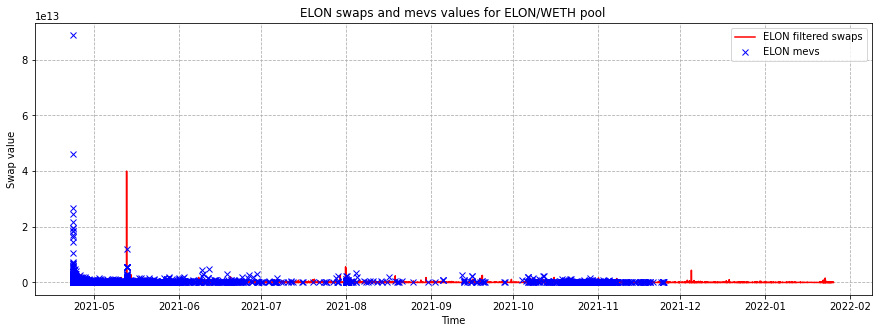

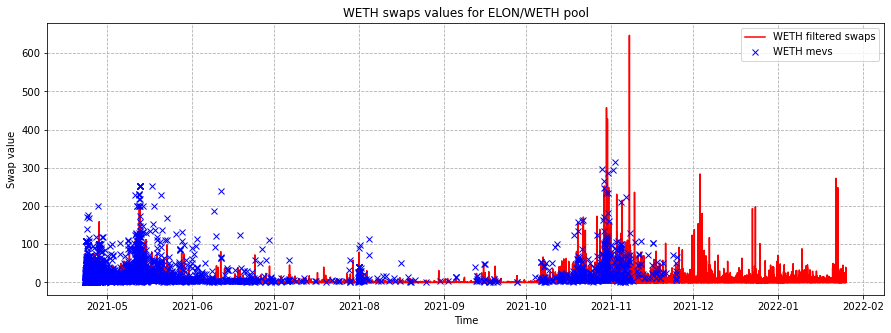

In [73]:
elon_weth_sim.show_swaps_and_mevs_by_token(
    elon_weth_filtered_swaps_df, 
    elon_weth_mevs_df, width=15, height=5)

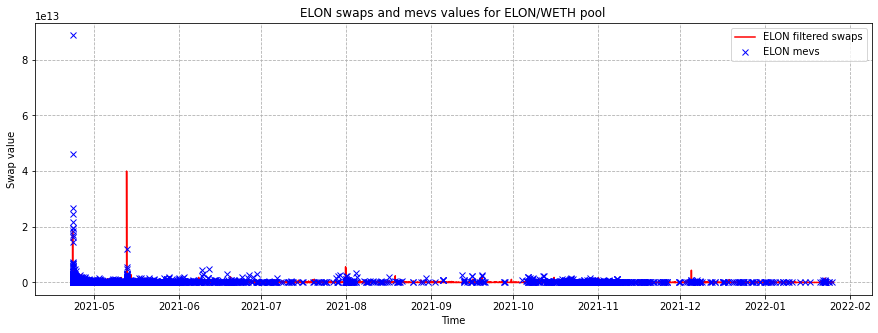

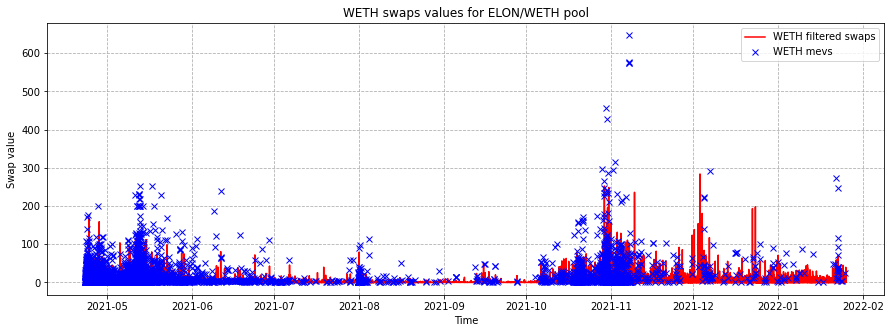

In [74]:
elon_weth_sim.show_swaps_and_mevs_by_token(elon_weth_suspicious_filtered_swaps_df, elon_weth_possible_mevs_df, width=15, height=5)

### Plotting MEV transactions and possible MEV transactions with filtered swaps daily count distributions

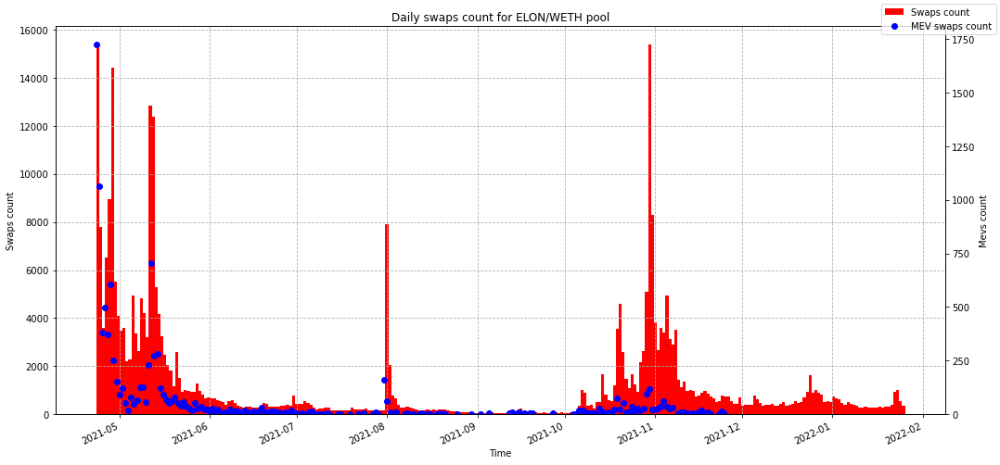

In [75]:
elon_weth_sim.show_swaps_and_mevs_daily_count_by_token(elon_weth_filtered_swaps_df, elon_weth_mevs_df, mevs_alter_axis=True)

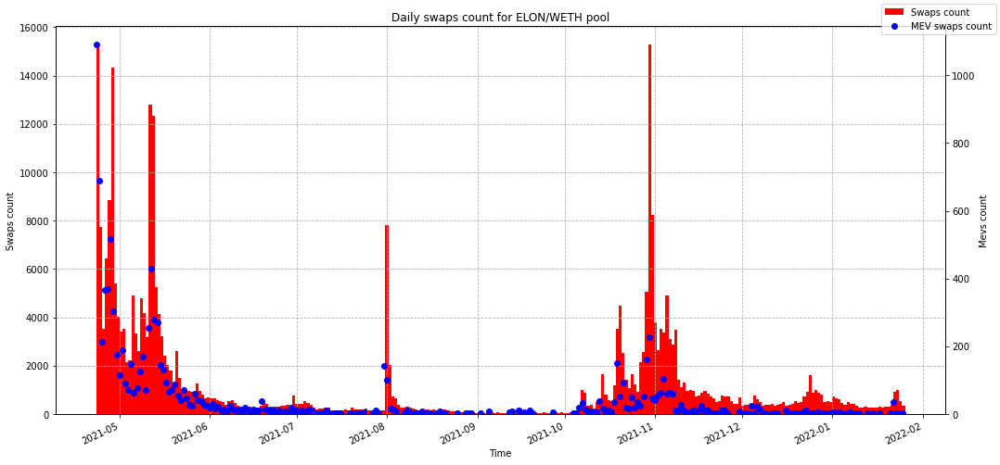

In [76]:
elon_weth_sim.show_swaps_and_mevs_daily_count_by_token(elon_weth_suspicious_filtered_swaps_df, elon_weth_possible_mevs_df, mevs_alter_axis=True)

### Plotting ratio of MEV attacks to filtered swaps

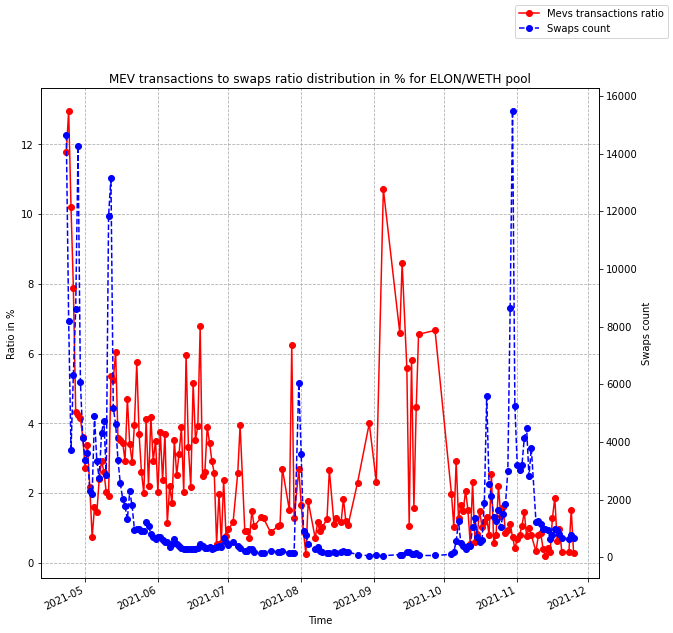

In [77]:
elon_weth_sim.show_mevs_to_swaps_ratio(elon_weth_filtered_swaps_df, elon_weth_mevs_df)

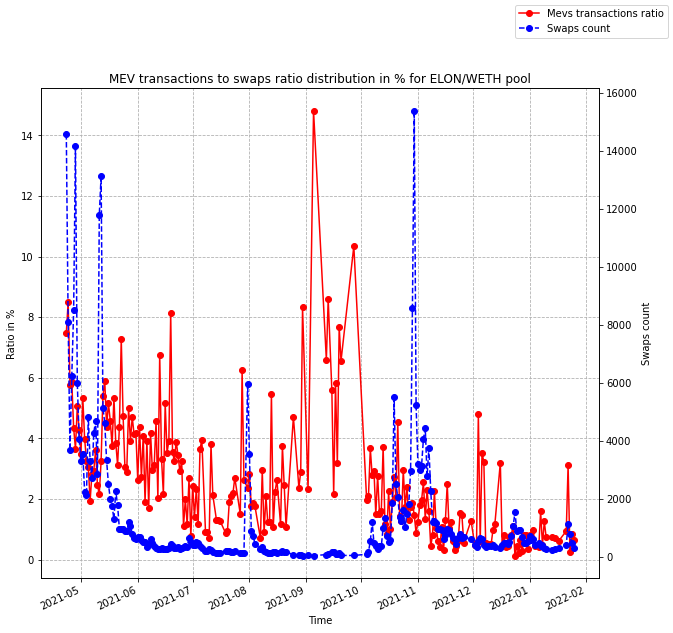

In [78]:
elon_weth_sim.show_mevs_to_swaps_ratio(elon_weth_suspicious_filtered_swaps_df, elon_weth_possible_mevs_df)

### Plotting ratio of MEVs and suspicious transactions to filtered swaps

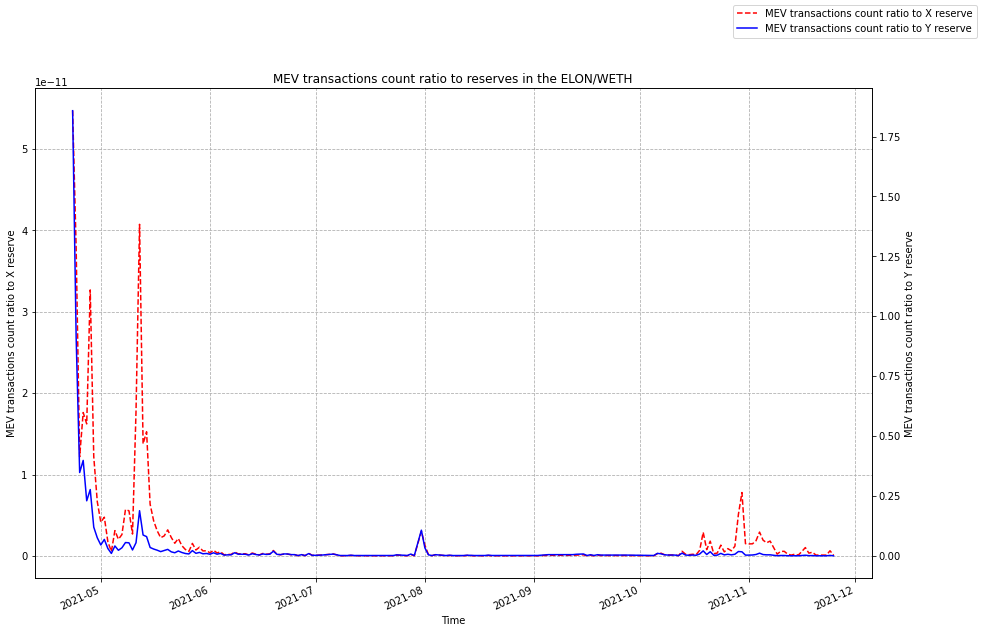

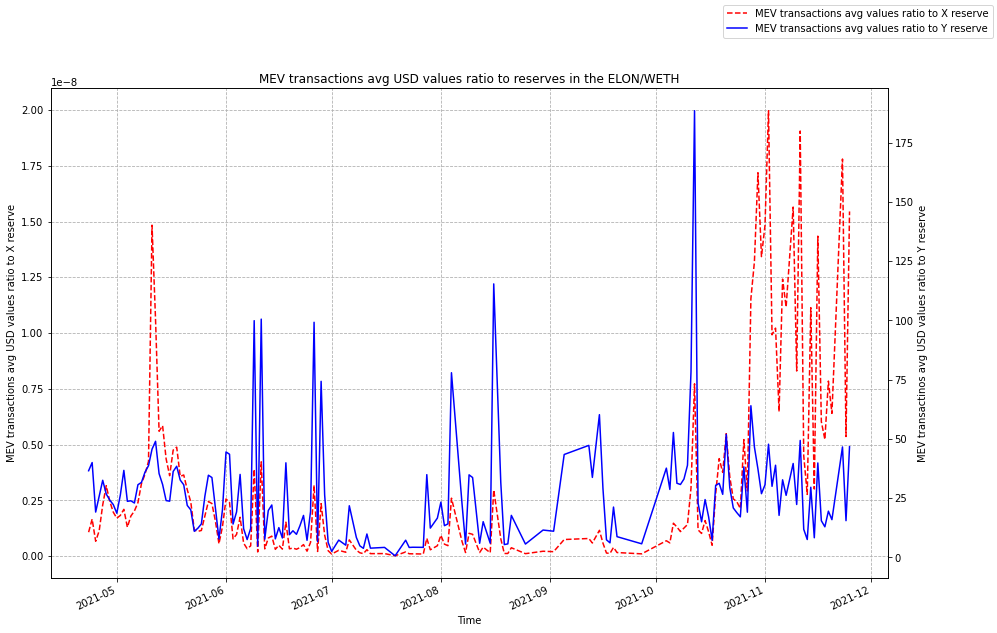

In [79]:
elon_weth_sim.show_mevs_to_reserves_ratio(elon_weth_swaps_mitigation_off_df, elon_weth_mevs_df, width=15, height=10)
elon_weth_sim.show_mevs_values_to_reserves_ratio(elon_weth_swaps_mitigation_off_df, elon_weth_mevs_df, width=15, height=10)

### Plotting transaction values distribution of passed swaps, blocked swaps and not enough reserves swaps

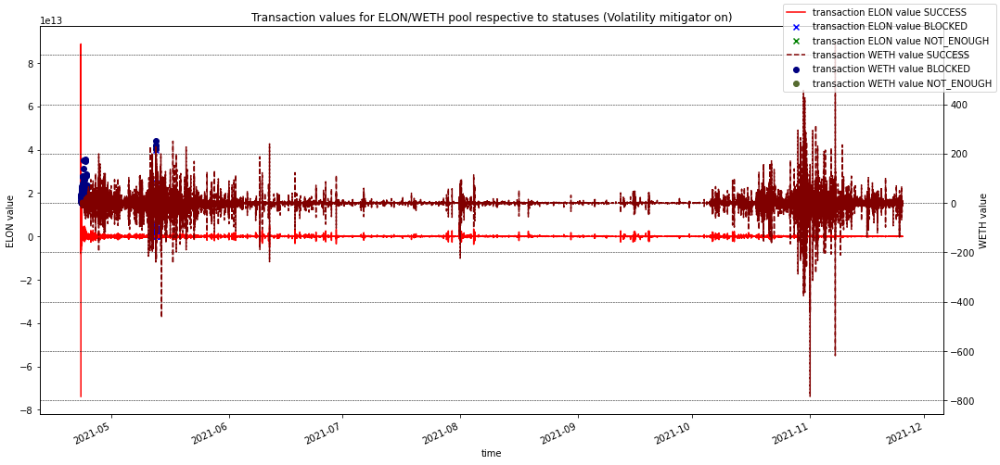

In [80]:
elon_weth_sim.plot_transactions_by_type(elon_weth_swaps_mitigation_on_df, ignore_success=False, width=15, height=7)

### Plotting mitigation comparison, slice factor distribution, reserves distributions, cumulative prices distributions, transaction frequency distributions, price impact after each transaction distributions

Original ELON/WETH pool has next statuses counts:
SUCCESS    307301
Name: status, dtype: int64
Mitigated ELON/WETH dataframe has next statuses counts:
SUCCESS                             302684
BLOCKED_BY_VOLATILITY_MITIGATION      4617
Name: status, dtype: int64
TWAP unavailability ratio for ELON/WETH is 9.762415351723554e-06
Mitigated ELON/WETH dataframe has next Mitigator statuses:
CHECKED                307298
CANT_CONSULT_ORACLE         3
Name: mitigator_check_status, dtype: int64


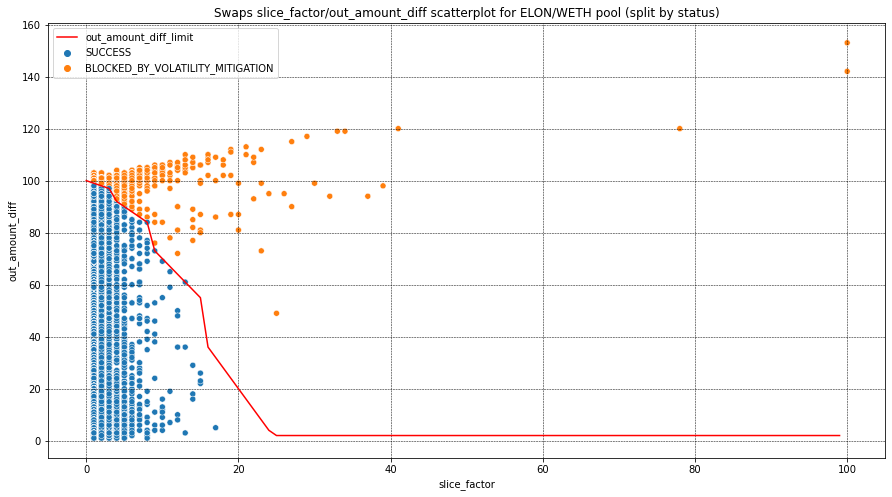

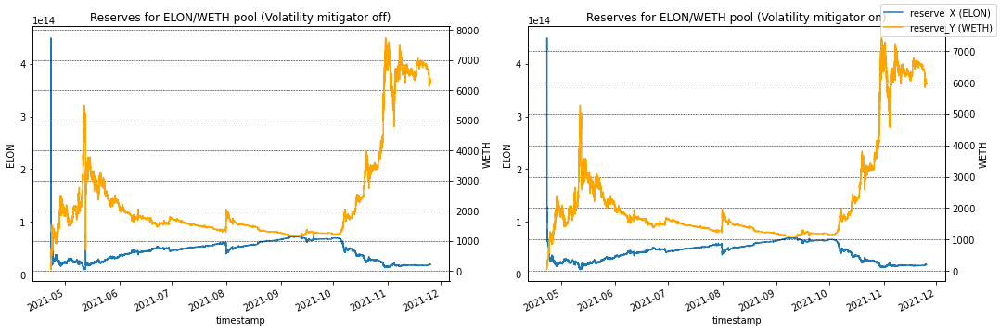

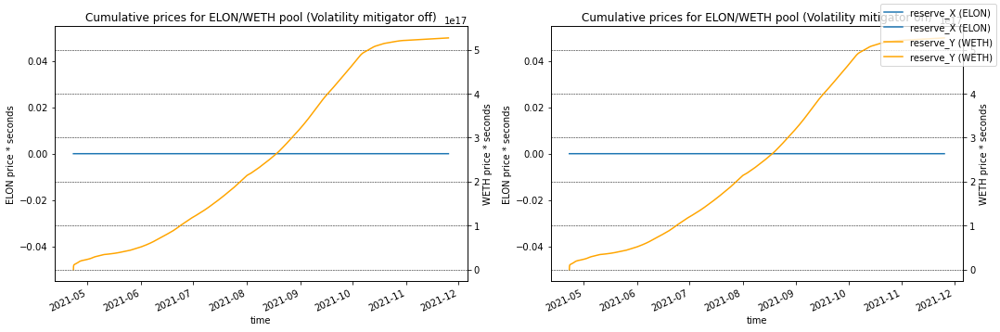

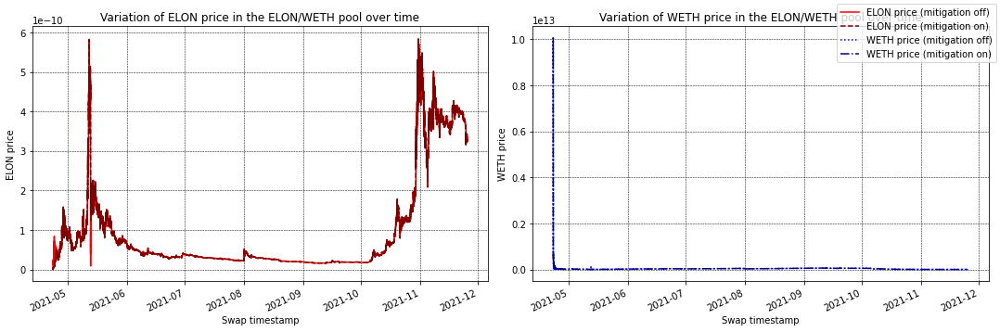

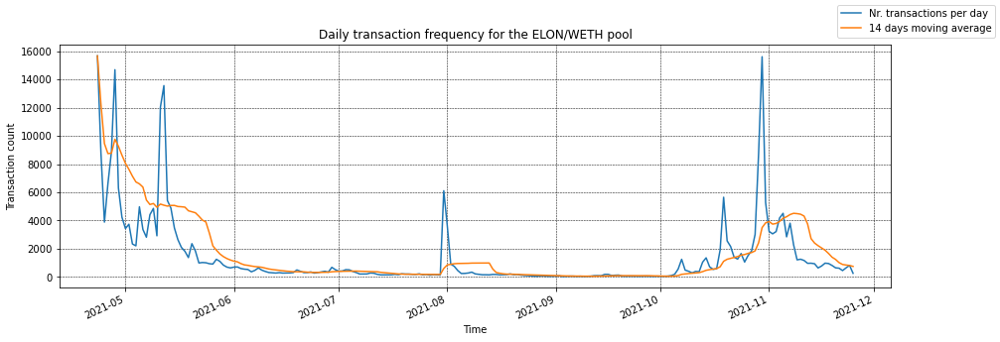

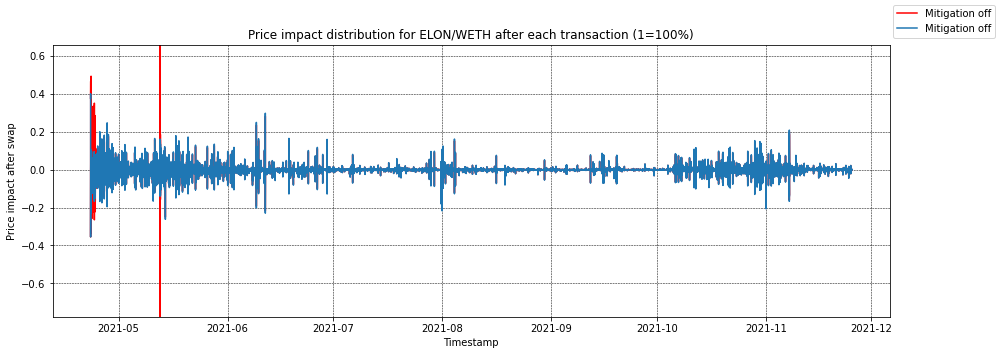

In [81]:
elon_weth_sim.show_mitigation_comparison(elon_weth_swaps_mitigation_off_df, 
                                         elon_weth_swaps_mitigation_on_df)
elon_weth_sim.px_hist_blocked_transactions_slice(elon_weth_swaps_mitigation_on_df)
elon_weth_sim.px_hist_blocked_transactions_difference_from_oracle(elon_weth_swaps_mitigation_on_df)
elon_weth_sim.plot_slice_distribution_and_diff_limit_line(elon_weth_swaps_mitigation_on_df)
elon_weth_sim.plot_reserves_with_and_without_mitigation(elon_weth_swaps_mitigation_off_df, 
                                                        elon_weth_swaps_mitigation_on_df)
elon_weth_sim.plot_cumulative_prices_with_and_without_mitigation(elon_weth_swaps_mitigation_off_df, 
                                                                 elon_weth_swaps_mitigation_off_df, 
                                                                 make_big_num_convert=True)
elon_weth_sim.plot_price_distribution(elon_weth_swaps_mitigation_off_df, 
                                      elon_weth_swaps_mitigation_on_df, 
                                      separate_plots=True)
elon_weth_sim.plot_frequency_distribution(elon_weth_swaps_mitigation_on_df)
elon_weth_sim.plot_price_impact(elon_weth_swaps_mitigation_off_df, 
                                elon_weth_swaps_mitigation_on_df, 
                                smallest_y=elon_weth_swaps_mitigation_off_df['price_diff'].min(), 
                                biggest_y=elon_weth_swaps_mitigation_off_df['price_diff'].max())

In [82]:
elon_weth_blocked_df = elon_weth_swaps_mitigation_on_df[elon_weth_swaps_mitigation_on_df['status'] == 'BLOCKED_BY_VOLATILITY_MITIGATION']
elon_weth_blocked_mevs_df = pd.merge(elon_weth_blocked_df, elon_weth_mevs_df, on='txd')
elon_weth_blocked_mevs_df

,id,token_in_x,token_out_x,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender_x,to_x,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff,token_in_y,token_out_y,amount_in,amount_out,amount_usd,timestamp,sender_y,to_y,gas_price,gas_used,profit,first_token_value,second_token_value,ELON_profit,WETH_profit,date,WETH_price,ELON_price,block,block_position,gas_usage_by_tx,ether_price,tx_fee,bruto_elon_to_weth_profit,bruto_elon_to_usdc_profit,bruto_total_profit,gas_costs_usd,netto_profit
0,60,WETH,ELON,1.350430e+01,0.0,1.646278e+13,NaN,CHECKED,5.075126e+13,102.0,11.0,33.0,BLOCKED_BY_VOLATILITY_MITIGATION,77.0,2021-04-23 01:29:14,2021-04-23 01:29:00,0x2c63e90e9859de14afb041236e5b2f0f6e2b2fe63808...,0x000000005804b22091aa9830e50459a15e7c9241,0x000000005804b22091aa9830e50459a15e7c9241,60,1.665239e+14,121.863130,2.029313e+16,0,4171552744986149,True,1.665239e+14,121.863130,2.029313e+16,0,4171552744986149,True,7.318055e-13,0.0,WETH,ELON,1.350430e+01,1.713136e+13,3.169918e+04,2021-04-23 01:29:00,0x000000005804b22091aa9830e50459a15e7c9241,0x000000005804b22091aa9830e50459a15e7c9241,0,200000,2116.168451,1.713136e+13,13.504300,0.0,0.901518,2021-04-23,2370.813085,1.960285e-11,12293510.0,0.0,56610.0,2369.67,6.110000e-08,0.0,0.0,2137.330413,8.200337,2129.130077
1,90,WETH,ELON,2.246682e+01,0.0,2.817955e+13,NaN,CHECKED,6.715090e+13,81.0,20.0,80.0,BLOCKED_BY_VOLATILITY_MITIGATION,112.0,2021-04-23 01:37:59,2021-04-23 01:37:48,0x71dd472b507c494dbe74c90e0af4fcffce9618957d33...,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,90,1.752287e+14,116.066090,2.033812e+16,0,4886838996408331,True,1.752287e+14,116.066090,2.033812e+16,0,4886838996408331,True,6.623690e-13,0.0,WETH,ELON,2.246682e+01,1.957150e+13,5.261349e+04,2021-04-23 01:37:48,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0,800000,924.141090,1.957150e+13,22.466819,0.0,0.394623,2021-04-23,2370.813085,1.960285e-11,12293537.0,0.0,126611.0,2369.67,6.110000e-08,0.0,0.0,935.578169,18.340449,917.237720
2,100,WETH,ELON,3.318759e+01,0.0,3.499199e+13,NaN,CHECKED,9.340078e+13,90.0,27.0,98.0,BLOCKED_BY_VOLATILITY_MITIGATION,126.0,2021-04-23 01:41:29,2021-04-23 01:41:24,0x176f4851afac8300c4ddda60f1e7867551288235313e...,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,100,1.657319e+14,122.758163,2.034494e+16,0,5151934031099911,True,1.657319e+14,122.758163,2.034494e+16,0,5192436075446836,True,7.407034e-13,0.0,WETH,ELON,3.318759e+01,2.442276e+13,7.712561e+04,2021-04-23 01:41:24,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0,800000,385.453323,2.442276e+13,33.187589,0.0,0.165863,2021-04-23,2370.813085,1.960285e-11,12293561.0,0.0,100182.0,2369.67,6.110000e-08,0.0,0.0,393.229615,14.512032,378.717584
3,118,WETH,ELON,2.635299e+01,0.0,3.200960e+13,NaN,CHECKED,6.951375e+13,73.0,23.0,92.0,BLOCKED_BY_VOLATILITY_MITIGATION,148.0,2021-04-23 01:46:59,2021-04-23 01:46:56,0x4aa6771b0ab259ca5b53c389a45c927cd9bd55435b82...,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,118,1.749212e+14,116.480313,2.037488e+16,0,5714674811085707,True,1.749212e+14,116.480313,2.037488e+16,0,5737200664743377,True,6.659015e-13,0.0,WETH,ELON,2.635299e+01,1.844573e+13,6.123423e+04,2021-04-23 01:46:56,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0,800000,2349.212546,1.844573e+13,26.352994,0.0,1.009610,2021-04-23,2370.813085,1.960285e-11,12293587.0,0.0,140460.0,2369.67,6.110000e-08,0.0,0.0,2393.597509,20.346569,2373.250940
4,127,WETH,ELON,2.517000e+01,0.0,3.876841e

In [83]:
elon_weth_blocked_df = elon_weth_swaps_mitigation_on_df[elon_weth_swaps_mitigation_on_df['status'] == 'BLOCKED_BY_VOLATILITY_MITIGATION']
elon_weth_blocked_mevs_df = pd.merge(elon_weth_blocked_df, elon_weth_possible_mevs_df, on='txd')
elon_weth_blocked_mevs_df

,id,token_in_x,token_out_x,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender_x,to_x,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff,token_in_y,token_out_y,amount_in,amount_out,amount_usd,timestamp,sender_y,to_y,gas_price,gas_used
0,60,WETH,ELON,1.350430e+01,0.0,1.646278e+13,NaN,CHECKED,5.075126e+13,102.0,11.0,33.0,BLOCKED_BY_VOLATILITY_MITIGATION,77.0,2021-04-23 01:29:14,2021-04-23 01:29:00,0x2c63e90e9859de14afb041236e5b2f0f6e2b2fe63808...,0x000000005804b22091aa9830e50459a15e7c9241,0x000000005804b22091aa9830e50459a15e7c9241,60,1.665239e+14,121.863130,2.029313e+16,0,4171552744986149,True,1.665239e+14,121.863130,2.029313e+16,0,4171552744986149,True,7.318055e-13,0.0,WETH,ELON,1.350430e+01,1.713136e+13,3.169918e+04,2021-04-23 01:29:00,0x000000005804b22091aa9830e50459a15e7c9241,0x000000005804b22091aa9830e50459a15e7c9241,0,200000
1,90,WETH,ELON,2.246682e+01,0.0,2.817955e+13,NaN,CHECKED,6.715090e+13,81.0,20.0,80.0,BLOCKED_BY_VOLATILITY_MITIGATION,112.0,2021-04-23 01:37:59,2021-04-23 01:37:48,0x71dd472b507c494dbe74c90e0af4fcffce9618957d33...,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,90,1.752287e+14,116.066090,2.033812e+16,0,4886838996408331,True,1.752287e+14,116.066090,2.033812e+16,0,4886838996408331,True,6.623690e-13,0.0,WETH,ELON,2.246682e+01,1.957150e+13,5.261349e+04,2021-04-23 01:37:48,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0,800000
2,100,WETH,ELON,3.318759e+01,0.0,3.499199e+13,NaN,CHECKED,9.340078e+13,90.0,27.0,98.0,BLOCKED_BY_VOLATILITY_MITIGATION,126.0,2021-04-23 01:41:29,2021-04-23 01:41:24,0x176f4851afac8300c4ddda60f1e7867551288235313e...,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,100,1.657319e+14,122.758163,2.034494e+16,0,5151934031099911,True,1.657319e+14,122.758163,2.034494e+16,0,5192436075446836,True,7.407034e-13,0.0,WETH,ELON,3.318759e+01,2.442276e+13,7.712561e+04,2021-04-23 01:41:24,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0,800000
3,118,WETH,ELON,2.635299e+01,0.0,3.200960e+13,NaN,CHECKED,6.951375e+13,73.0,23.0,92.0,BLOCKED_BY_VOLATILITY_MITIGATION,148.0,2021-04-23 01:46:59,2021-04-23 01:46:56,0x4aa6771b0ab259ca5b53c389a45c927cd9bd55435b82...,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,118,1.749212e+14,116.480313,2.037488e+16,0,5714674811085707,True,1.749212e+14,116.480313,2.037488e+16,0,5737200664743377,True,6.659015e-13,0.0,WETH,ELON,2.635299e+01,1.844573e+13,6.123423e+04,2021-04-23 01:46:56,0x575c3a99429352eda66661fc3857b9f83f58a73f,0x575c3a99429352eda66661fc3857b9f83f58a73f,0,800000
4,127,WETH,ELON,2.517000e+01,0.0,3.876841e+13,NaN,CHECKED,6.454741e+13,49.0,25.0,98.0,BLOCKED_BY_VOLATILITY_MITIGATION,160.0,2021-04-23 01:49:59,2021-04-23 01:49:59,0x2d2132b94deb858b3b298e56e01e9f3a56a826b8cc30...,0xd78a3280085ee846196cb5fab7d510b279486d44,0xf6da21e95d74767009accb145b96897ac3630bad,127,1.986046e+14,102.734295,2.040350e+16,0,6039298397021849,True,1.986046e+14,102.734295,2.040350e+16,0,6039298397021849,True,5.172806e-13,0.0,WETH,ELON,2.517000e+01,1.648419e+13,5.757361e+04,2021-04-23 01:49:59,0xd78a3280085ee846196cb5fab7d510b279486d44,0xf6da21e95d74767009accb145b96897ac3630bad,1000000000,200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
593,127866,ELON,WETH,7.870505e+11,0.0,1.091739e+02,NaN,CHECKED,3.323417e+02,101.0,5.0,10.0,BLOCKED_BY_VOLATILITY_MITIGATION,114072.0,2021-05-12 20:27:59,2021-05-12 20:27:

# SQUID/WETH

In [84]:
squid_weth_mints_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on
0,0,7.381000e+11,1.7,1632952649,SUCCESS,0,1632952649,1632952649,0,0.0,0.0,0.0,0,0,False,7.381000e+11,1.7,1.254770e+12,0,0,False


In [85]:
squid_weth_burns_mitigation_off_df

,id,X_amount,Y_amount,timestamp,status,block_number,block_timestamp,transaction_timestamp,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,transaction_id,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on


In [86]:
squid_weth_swaps_mitigation_off_df

,id,token_in,token_out,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender,to,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff
0,1,SQUID,WETH,1.515152e+10,0.0,0.033860,0.000135,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,4.0,2021-09-29 21:58:29,2021-09-29 21:58:26,0x817a2564c2300f96b539332fde239bfa2f7a44a5a9c5...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,1,7.381000e+11,1.700000,1.254770e+12,0,0,False,7.532515e+11,1.666005,1.254920e+12,0,0,False,2.211751e-12,-0.039710
1,2,SQUID,WETH,1.274336e+10,0.0,0.027444,0.000110,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,4.0,2021-09-29 21:58:29,2021-09-29 21:58:26,0x817a2564c2300f96b539332fde239bfa2f7a44a5a9c5...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,2,7.532515e+11,1.666005,1.254920e+12,0,0,False,7.659949e+11,1.638451,1.255045e+12,0,0,False,2.138984e-12,-0.032900
2,3,SQUID,WETH,2.647412e+09,0.0,0.005587,0.000022,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,7.0,2021-09-29 21:59:14,2021-09-29 21:59:00,0xdda4b205d0b44eb3030010f6ac32ced6b62e6211e51f...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,3,7.659949e+11,1.638451,1.255045e+12,0,0,False,7.686423e+11,1.632842,1.255071e+12,0,21038021653433,False,2.124319e-12,-0.006856
3,4,SQUID,WETH,9.266101e+09,0.0,0.019257,0.000077,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,7.0,2021-09-29 21:59:14,2021-09-29 21:59:00,0xcda98c33dcdff5252700cac9921313c8d5e6b1569e6f...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,4,7.686423e+11,1.632842,1.255071e+12,0,21038021653433,False,7.779084e+11,1.613507,1.255161e+12,0,21038021653433,False,2.074161e-12,-0.023612
4,5,SQUID,WETH,1.263748e+10,0.0,0.025539,0.000102,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,7.0,2021-09-29 21:59:14,2021-09-29 21:59:00,0xcda98c33dcdff5252700cac9921313c8d5e6b1569e6f...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,5,7.779084e+11,1.613507,1.255161e+12,0,21038021653433,False,7.905459e+11,1.587866,1.255281e+12,0,21038021653433,False,2.008569e-12,-0.031623
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
171,172,SQUID,WETH,7.214226e+09,0.0,0.002933,0.000012,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,14501.0,2021-10-02 10:22:44,2021-10-02 10:22:31,0xc3da395ea30b5fbde77fc136e4106ba82e7343cd189f...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,172,1.748897e+12,0.721170,1.261251e+12,0,513648518254322237,False,1.756111e+12,0.718225,1.261283e+12,0,513648518254322237,False,4.089859e-13,-0.008175
172,173,SQUID,WETH,1.352357e+09,0.0,0.000547,0.000002,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,61272.0,2021-10-10 13:15:29,2021-10-10 13:15:24,0xba307bef6a8f4609a82bbfd66623f310a7f21c3d2d82...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,173,1.756111e+12,0.718225,1.261283e+12,0,513648518254322237,False,1.757464e+12,0.717675,1.261288e+12,0,2229025472112831516,False,4.083586e-13,-0.001534
173,174,SQUID,WETH,1.017555e+10,0.0,0.004090,0.000016,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,61272.0,2021-10-10 13:15:29,2021-10-10 13:15:24,0xba307bef6a8f4609a82bbfd66623f310a7f21c3d2d82...,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,174,1.757464e+12,0.717675,1.261288e+12,0,2229025472112831516,False,1.767639e+12,0.713569,1.261332e+12,0,2229025472112831516,False,4.036846e-13,-0.011446
174,175,SQUID,WETH,7.732504e+08,0.0,0.000309,0.000001,MITIGATOR_OFF,NaN,NaN,NaN,NaN,SUCCESS,72708

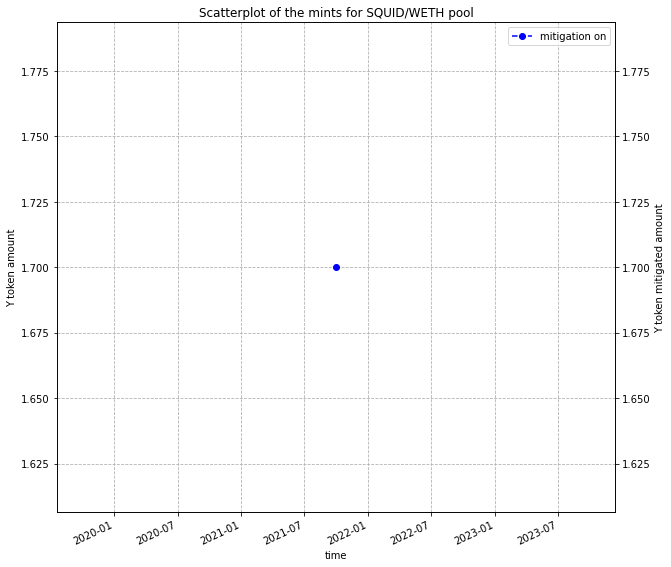

In [87]:
plot_mints(squid_weth_mints_mitigation_on_df, squid_weth_mints_mitigation_off_df, pool_name='SQUID/WETH')

## MEV transactions extraction and analysis

### MEV attacks and possible MEVs extraction

There are 136 MEV attacks performed on the pool and 8789 possible attacks

In [88]:
squid_weth_filtered_swaps_df, squid_weth_mevs_df = squid_weth_sim.extract_filtered_and_mevs_dfs()

initial len = 180, filtered len = 180
txds = 0
out values = 0


In [89]:
squid_weth_suspicious_filtered_swaps_df, squid_weth_possible_mevs_df = squid_weth_sim.extract_suspicious_and_filtered_swaps_dfs()

initial len = 180, filtered len = 180
txds = 0
out values = 0.0


### Plotting transaction values distribution of passed swaps, blocked swaps and not enough reserves swaps

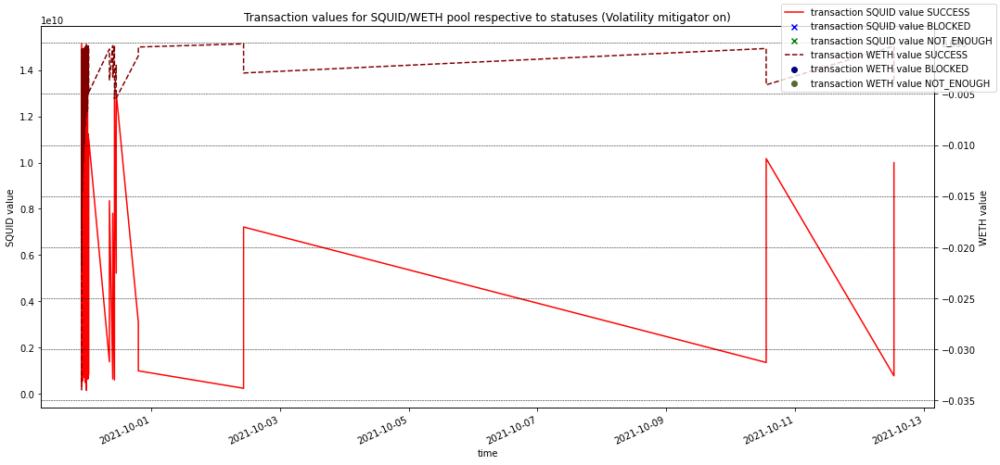

In [90]:
squid_weth_sim.plot_transactions_by_type(squid_weth_swaps_mitigation_on_df, 
                                         ignore_success=False, width=15, height=7)

### Plotting mitigation comparison, slice factor distribution, reserves distributions, cumulative prices distributions, transaction frequency distributions, price impact after each transaction distributions

Original SQUID/WETH pool has next statuses counts:
SUCCESS    176
Name: status, dtype: int64
Mitigated SQUID/WETH dataframe has next statuses counts:
SUCCESS    176
Name: status, dtype: int64
TWAP unavailability ratio for SQUID/WETH is 0.022727272727272728
Mitigated SQUID/WETH dataframe has next Mitigator statuses:
CHECKED                172
CANT_CONSULT_ORACLE      4
Name: mitigator_check_status, dtype: int64


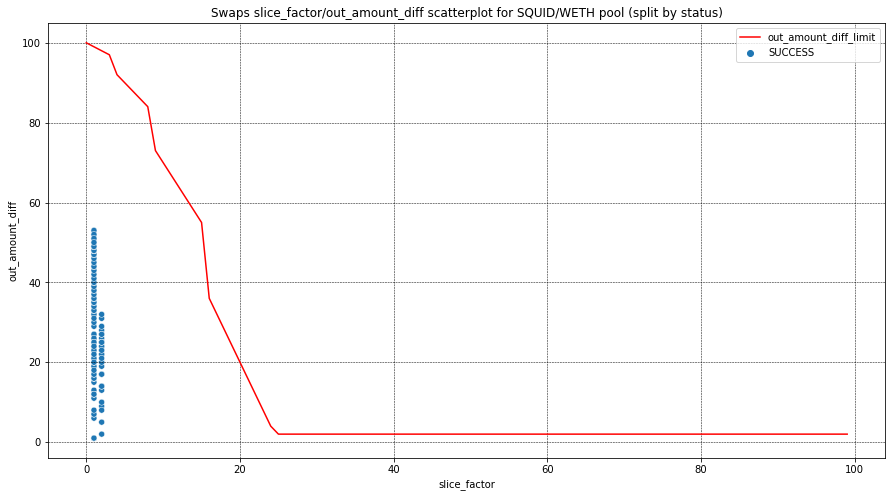

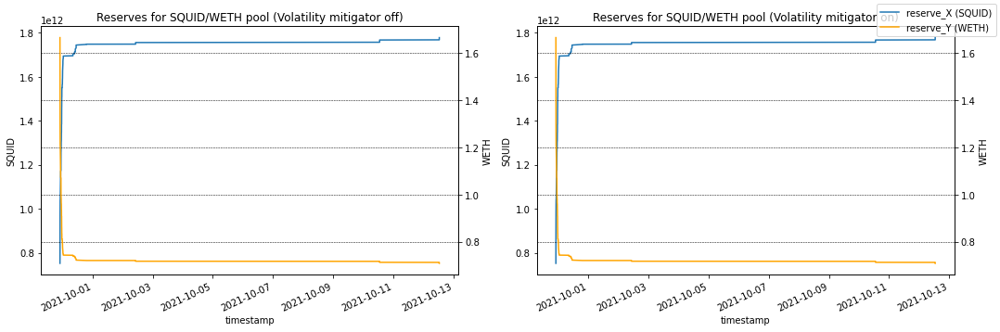

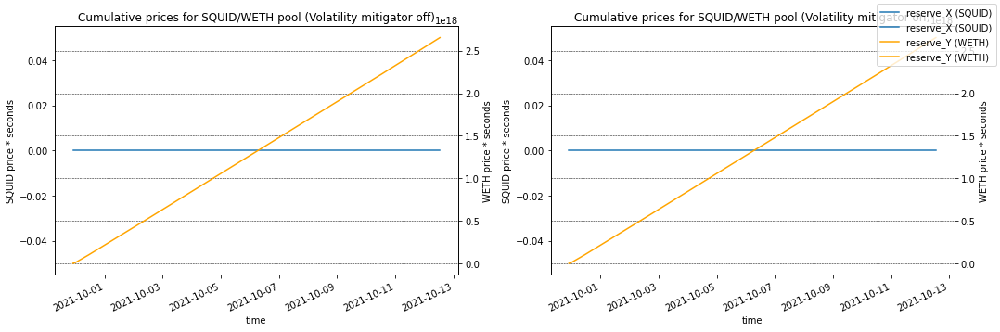

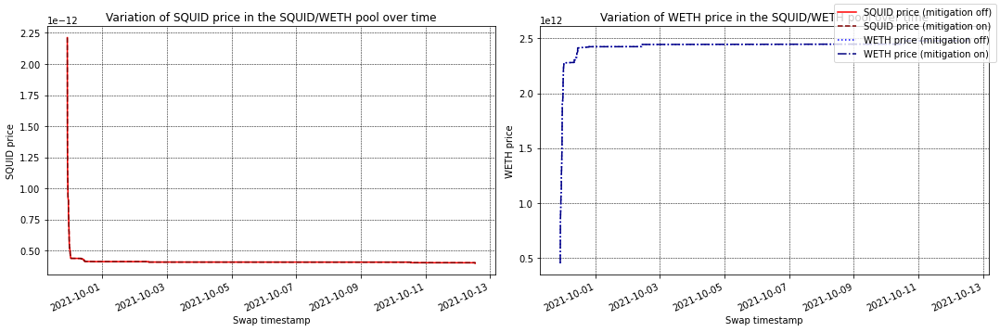

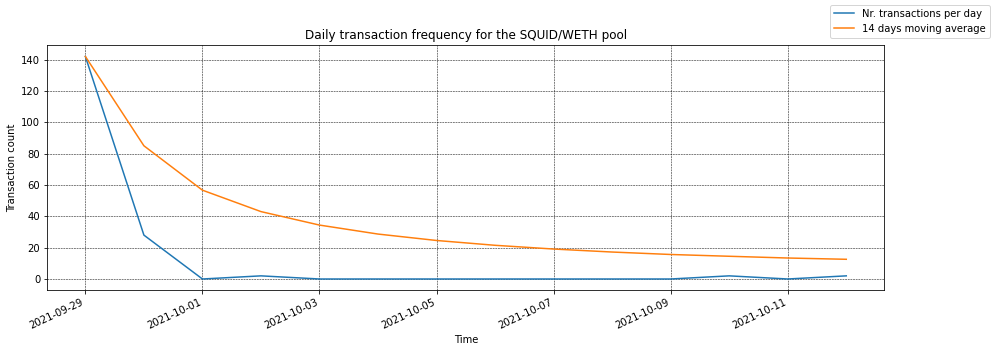

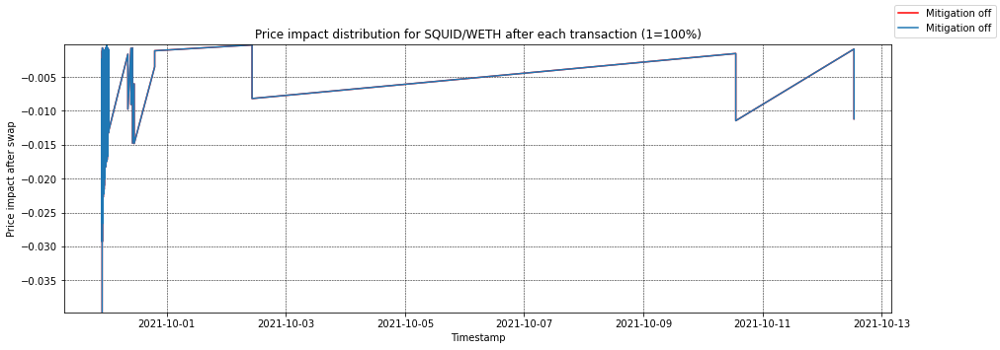

In [91]:
squid_weth_sim.show_mitigation_comparison(squid_weth_swaps_mitigation_off_df, 
                                          squid_weth_swaps_mitigation_on_df)
squid_weth_sim.px_hist_blocked_transactions_slice(squid_weth_swaps_mitigation_on_df)
squid_weth_sim.px_hist_blocked_transactions_difference_from_oracle(squid_weth_swaps_mitigation_on_df)
squid_weth_sim.plot_slice_distribution_and_diff_limit_line(squid_weth_swaps_mitigation_on_df)
squid_weth_sim.plot_reserves_with_and_without_mitigation(squid_weth_swaps_mitigation_off_df, 
                                                         squid_weth_swaps_mitigation_on_df)
squid_weth_sim.plot_cumulative_prices_with_and_without_mitigation(squid_weth_swaps_mitigation_off_df, 
                                                                  squid_weth_swaps_mitigation_off_df, 
                                                                  make_big_num_convert=True)
squid_weth_sim.plot_price_distribution(squid_weth_swaps_mitigation_off_df, 
                                       squid_weth_swaps_mitigation_on_df, 
                                       separate_plots=True)
squid_weth_sim.plot_frequency_distribution(squid_weth_swaps_mitigation_on_df)
squid_weth_sim.plot_price_impact(squid_weth_swaps_mitigation_off_df, 
                                 squid_weth_swaps_mitigation_on_df, 
                                 smallest_y=squid_weth_swaps_mitigation_off_df['price_diff'].min(), 
                                 biggest_y=squid_weth_swaps_mitigation_off_df['price_diff'].max())


# Collecting MEVS into list

In [92]:
mevs_transactions_list = [*doge_weth_mevs_df['txd'].unique(), *shib_weth_mevs_df['txd'].unique(),
                          *elon_weth_mevs_df['txd'].unique(), *squid_weth_mevs_df['txd'].unique()]

In [93]:
len(mevs_transactions_list)

24483

In [94]:
import pickle
with open('meme_pools_mevs', 'wb') as f: pickle.dump(mevs_transactions_list, f)

# Collecting possible MEVs into list

In [95]:
possible_mevs_transactions_list = [*doge_weth_possible_mevs_df['txd'].unique(), *shib_weth_possible_mevs_df['txd'].unique(),
                                    *elon_weth_possible_mevs_df['txd'].unique(), *squid_weth_possible_mevs_df['txd'].unique()]
print(len(possible_mevs_transactions_list))
with open('meme_pools_possible_mevs', 'wb') as f: pickle.dump(possible_mevs_transactions_list, f)

37259


# Making MEV profits

In [96]:
doge_weth_profits_df = doge_weth_mevs_df[['timestamp', 'sender', 'txd', 'block', 
                                          'block_position', 'bruto_total_profit', 
                                          'tx_fee', 'gas_costs_usd', 'netto_profit']]
shib_weth_profits_df = shib_weth_mevs_df[['timestamp', 'sender', 'txd', 'block', 
                                          'block_position', 'bruto_total_profit', 
                                          'tx_fee', 'gas_costs_usd', 'netto_profit']]
elon_weth_profits_df = elon_weth_mevs_df[['timestamp', 'sender', 'txd', 'block', 
                                          'block_position', 'bruto_total_profit', 
                                          'tx_fee', 'gas_costs_usd', 'netto_profit']]

meme_tokens_profits_list = [doge_weth_profits_df, shib_weth_profits_df, elon_weth_profits_df]
meme_tokens_profits_df = pd.concat(meme_tokens_profits_list)
meme_tokens_profits_df

,timestamp,sender,txd,block,block_position,bruto_total_profit,tx_fee,gas_costs_usd,netto_profit
0,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0x29f1198e83ea9535c39e3eb154e935842383d354ccf2...,11682958.0,187.0,39.670434,9.900000e-08,8.973224,30.697210
1,2021-01-19 02:15:14,0x72aa814b8125f94c0341812994e8574f6c395660,0xebf2cf1a00e3cce72bd4240382d5630e5fac0e208ec5...,11682958.0,153.0,39.670434,9.900000e-08,11.767322,27.903113
2,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,11742210.0,199.0,2.005216,6.200000e-08,7.416148,-5.410932
3,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,11742210.0,199.0,19.208072,6.200000e-08,7.416148,11.791924
4,2021-01-28 04:35:38,0xda6b746b76fdc8424764d6981e9ef5c3b13a56af,0xcd908a6c965d2dcfc4290dfb86dd66a287014c7f8dd2...,11742210.0,199.0,2.005216,6.200000e-08,7.416148,-5.410932
...,...,...,...,...,...,...,...,...,...
9891,2021-11-24 14:34:31,0x000000000035b5e5ad9019092c665357240f594e,0x2e7f0c4b904b1920a4f780596cd7c3f3051c53cd406d...,13677746.0,1.0,509.562034,1.172750e-07,65.556962,444.005072
9892,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0xb1025f1069c6af5a3618f762306980e56bd022d26aa7...,13678409.0,2.0,2207.766210,2.730906e-06,1310.448051,897.318159
9893,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0xcbbee073ba8ed5ef6ca640bceaf32558f95e5a6d7a44...,13678409.0,0.0,2207.766210,1.713629e-07,95.818518,2111.947692
9894,2021-11-25 03:43:03,0x00000000726422a6fecb4759b44d47e48cf746aa,0x3e58b06968559ee1f557f38a555d9b34d8d30dbbbe0c...,13681210.0,0.0,332.038368,1.092608e-07,43.269593,288.768775


In [97]:
meme_tokens_profits_df.sort_values(by=['timestamp'], inplace=True)
meme_tokens_profits_df = meme_tokens_profits_df.reset_index()
meme_tokens_profits_df.drop(columns=['index'])

,timestamp,sender,txd,block,block_position,bruto_total_profit,tx_fee,gas_costs_usd,netto_profit
0,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x28df6f5def17348bc2cc36306555a984cf6715d415c1...,10569628.0,82.0,27.283661,4.396628e-08,1.831757,25.451904
1,2020-07-31 20:48:42,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0xf73f2952f7bf8d6432d7094ee6ed8c437c51f722ad16...,10569628.0,93.0,27.283661,4.300000e-08,1.273713,26.009947
2,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x80e3107cd58ead5c1a12c5c7acfd09e2f45741a92f10...,10569638.0,135.0,26.132217,5.028014e-08,2.094810,24.037407
3,2020-07-31 20:50:43,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0x3241df0dabe154ca35445563c3a9acaf04a4dd3fce9e...,10569638.0,189.0,26.132217,5.000000e-08,1.481062,24.651155
4,2020-07-31 20:51:31,0x42d0ba0223700dea8bca7983cc4bf0e000dee772,0xa48fe932ec011c5b368417dc961c717d4bb7a8ad9be6...,10569642.0,152.0,216.273421,4.300000e-08,1.273713,214.999707
...,...,...,...,...,...,...,...,...,...
30562,2021-11-24 17:08:03,0x000000000035b5e5ad9019092c665357240f594e,0xcbbee073ba8ed5ef6ca640bceaf32558f95e5a6d7a44...,13678409.0,0.0,2207.766210,1.713629e-07,95.818518,2111.947692
30563,2021-11-25 00:02:01,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0x73d73a79abe7cd5862d5526515efea9594481a37bf37...,13680227.0,2.0,1667.870144,1.315153e-07,51.153434,1616.716710
30564,2021-11-25 00:02:01,0x1d6e8bac6ea3730825bde4b005ed7b2b39a2932d,0xd783928d2426bfda8d1cddff09239bf8c298b9bb11d2...,13680227.0,0.0,1667.870144,1.315153e-07,51.510810,1616.359335
30565,2021-11-25 03:43:03,0x00000000726422a6fecb4759b44d47e48cf746aa,0x3e58b06968559ee1f557f38a555d9b34d8d30dbbbe0c...,13681210.0,0.0,332.038368,1.092608e-07,43.269593,288.768775


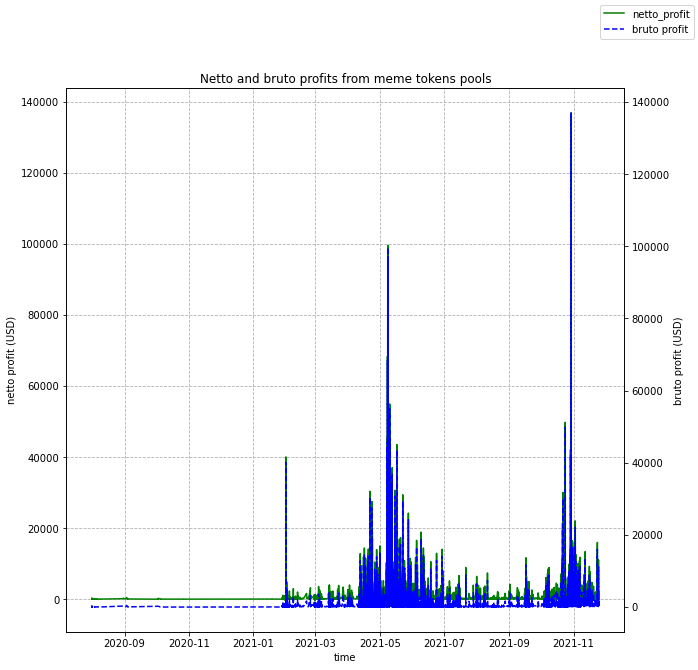

In [98]:
fig, ax = plt.subplots(figsize=(10, 10))
ax2 = ax.twinx()
ax.plot(meme_tokens_profits_df.timestamp,
        meme_tokens_profits_df.netto_profit, 
        label='netto_profit', color='g')
ax2.plot(meme_tokens_profits_df.timestamp, 
         meme_tokens_profits_df.bruto_total_profit, 
         color='b', linestyle='--', label='bruto profit')
ax.set_xlabel('time')
ax.set_ylabel('netto profit (USD)')
ax2.set_ylabel('bruto profit (USD)')
ax.grid(True, linestyle='--')
ax.set_title('Netto and bruto profits from meme tokens pools')
fig.legend()
plt.show()

In [99]:
meme_tokens_profits_df.to_csv('meme_pools_mev_profits_df.csv')

In [100]:
print(sum(meme_tokens_profits_df.netto_profit))

31899022.937363446
